# Gomb - Net
### Average positional errors for C atom locations on the Graphene dataset

Sumner B. Harris

4-13-25

[![OpenInColab](https://colab.research.google.com/assets/colab-badge.svg)](
    https://colab.research.google.com/github/ahoust17/Gomb-Net/blob/main/Eval_Graphene_model.ipynb)

In [1]:
# basics
import os
import sys
import numpy as np

# plotting
import matplotlib.pylab as plt
import matplotlib.colors as mcolors
from matplotlib.colors import Normalize
from matplotlib import cm

# colab interactive plots and drive
drive = False
if 'google.colab' in sys.modules:
    from  google.colab import drive
    from google.colab import output
    drive.mount('/content/drive')
    output.enable_custom_widget_manager()
    drive = True
else:
    %matplotlib widget

# other imports
from scipy.ndimage import label, center_of_mass, gaussian_filter, zoom, uniform_filter
from scipy.spatial import KDTree
from scipy.interpolate import griddata
from scipy.stats import norm, gaussian_kde
from skimage.filters import threshold_otsu
from skimage.feature import blob_log

# for cropping function
if drive:
    print('installing DataGenSTEM')
    !pip install ase
    !git clone https://github.com/ahoust17/DataGenSTEM.git
    sys.path.append('./DataGenSTEM/DataGenSTEM')
    !pip install dask
    import data_generator as dg

# for Gomb-Net
if drive:
    print('installing Gomb-Net')
    !git clone https://github.com/ahoust17/Gomb-Net.git
    sys.path.append('./Gomb-Net/')

sys.path.append('./Gomb-Net/')
from GombNet.networks import *
from GombNet.loss_func import GombinatorialLoss
from GombNet.utils import *

import torch
# Check if CUDA is available
if torch.cuda.is_available():
    device = torch.device("cuda")
    print("CUDA is available. Using GPU.")
else:
    device = torch.device("cpu")
    print("CUDA is not available. Using CPU.")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
installing DataGenSTEM
fatal: destination path 'DataGenSTEM' already exists and is not an empty directory.
installing Gomb-Net
fatal: destination path 'Gomb-Net' already exists and is not an empty directory.
CUDA is not available. Using CPU.


### Now, you need to add the following shared drive to your google drive:
*** WARNING: it is a big file.  Check before you download ***


https://drive.google.com/file/d/1DyKtrmJ8wNYQg3YEJ8_iXjz6lB_DQfwy/view?usp=sharing

### Run the following cell after the download is complete

In [2]:
# should be someting like 'content/drive/My Drive/Gomb-Net files'
if drive:
    shared_folder = 'drive/My Drive/Gomb-Net files'
else:
    shared_folder = '/Users/austin/Desktop/Gomb-Net aux files'

print('available files & directories:')
!ls '{shared_folder}'

available files & directories:
 Experimental_datasets	   Graphene_dataset    WSSe_dataset
'Gomb-Net aux files.zip'   Pretrained_models


### Now, on to running the code

let's look at the dataset:

In [3]:
# Create dataloaders
images_dir = str(shared_folder + '/Graphene_dataset/images')
labels_dir = str(shared_folder + '/Graphene_dataset/labels')
train_loader, val_loader, test_loader = get_dataloaders(images_dir, labels_dir, batch_size = 1, val_split=0.2, test_split=0.1, seed = 42)


Train size: 700, Validation size: 200, Test size: 100


now let's look at the model:

In [4]:
# Initialize model
input_channels = 1
num_classes = 2
num_filters = [32, 64, 128, 256]

model = TwoLeggedUnet(input_channels, num_classes, num_filters, dropout = 0.2)

model_path = str(shared_folder + '/Pretrained_models/Graphene_model.pth')

checkpoint = torch.load(model_path, map_location=device)
model.load_state_dict(checkpoint['model_state_dict'])
model.eval()

TwoLeggedUnet(
  (encoders): ModuleDict(
    (encoder_0): EncoderBlock(
      (conv_block): ConvBlock(
        (conv): Sequential(
          (0): Conv2d(1, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (2): ReLU(inplace=True)
          (3): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (4): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (5): ReLU(inplace=True)
        )
      )
      (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    )
    (encoder_1): EncoderBlock(
      (conv_block): ConvBlock(
        (conv): Sequential(
          (0): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (2): ReLU(inplace=True)
          (3): Conv2d(64, 64, kernel_

# Define some functions for blob detection to determine the center x,y positions of each blob (atom) in a binary masked image

In [5]:
import numpy as np
import matplotlib.pyplot as plt
from skimage.feature import blob_log
from skimage.draw import disk
from scipy.ndimage import center_of_mass

def filter_edge_blobs(blobs, image_shape, margin=10):
    """
    Remove blobs whose centers (or areas) are too close to the image edges.

    Parameters:
        blobs: An array of blobs with columns [y, x, sigma].
        image_shape: Tuple (height, width) of the image.
        margin: Minimum allowed distance from the border.

    Returns:
        Filtered blob array.
    """
    filtered_blobs = []
    h, w = image_shape
    for blob in blobs:
        y, x, sigma = blob
        if (margin <= y <= h - margin) and (margin <= x <= w - margin):
            filtered_blobs.append(blob)
    return np.array(filtered_blobs)

def get_coms(image, edge_margin=0):
  prediction_img = image
  # Detect blobs using blob_log
  blobs = blob_log(prediction_img, min_sigma=3, max_sigma=10, num_sigma=5, threshold=0.2)
  blobs = filter_edge_blobs(blobs, prediction_img.shape, margin=edge_margin)
  refined_coms = []
  for blob in blobs:
      y, x, sigma = blob
      # Define a radius; often a multiple of sigma works
      radius = int(sigma * np.sqrt(2))

      # Create a binary mask for the region around the blob.
      mask = np.zeros_like(prediction_img, dtype=bool)
      rr, cc = disk((int(y), int(x)), radius, shape=prediction_img.shape)
      mask[rr, cc] = True

      # Optionally, you might threshold the prediction inside the mask
      # to focus on the blob region (here, we simply use the mask as is).
      # Convert the mask to an integer label array.
      labels = mask.astype(int)

      # Compute the refined center of mass for this blob region.
      # We use '1' as the index because our binary mask assigns 1 to the region.
      refined_com = center_of_mass(prediction_img, labels=labels, index=1)
      refined_coms.append(refined_com)

  refined_coms = np.array(refined_coms)
  return refined_coms

# The cell below defines functions to create matched point pairs of atoms between the ground truth and predicted binary masks. This allows us to calculate the error between the ground truth x,y position and the predicted x,y position.

In [6]:
from scipy.spatial.distance import cdist

def find_point_pairs(arr1, arr2, threshold=100):
    """
    Given two arrays arr1 (shape: (n1, 3)) and arr2 (shape: (n2, 3)),
    extract the x, y coordinates, compute pairwise distances, and find matching
    point pairs that are within the threshold.

    Returns:
        point_pairs: numpy array of shape (m, 4) where each row is [x1, y1, x2, y2].
    """
    # Extract only the x, y coordinates (first two columns)
    coords1 = arr1[:, :2]
    coords2 = arr2[:, :2]

    # Compute the pairwise Euclidean distances between points in coords1 and coords2
    distances = cdist(coords1, coords2)

    # Find the indices of pairs where the distance is less than the threshold
    candidate_indices = np.where(distances < threshold)

    # Create a list of candidate pairs: (index_in_arr1, index_in_arr2, distance)
    candidate_pairs = [
        (i, j, distances[i, j])
        for i, j in zip(*candidate_indices)
    ]

    # Sort candidate pairs by distance (from smallest to largest)
    candidate_pairs.sort(key=lambda x: x[2])

    # Use a greedy matching approach to select unique pairs.
    matched_pairs = []
    used_indices_arr1 = set()
    used_indices_arr2 = set()

    for i, j, d in candidate_pairs:
        # If neither point has been used yet, accept the pair.
        if i not in used_indices_arr1 and j not in used_indices_arr2:
            matched_pairs.append([coords1[i, 0], coords1[i, 1], coords2[j, 0], coords2[j, 1]])
            used_indices_arr1.add(i)
            used_indices_arr2.add(j)

    # Convert list of pairs to a numpy array
    point_pairs = np.array(matched_pairs)

    return point_pairs

def compute_position_errors(point_pairs):
    """
    Given an array of point pairs with shape (n, 4) where:
      - Columns 0 and 1 are the real coordinates (x1, y1)
      - Columns 2 and 3 are the predicted coordinates (x2, y2)

    This function returns an array of position errors computed as the Euclidean distance
    between the real and predicted points for each row.
    """
    # Extract real and predicted coordinates
    real_coords = point_pairs[:, :2]
    pred_coords = point_pairs[:, 2:4]

    # Compute the Euclidean distance between the corresponding points along axis 1.
    errors = np.linalg.norm(pred_coords - real_coords, axis=1)
    return errors

def get_pixel_size(ground_truth_image):
  """
  Each image has a different magnification. Use the ground truth image to
  determine the pixel size conversion based on the known C-C bond distance.
  The ground truth contains positional variation on purpose from the frozen
  phonon approximation so the pixel size is calculated by the mean of the bond
  distance to the 3 nearest neighbors for all ground truth atoms.
  """

  tree = KDTree(ground_truth_image)
  distances, indices = tree.query(ground_truth_image, k=4)
  nn_distances = np.mean(distances[:, 1:-1],axis=1)
  #plt.hist(nn_distances)

  #graphene C-C bond distance is 1.42 angstroms
  pixel_conversion = 1.42/nn_distances.mean() # angstroms/pix
  return pixel_conversion.item()

def get_nn(ground_truth_image):
  # get nearest neighbors
  tree = KDTree(ground_truth_image)
  distances, indices = tree.query(ground_truth_image, k=4)
  nn_distances = np.mean(distances[:, 1:-1],axis=1)
  return nn_distances

# We need to compare the model predicted atomic positional error to the FWHM of the distribution of atomic positions in the ground truth image. Get the histgram of bond-lengths from the ground truth, fit a gaussian, get the FWHM.

In [8]:
from scipy.optimize import curve_fit

def gaussian(x, A, mu, sigma):
    return A * np.exp(- (x - mu)**2 / (2 * sigma**2))

def get_gt_positional_spread(nearest_neighbors):

  y,x = np.histogram(nearest_neighbors, bins=np.arange(1.1,1.8,0.01))
  bin_centers = (x[:-1] + x[1:]) / 2

  p0 = [y.max(), np.mean(nearest_neighbors), 0.1]

  # Fit the Gaussian function to the histogram data.
  params, cov = curve_fit(gaussian, bin_centers, y, p0=p0)
  A_fit, mu_fit, sigma_fit = params

  return 2*sigma_fit


# Calculate the prediction positional error for every atom in every image of the test set and report the mean position error on the test set.

The model naturally does not indicate which "leg" of the decoder corresponds to which layer, so parts of the code below are used to determine which predicted output corresponds to which ground truth layer. Then we calculate the mean of the mean position error for each layer an append a list. The final reported error is the mean of the mean positional errors in each layer for all test images.

0.2915802001953125
GT 2*sigma =  0.13794457523512332
Total positional error for Layer A with prediction[1]: 0.12173117292253903
Total positional error for Layer A with prediction[0]: 0.33702452976905556
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.12994012154214393
Average positional error for both layers: 0.12583564723234147


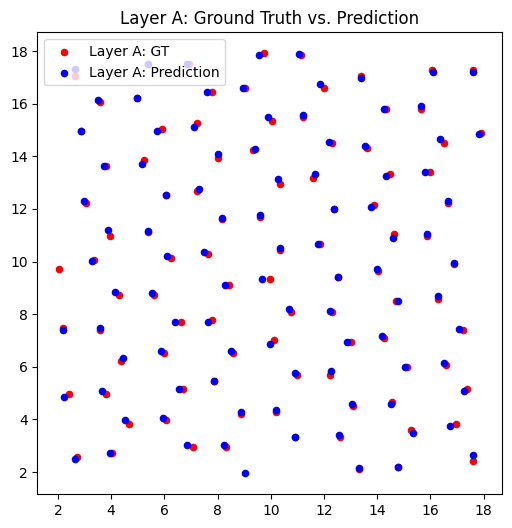

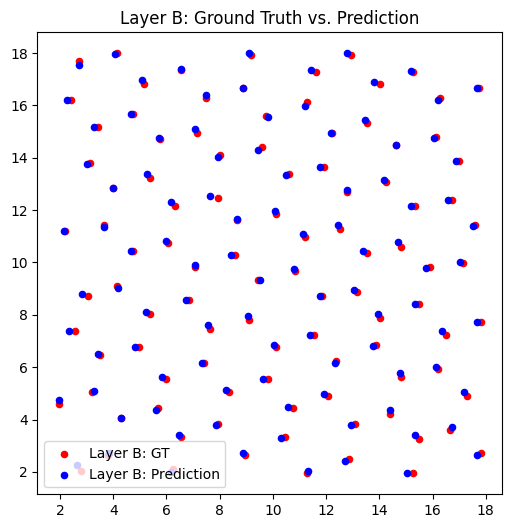

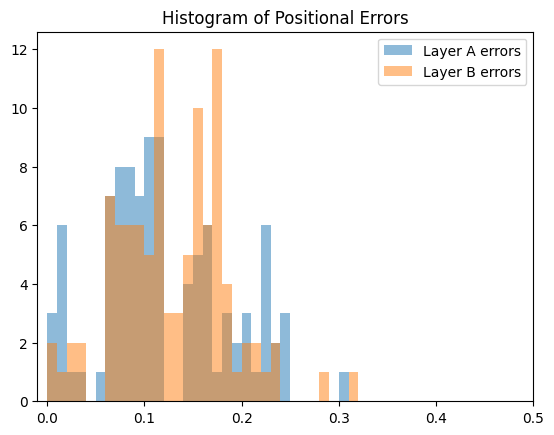

In [9]:
def calculate_positional_errors(gt,test):
  # Generate prediction
  with torch.no_grad():
      probability = model(test)
      prediction = F.sigmoid(probability)
  probability = probability.squeeze().cpu().numpy()
  prediction = prediction.squeeze().cpu().numpy()

  # Threshold the prediction image via Otsu's method, then binarize.
  threshold = threshold_otsu(prediction)
  prediction = (prediction > threshold).astype(float)
  loss_val = F.mse_loss(gt,torch.tensor(prediction)).item()
  print(loss_val)

  # Get center-of-mass for the ground truth (Layer A = gt[0], Layer B = gt[1]).
  gt_com_0 = get_coms(gt[0], edge_margin=25)
  gt_com_1 = get_coms(gt[1], edge_margin=25)

  # Use the ground truth centers to determine the pixel size conversion.
  pixel_conversion_0 = get_pixel_size(gt_com_0)
  pixel_conversion_1 = get_pixel_size(gt_com_1)
  pixel_conversion = (pixel_conversion_0 + pixel_conversion_1) / 2

  # Convert ground truth and prediction coordinates to real units.
  gt_com_0 = gt_com_0 * pixel_conversion
  gt_com_1 = gt_com_1 * pixel_conversion

  gt_0_nn = get_nn(gt_com_0)
  twosig_0 = get_gt_positional_spread(gt_0_nn)

  gt_1_nn = get_nn(gt_com_1)
  twosig_1 = get_gt_positional_spread(gt_1_nn)

  twosig = (twosig_0 + twosig_1)/2
  print('GT 2*sigma = ', twosig)

  ### Step 1: Determine which prediction channel corresponds to Layer A

  # Option A: Assume prediction channel 1 corresponds to Layer A.
  pred_com_0_A = get_coms(prediction[1],edge_margin=25) * pixel_conversion
  point_pairs_A = find_point_pairs(gt_com_0, pred_com_0_A, threshold=20)
  position_errors_A = compute_position_errors(point_pairs_A)
  total_error_A = np.mean(position_errors_A[position_errors_A<0.5])
  print("Total positional error for Layer A with prediction[1]:", total_error_A)

  # Option B: Assume prediction channel 0 corresponds to Layer A.
  pred_com_0_B = get_coms(prediction[0],edge_margin=25) * pixel_conversion
  point_pairs_B = find_point_pairs(gt_com_0, pred_com_0_B, threshold=20)
  position_errors_B = compute_position_errors(point_pairs_B)
  total_error_B = np.mean(position_errors_B[position_errors_B<0.5])
  print("Total positional error for Layer A with prediction[0]:", total_error_B)

  ### Step 2: Assign layers based on which configuration gives lower error for Layer A
  if total_error_A <= total_error_B:
      # Then prediction[1] is taken as Layer A, so prediction[0] must be Layer B.
      final_pred_com_A = pred_com_0_A
      final_point_pairs_A = point_pairs_A
      final_position_errors_A = position_errors_A
      final_total_error_A = total_error_A
      print("Layer A assigned from prediction[1].")

      # Now compute error for Layer B using prediction[0].
      pred_com_B = get_coms(prediction[0],edge_margin=25) * pixel_conversion
      point_pairs_B_layer = find_point_pairs(gt_com_1, pred_com_B, threshold=20)
      position_errors_B_layer = compute_position_errors(point_pairs_B_layer)
      total_error_B_layer = np.mean(position_errors_B_layer[position_errors_B_layer<0.5])
      print("Total positional error for Layer B (prediction[0]):", total_error_B_layer)
  else:
      # Otherwise, prediction[0] is taken as Layer A, so prediction[1] must be Layer B.
      final_pred_com_A = pred_com_0_B
      final_point_pairs_A = point_pairs_B
      final_position_errors_A = position_errors_B
      final_total_error_A = total_error_B
      print("Layer A assigned from prediction[0].")

      # Now compute error for Layer B using prediction[1].
      pred_com_B = get_coms(prediction[1],edge_margin=25) * pixel_conversion
      point_pairs_B_layer = find_point_pairs(gt_com_1, pred_com_B, threshold=20)
      position_errors_B_layer = compute_position_errors(point_pairs_B_layer)
      total_error_B_layer = np.mean(position_errors_B_layer[position_errors_B_layer<0.5])
      print("Total positional error for Layer B (prediction[1]):", total_error_B_layer)

  # Step 3: Compute the average positional error across both layers.
  average_error = (final_total_error_A + total_error_B_layer) / 2.0
  print("Average positional error for both layers:", average_error)

  ### Optional: Plotting the matches and error distributions.
  # Plot for Layer A
  import matplotlib.pyplot as plt
  plt.figure(figsize=(6,6))
  plt.scatter(final_point_pairs_A[:, 0], final_point_pairs_A[:, 1], c='r', s=20, label='Layer A: GT')
  plt.scatter(final_point_pairs_A[:, 2], final_point_pairs_A[:, 3], c='b', s=20, label='Layer A: Prediction')
  plt.legend()
  plt.title("Layer A: Ground Truth vs. Prediction")
  plt.show()

  # Plot for Layer B
  plt.figure(figsize=(6,6))
  plt.scatter(point_pairs_B_layer[:, 0], point_pairs_B_layer[:, 1], c='r', s=20, label='Layer B: GT')
  plt.scatter(point_pairs_B_layer[:, 2], point_pairs_B_layer[:, 3], c='b', s=20, label='Layer B: Prediction')
  plt.legend()
  plt.title("Layer B: Ground Truth vs. Prediction")
  plt.show()

  # Histogram of positional errors for both layers

  # Define fixed bin width and create bins
  bin_width = 0.01
  min_val = np.floor(final_position_errors_A.min())
  max_val = np.ceil(final_position_errors_A.max())
  bins = np.arange(min_val, max_val + bin_width, bin_width)

  plt.figure()
  plt.hist(final_position_errors_A, bins=bins, alpha=0.5, label='Layer A errors')

  min_val = np.floor(position_errors_B_layer.min())
  max_val = np.ceil(position_errors_B_layer.max())
  bins = np.arange(min_val, max_val + bin_width, bin_width)

  plt.hist(position_errors_B_layer, bins=bins, alpha=0.5, label='Layer B errors')
  plt.legend()
  plt.title("Histogram of Positional Errors")

  plt.xlim(-0.01,0.5)
  plt.show()

  return average_error, pixel_conversion, twosig, loss_val

# Get an example test image from your test loader.
test_iter = 50
test = test_loader.dataset[test_iter][0].unsqueeze(0)
gt = test_loader.dataset[test_iter][1]

average_error, pixel_conversion, twosig, loss_val = calculate_positional_errors(gt,test)

# Now do for all test images
Save positional errors, pixel sizes, ground truth 2*sigma guassian width and loss per image

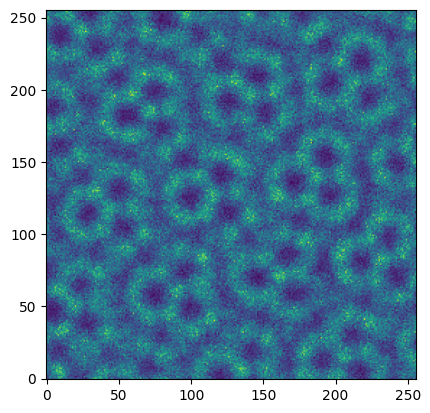

0.109222412109375
GT 2*sigma =  0.10147599962800424
Total positional error for Layer A with prediction[1]: 0.3313357315358867
Total positional error for Layer A with prediction[0]: 0.10365627144414562
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.10278353050773294
Average positional error for both layers: 0.10321990097593928


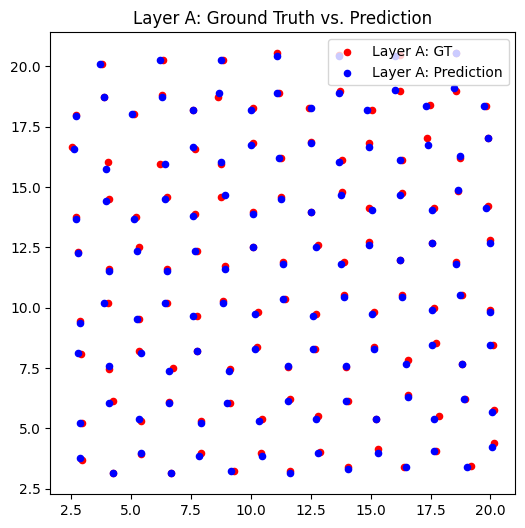

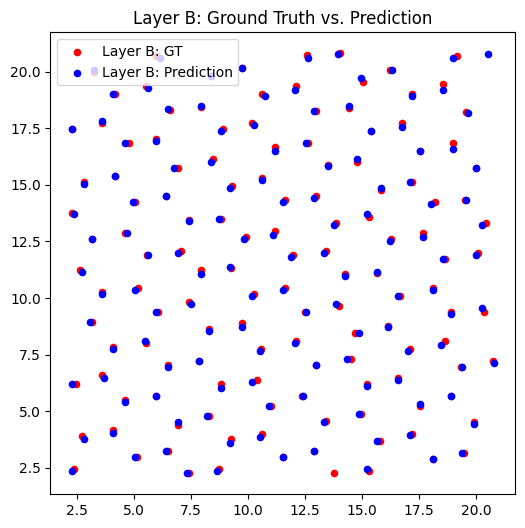

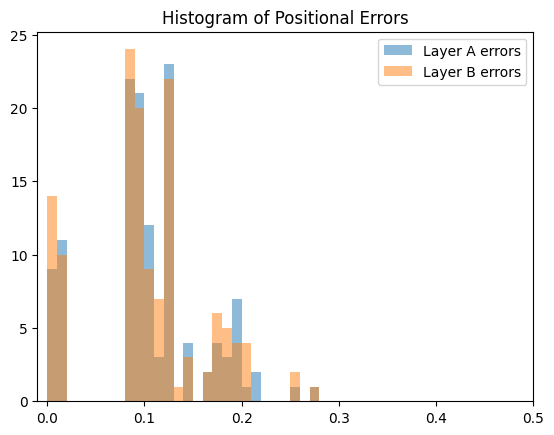

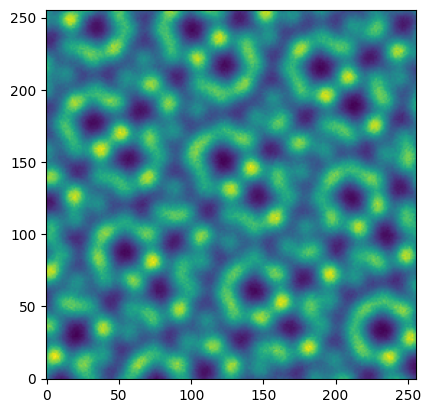

0.28863525390625
GT 2*sigma =  0.09021411579005234
Total positional error for Layer A with prediction[1]: 0.08678169219561117
Total positional error for Layer A with prediction[0]: 0.28653025953880007
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.08865226070511197
Average positional error for both layers: 0.08771697645036157


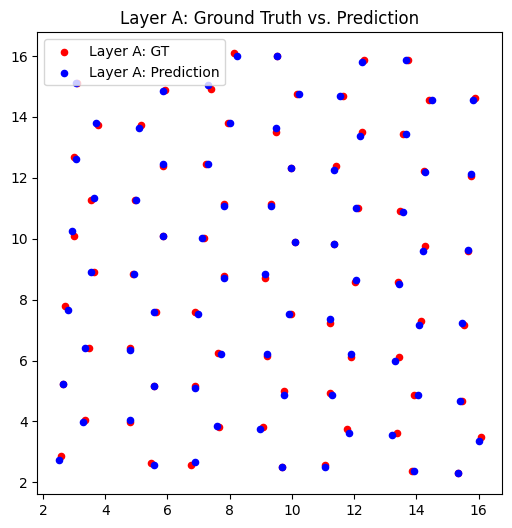

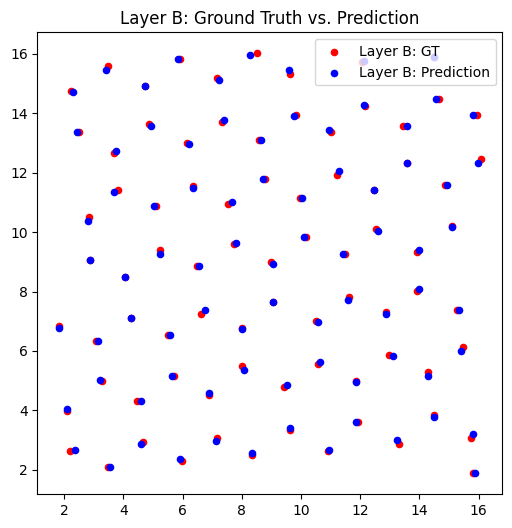

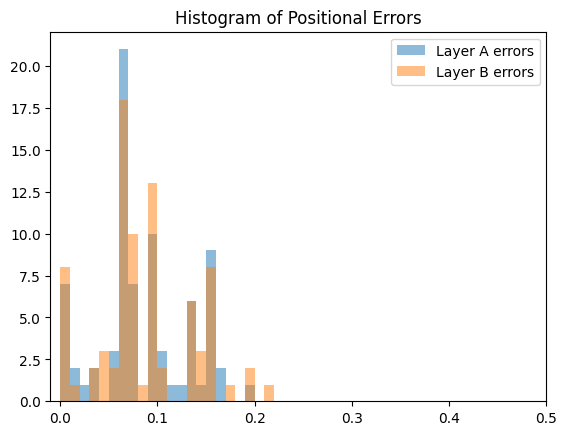

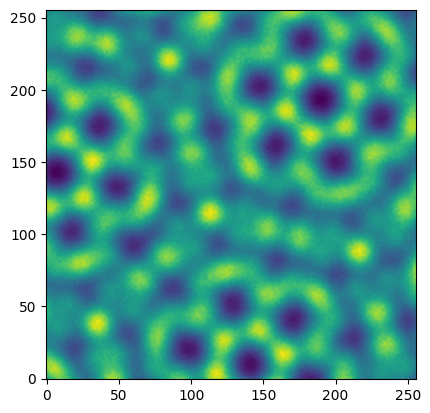

0.1470794677734375
GT 2*sigma =  0.07256047755750313
Total positional error for Layer A with prediction[1]: 0.25571421724142823
Total positional error for Layer A with prediction[0]: 0.16270412119064873
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.16117839772212406
Average positional error for both layers: 0.16194125945638638


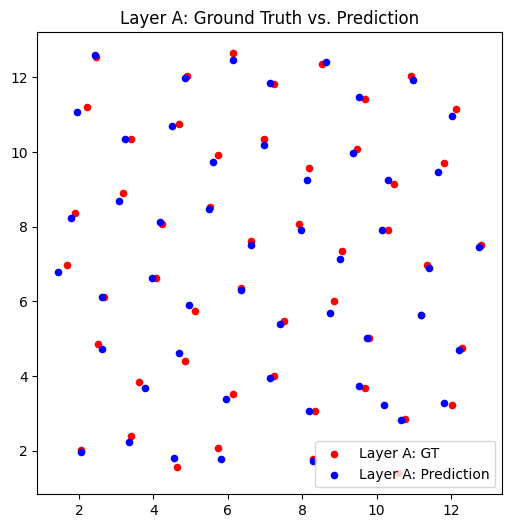

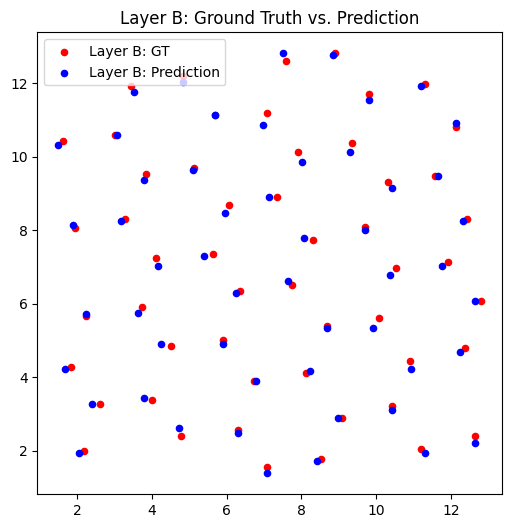

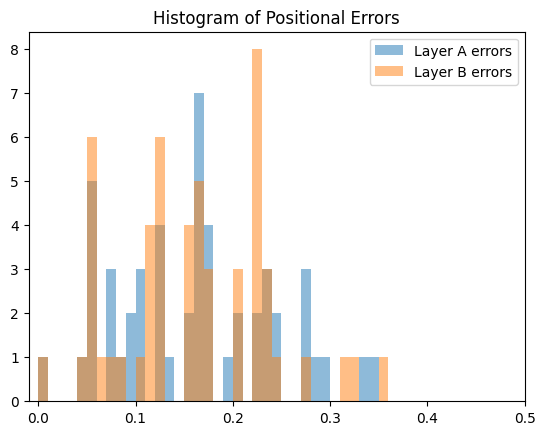

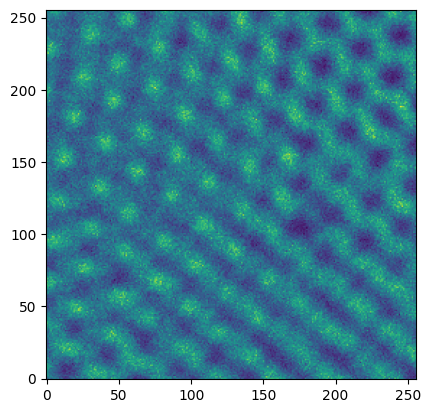

0.12249755859375
GT 2*sigma =  0.10429043504429006
Total positional error for Layer A with prediction[1]: 0.28646058367001054
Total positional error for Layer A with prediction[0]: 0.12454447930142645
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.11197332789551268
Average positional error for both layers: 0.11825890359846956


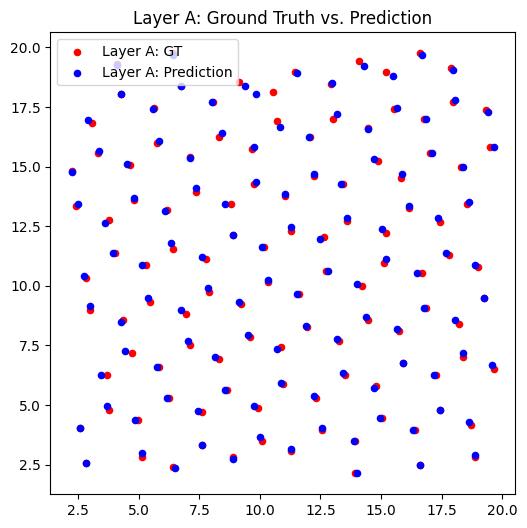

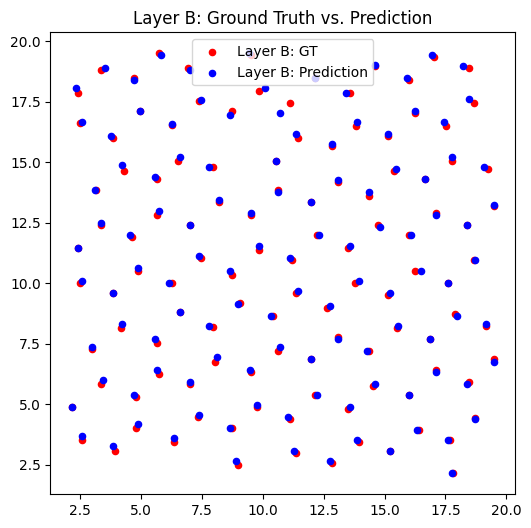

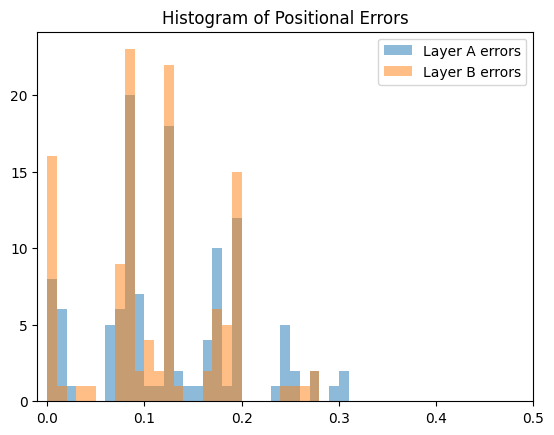

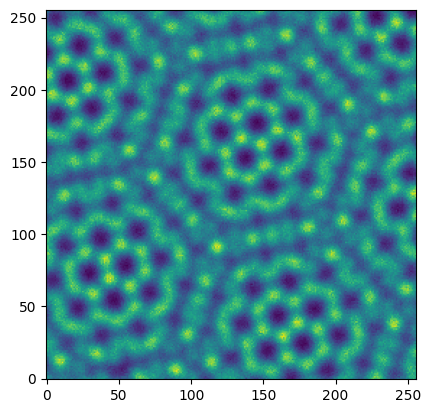

0.0966033935546875
GT 2*sigma =  0.0483978581440111
Total positional error for Layer A with prediction[1]: 0.3008007727624718
Total positional error for Layer A with prediction[0]: 0.07959899450814732
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.07195658655111031
Average positional error for both layers: 0.07577779052962882


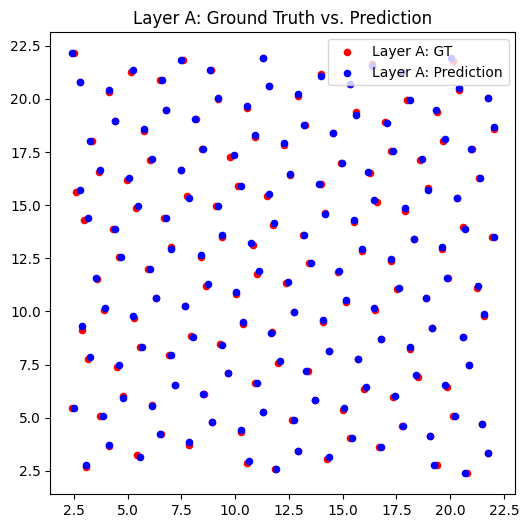

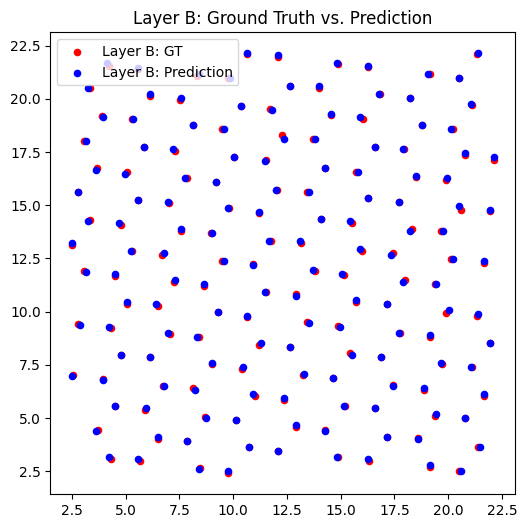

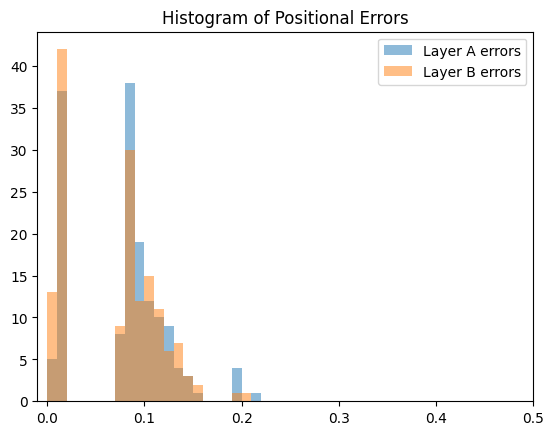

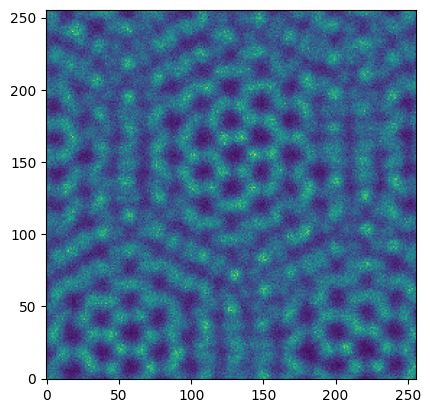

0.2488250732421875
GT 2*sigma =  0.15592933167455597
Total positional error for Layer A with prediction[1]: 0.16718865141671954
Total positional error for Layer A with prediction[0]: 0.2809142798982712
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.18213473233345873
Average positional error for both layers: 0.17466169187508912


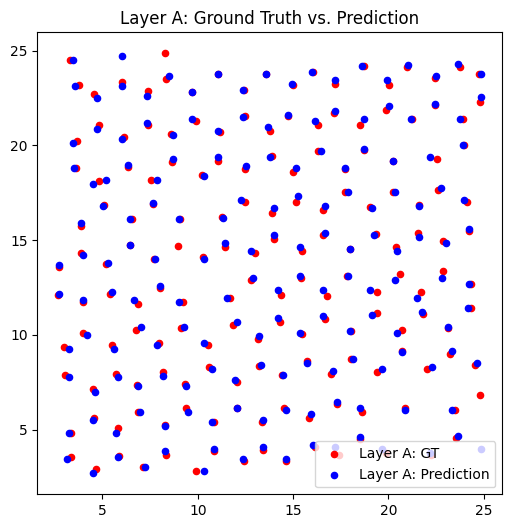

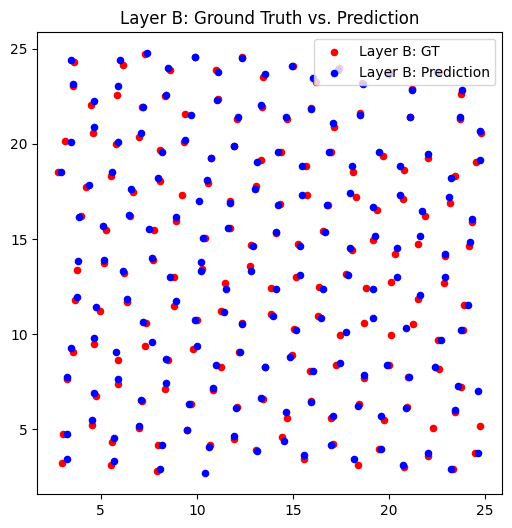

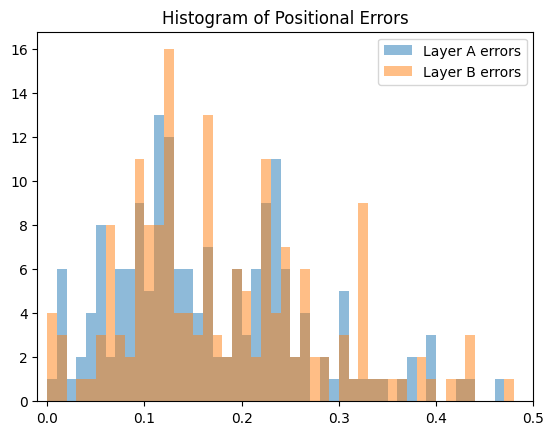

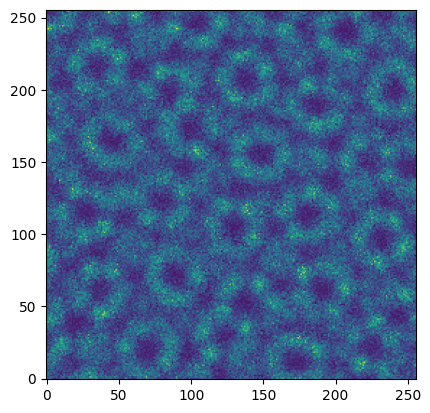

0.26609039306640625
GT 2*sigma =  0.11090091595514678
Total positional error for Layer A with prediction[1]: 0.12568201423471254
Total positional error for Layer A with prediction[0]: 0.3249184484255757
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.11760949964313949
Average positional error for both layers: 0.12164575693892601


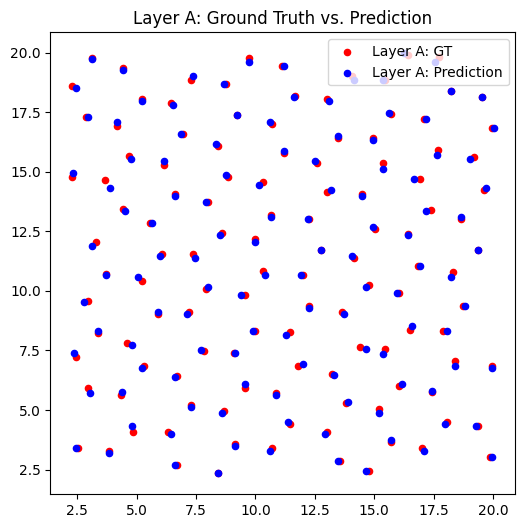

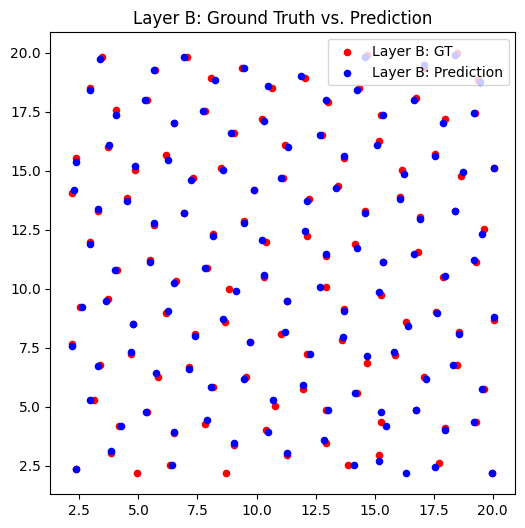

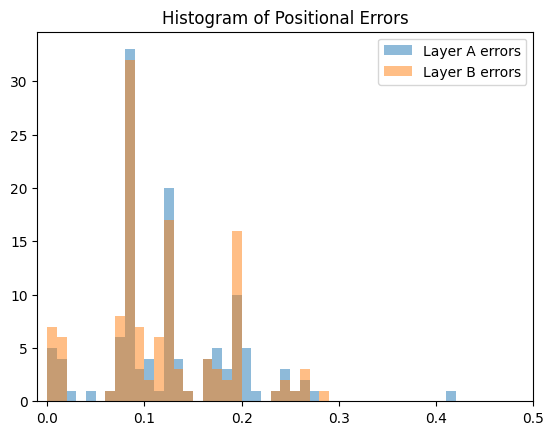

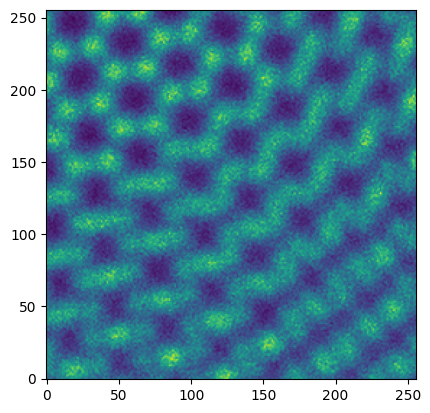

0.18410491943359375
GT 2*sigma =  0.06268769893725945
Total positional error for Layer A with prediction[1]: 0.18031810880114363
Total positional error for Layer A with prediction[0]: 0.21633363825408808
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.24718493301677988
Average positional error for both layers: 0.21375152090896177


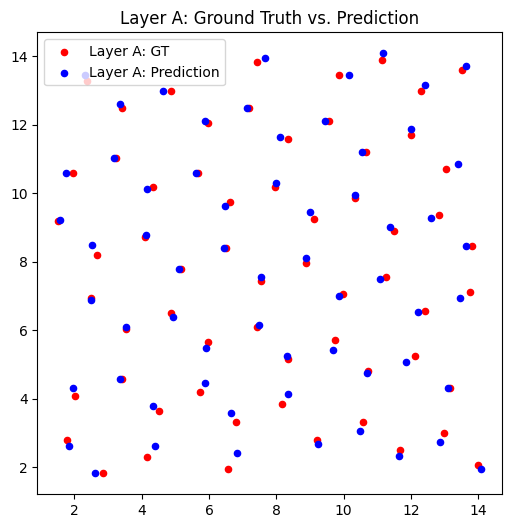

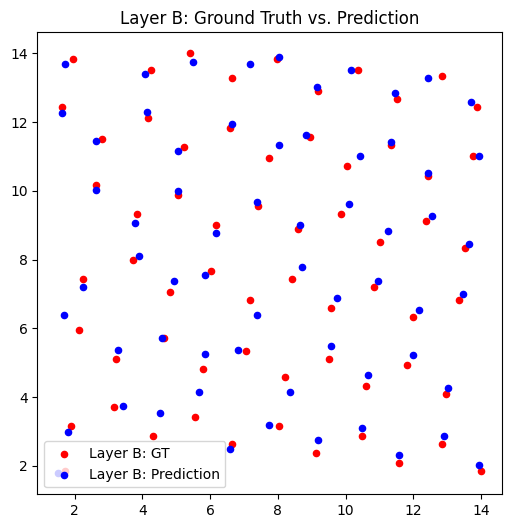

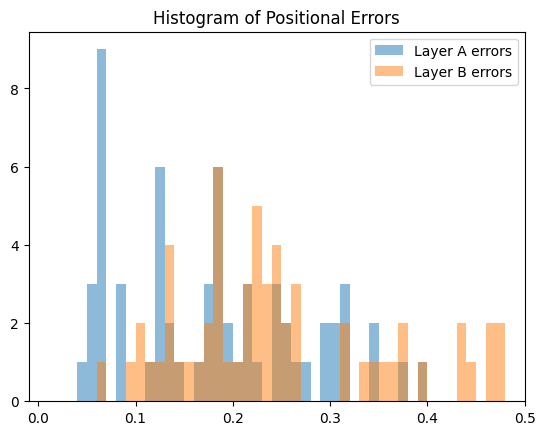

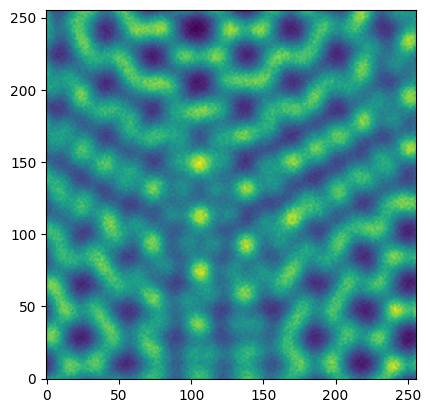

0.151397705078125
GT 2*sigma =  0.10146864062463153
Total positional error for Layer A with prediction[1]: 0.234633490279352
Total positional error for Layer A with prediction[0]: 0.17146594417159927
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.14425676418597708
Average positional error for both layers: 0.15786135417878816


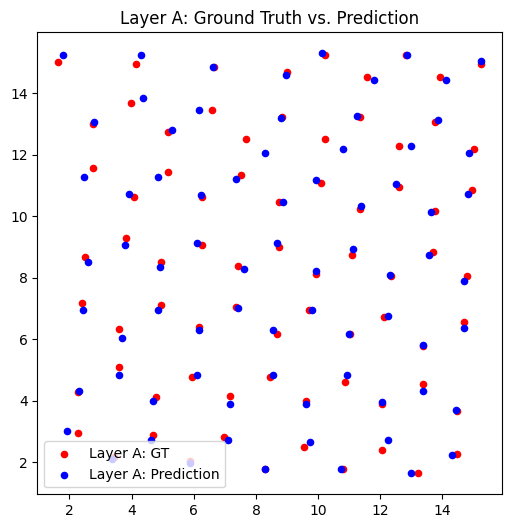

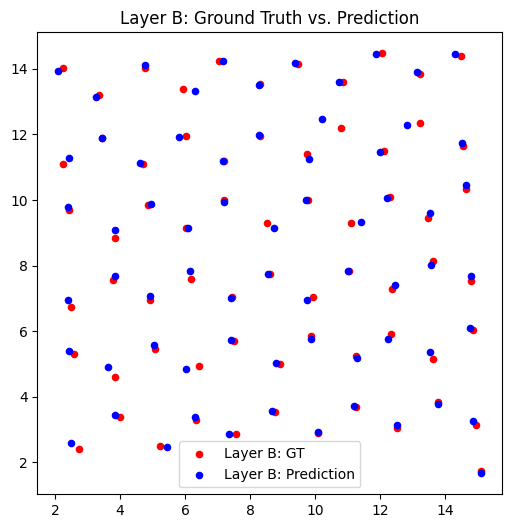

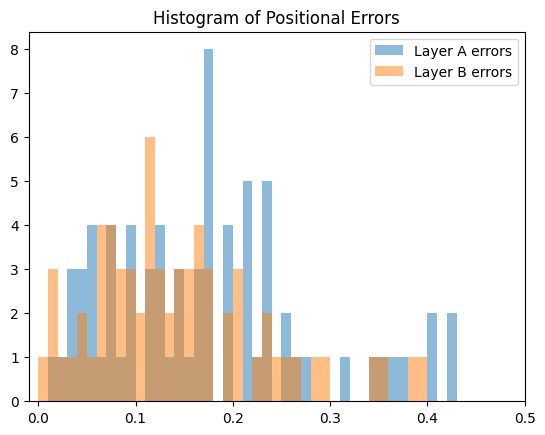

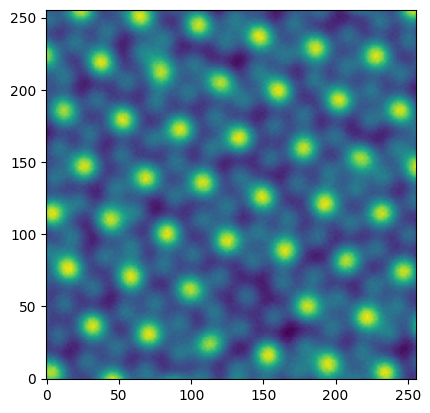

0.16831207275390625
GT 2*sigma =  0.12274926224486418
Total positional error for Layer A with prediction[1]: 0.16320167057151827
Total positional error for Layer A with prediction[0]: 0.1096194303196529
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.10760363233008188
Average positional error for both layers: 0.1086115313248674


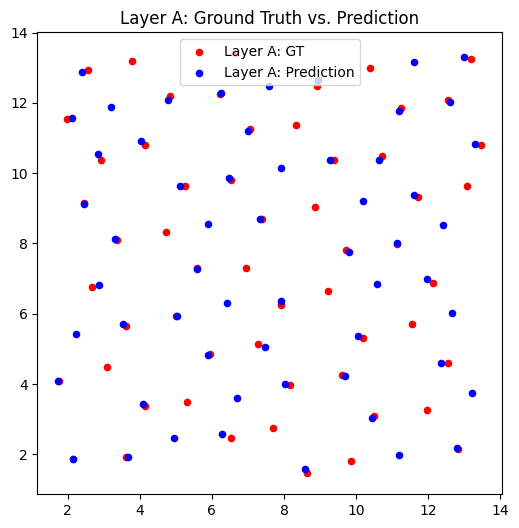

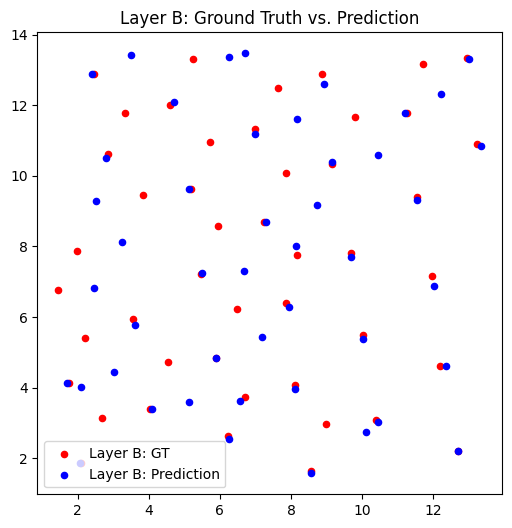

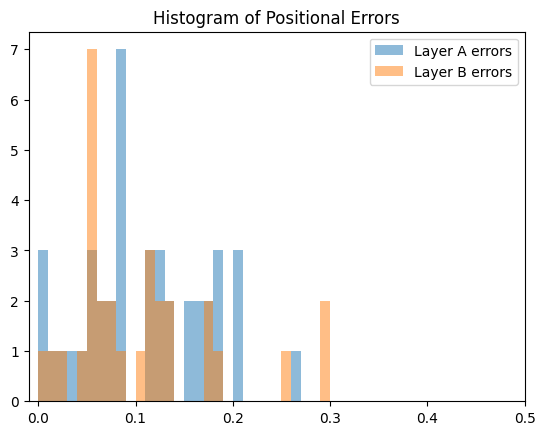

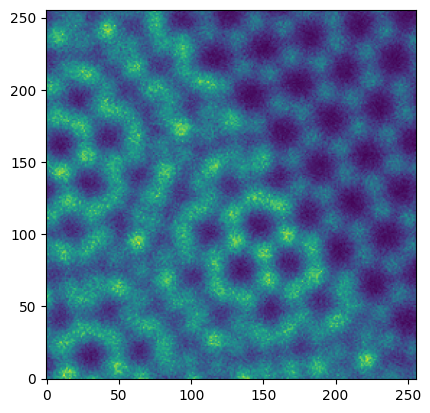

0.10479736328125
GT 2*sigma =  0.05357375068631859
Total positional error for Layer A with prediction[1]: 0.2096276774146447
Total positional error for Layer A with prediction[0]: 0.12522226733504016
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.12604474275653532
Average positional error for both layers: 0.12563350504578774


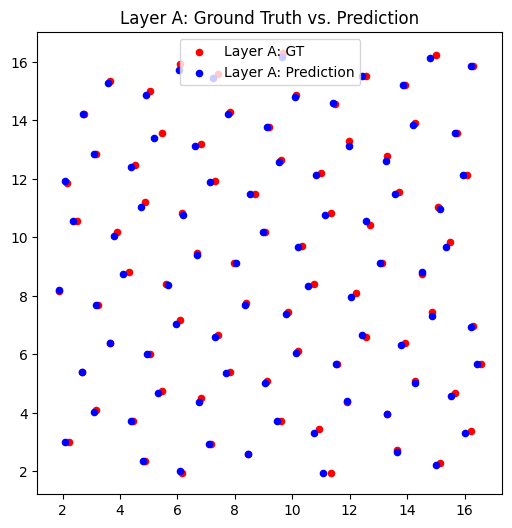

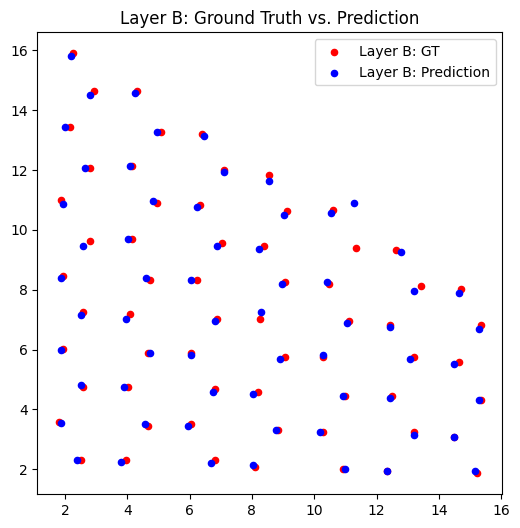

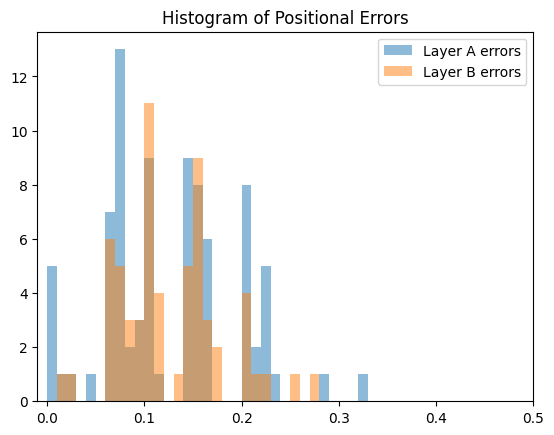

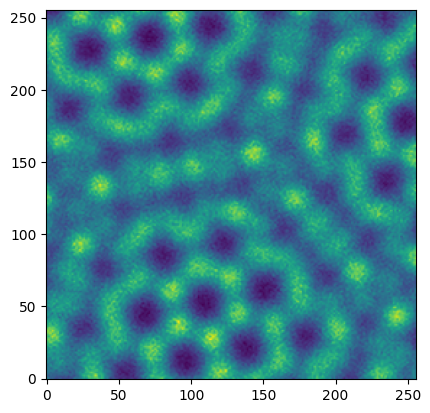

0.155364990234375
GT 2*sigma =  0.04617242281522918
Total positional error for Layer A with prediction[1]: 0.27749207973153234
Total positional error for Layer A with prediction[0]: 0.14684122730834487
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.17031946689033367
Average positional error for both layers: 0.15858034709933927


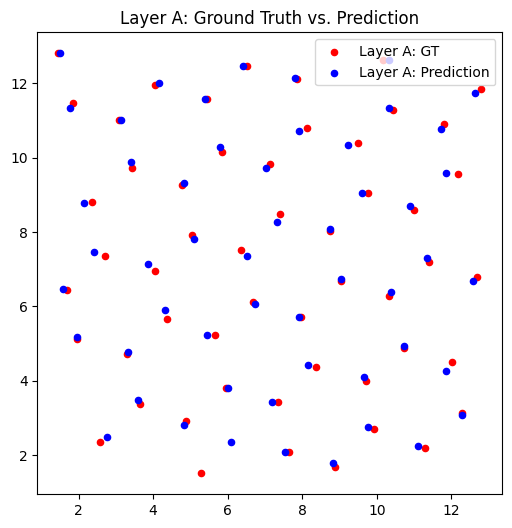

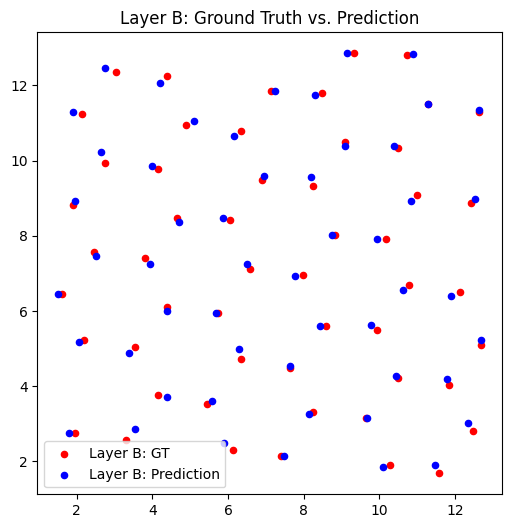

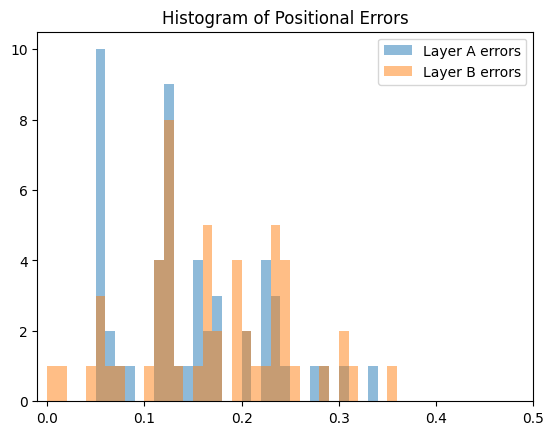

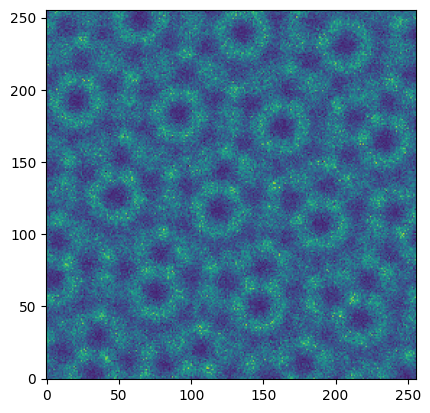

0.315185546875
GT 2*sigma =  0.04416089762116321
Total positional error for Layer A with prediction[1]: 0.09650314107788756
Total positional error for Layer A with prediction[0]: 0.2762430173781145
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.08885021054365322
Average positional error for both layers: 0.09267667581077038


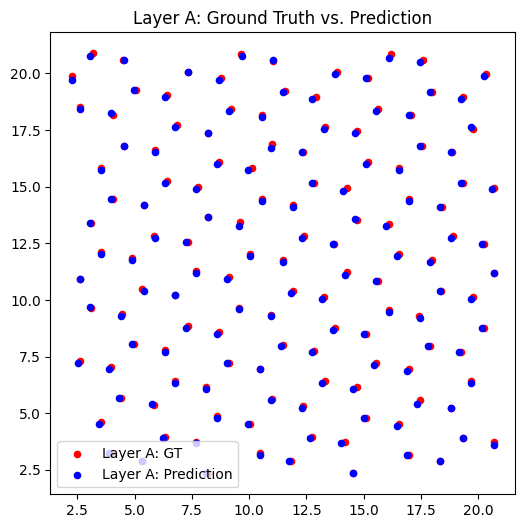

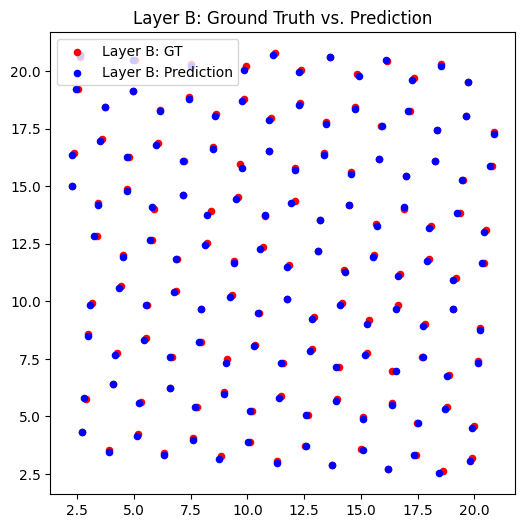

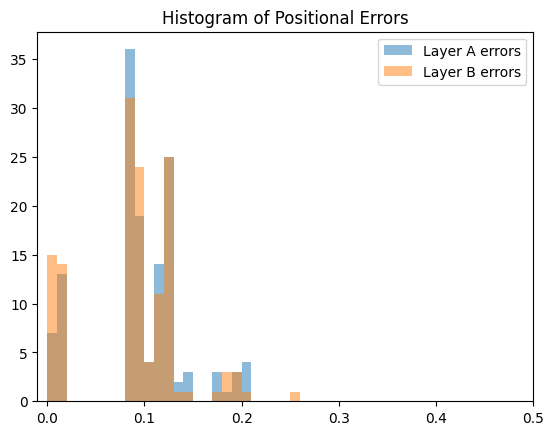

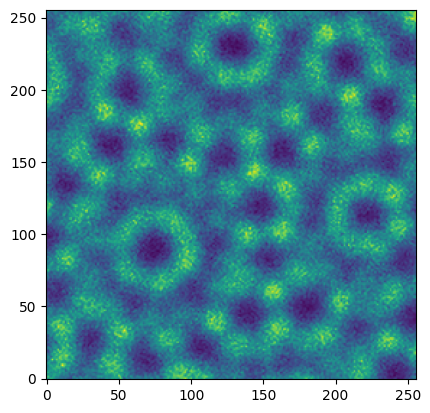

0.2356109619140625
GT 2*sigma =  0.09964040800878207
Total positional error for Layer A with prediction[1]: 0.15609878987412681
Total positional error for Layer A with prediction[0]: 0.21968333856947148
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.13964005745598615
Average positional error for both layers: 0.14786942366505648


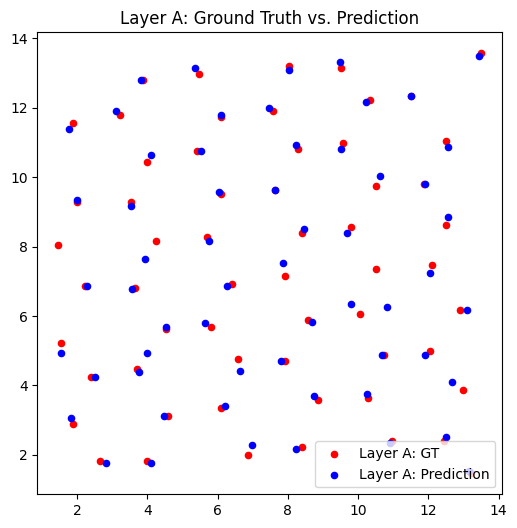

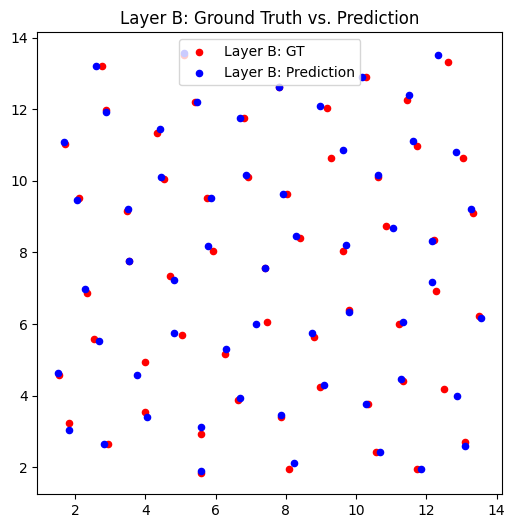

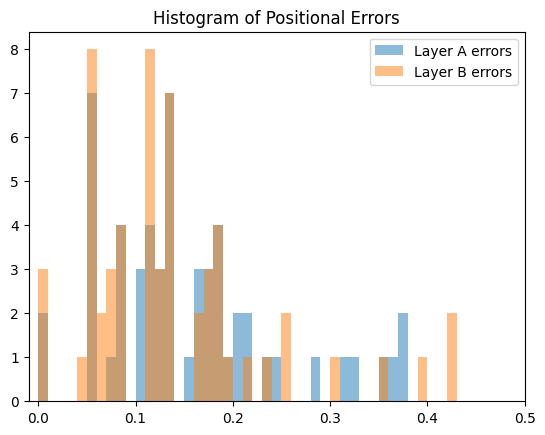

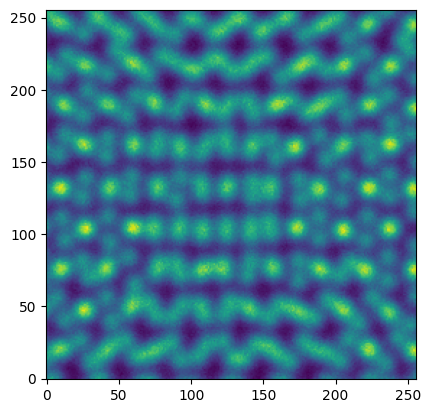

0.19527435302734375
GT 2*sigma =  0.14820963419641053
Total positional error for Layer A with prediction[1]: 0.17708473947306066
Total positional error for Layer A with prediction[0]: 0.19739575456815403
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.1342378358742151
Average positional error for both layers: 0.15566128767363788


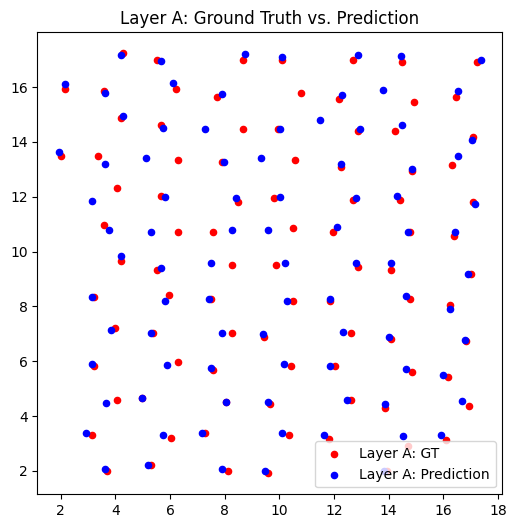

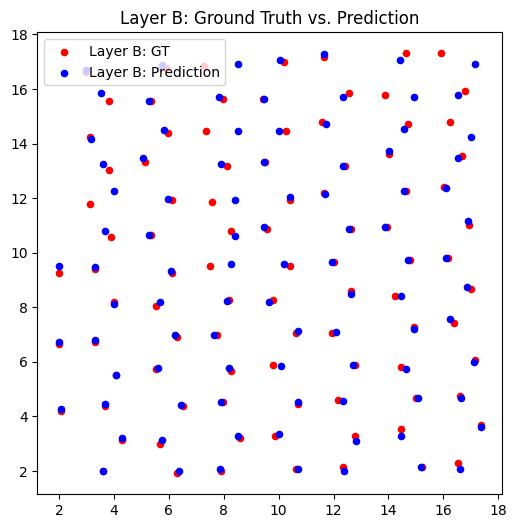

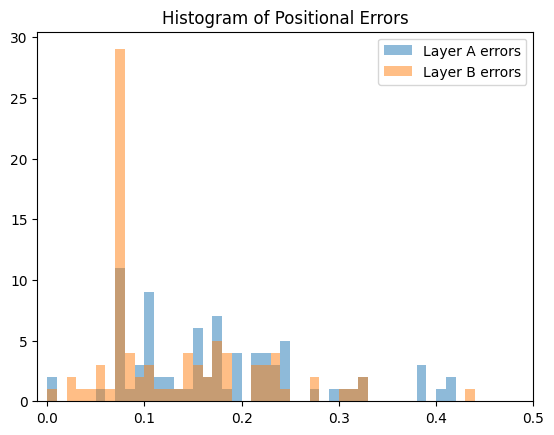

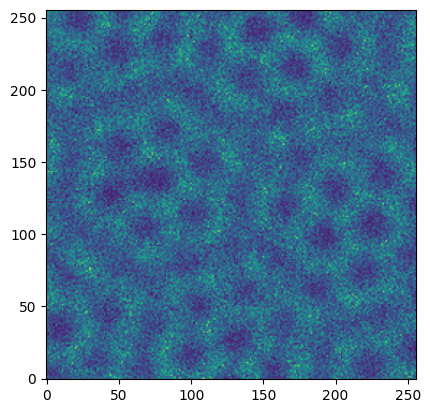

0.29134368896484375
GT 2*sigma =  0.10781641120826171
Total positional error for Layer A with prediction[1]: 0.1471341508460418
Total positional error for Layer A with prediction[0]: 0.3153622436362962
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.13791493265923224
Average positional error for both layers: 0.142524541752637


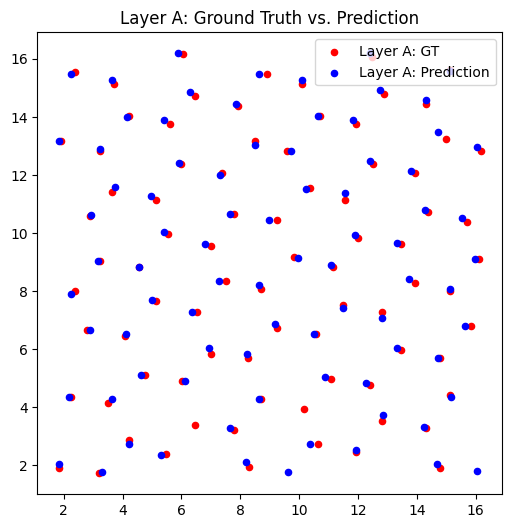

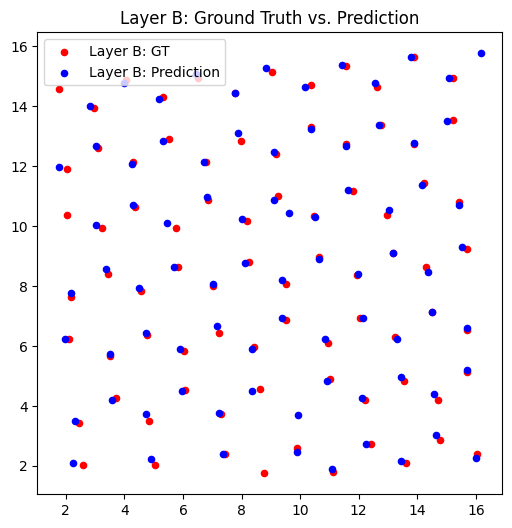

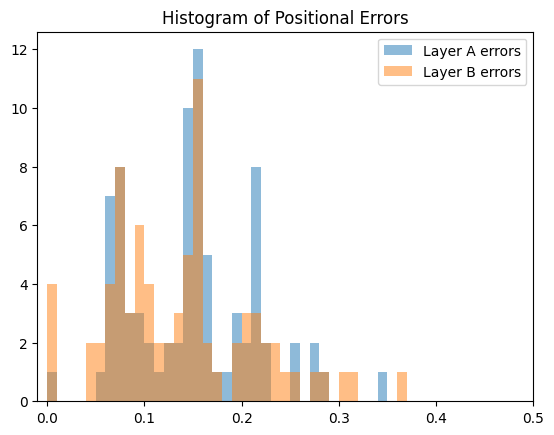

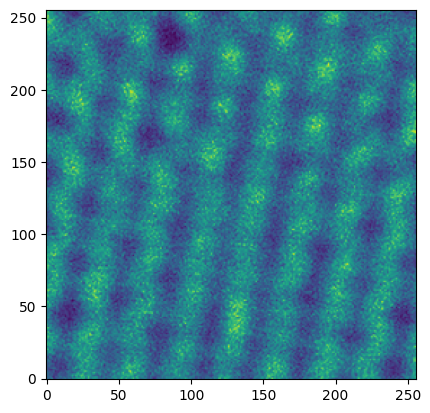

0.19556427001953125
GT 2*sigma =  0.09638326109173731
Total positional error for Layer A with prediction[1]: 0.19877435407154137
Total positional error for Layer A with prediction[0]: 0.21041240884260284
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.1924066126003413
Average positional error for both layers: 0.19559048333594134


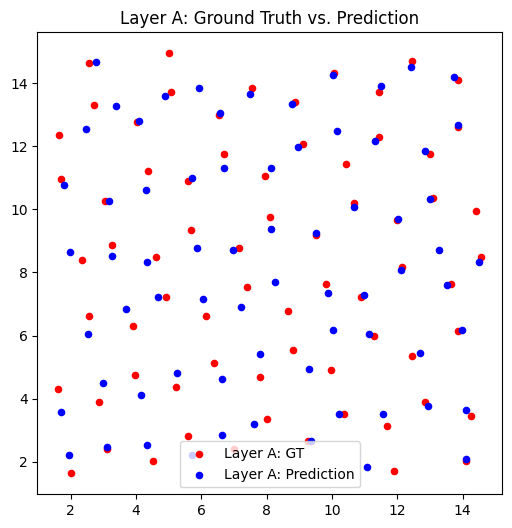

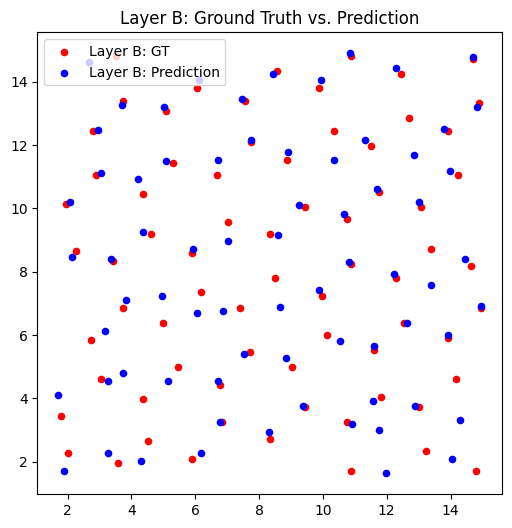

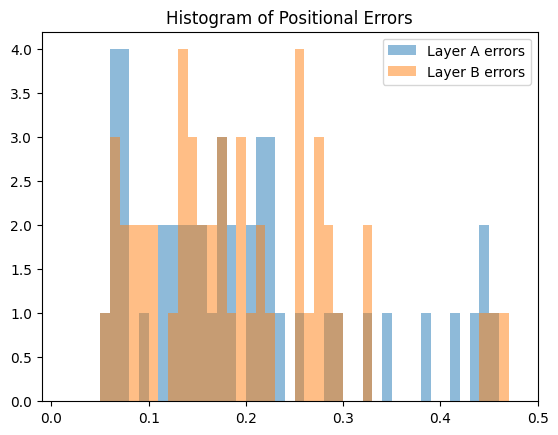

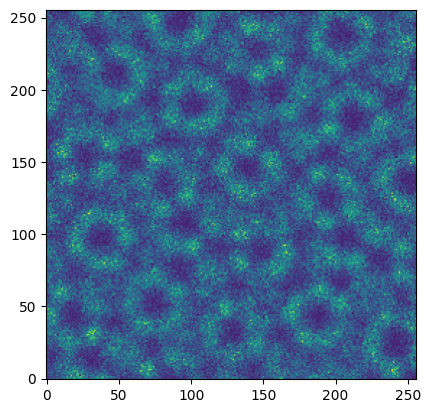

0.27112579345703125
GT 2*sigma =  0.16061846816151176
Total positional error for Layer A with prediction[1]: 0.11933635465811064
Total positional error for Layer A with prediction[0]: 0.2849052939741047
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.12129869130151294
Average positional error for both layers: 0.1203175229798118


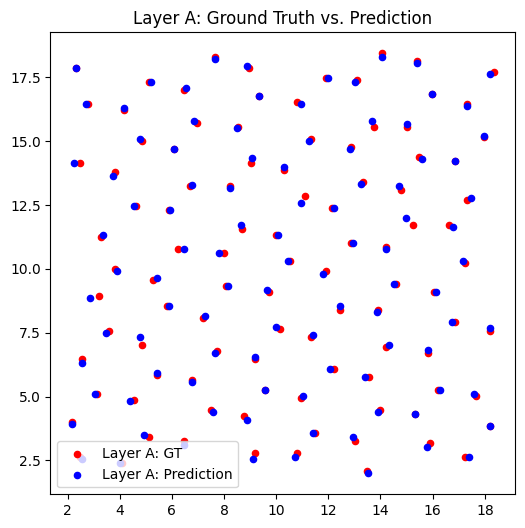

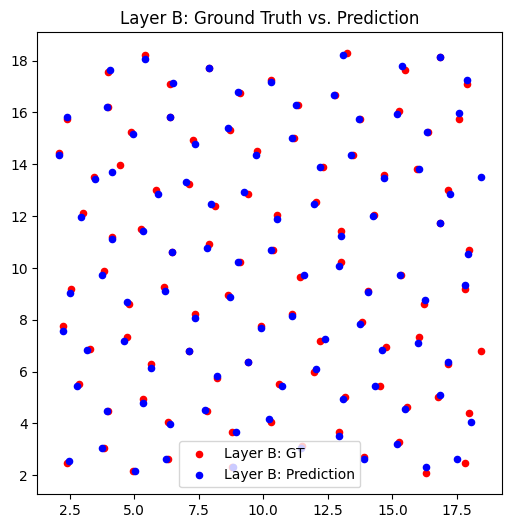

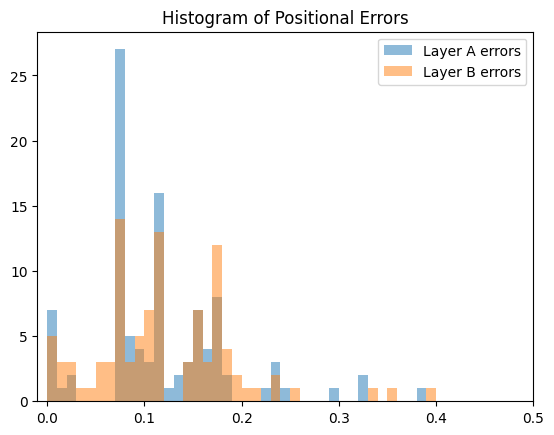

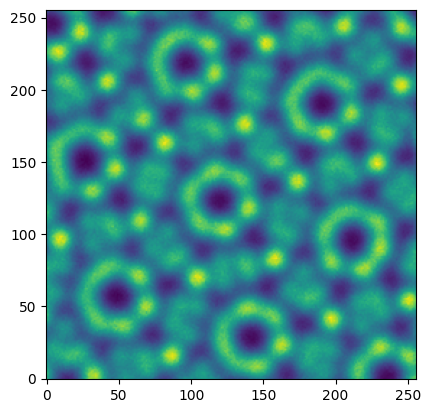

0.29090118408203125
GT 2*sigma =  0.08468853803475686
Total positional error for Layer A with prediction[1]: 0.08598958803063537
Total positional error for Layer A with prediction[0]: 0.27723398393800575
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.09266554603670524
Average positional error for both layers: 0.08932756703367031


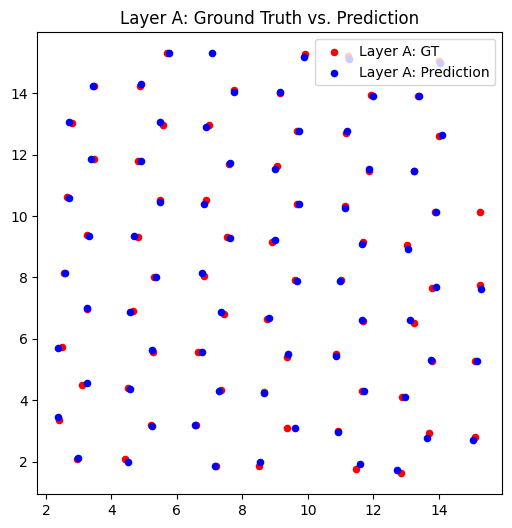

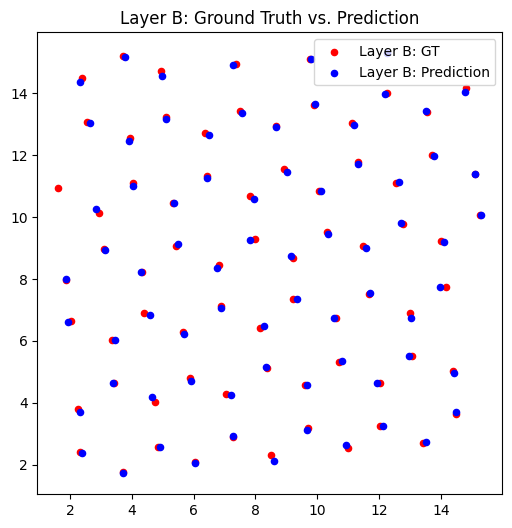

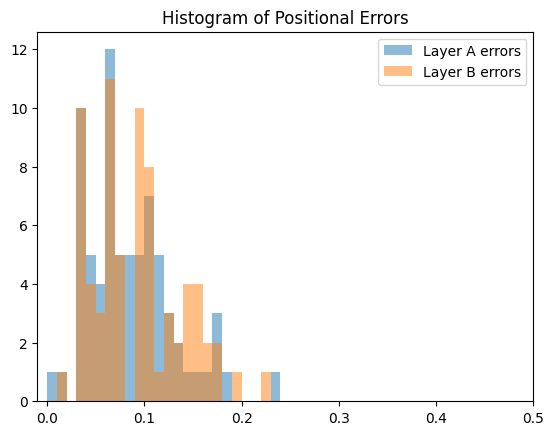

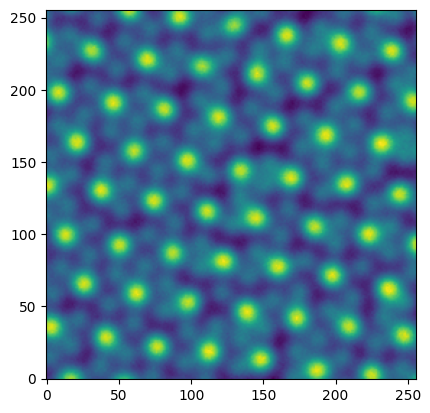

0.18662261962890625
GT 2*sigma =  0.12586300036910497
Total positional error for Layer A with prediction[1]: 0.10482137343091445
Total positional error for Layer A with prediction[0]: 0.10637553776716435
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.07288658726359139
Average positional error for both layers: 0.08885398034725292


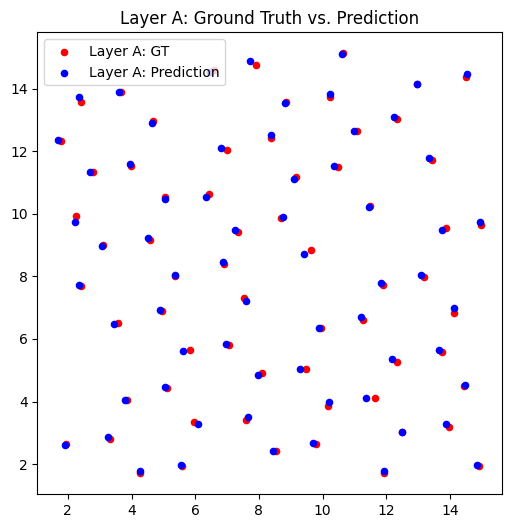

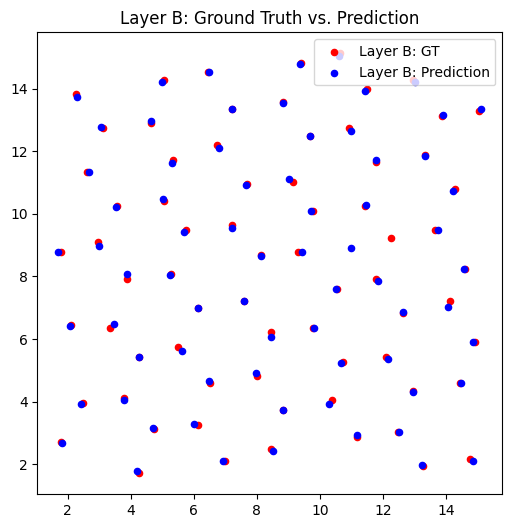

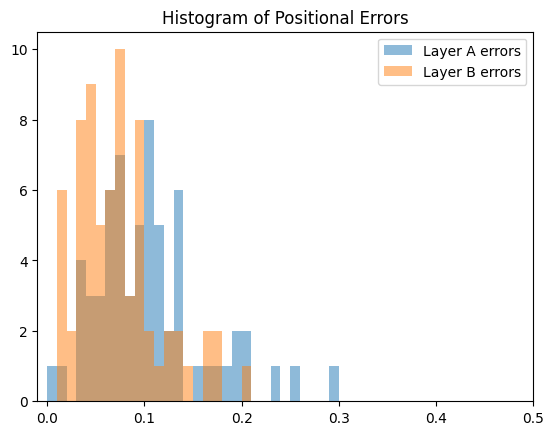

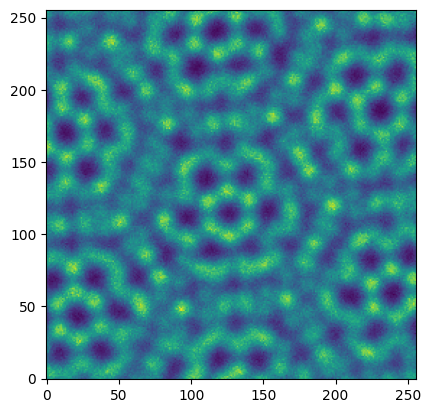

0.1254425048828125
GT 2*sigma =  0.11168913379664731
Total positional error for Layer A with prediction[1]: 0.2634460445543925
Total positional error for Layer A with prediction[0]: 0.1428126925042021
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.13479663427050456
Average positional error for both layers: 0.1388046633873533


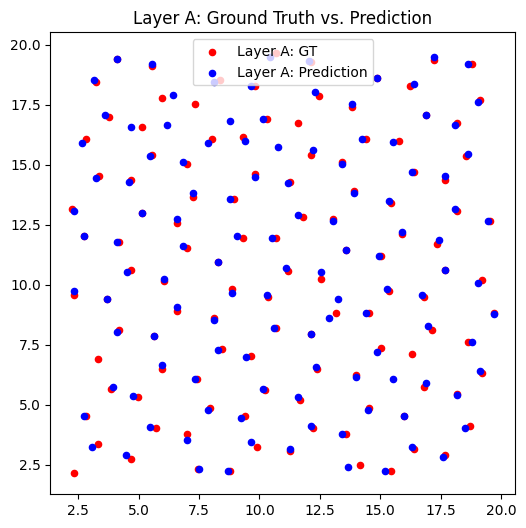

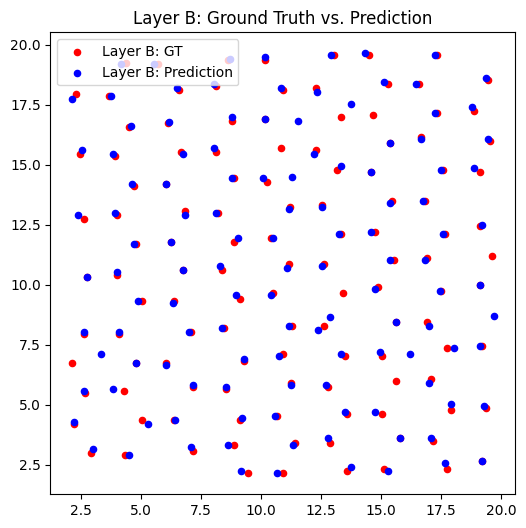

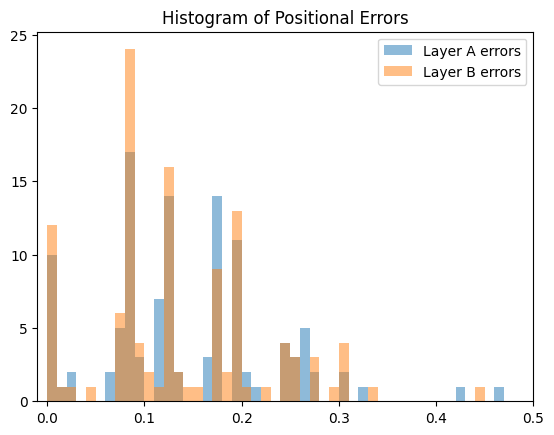

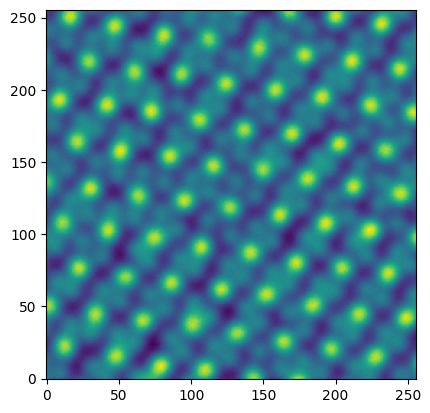

0.22853851318359375
GT 2*sigma =  0.09227686268589569
Total positional error for Layer A with prediction[1]: 0.09603426553011454
Total positional error for Layer A with prediction[0]: 0.15525086835805654
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.11407586262862754
Average positional error for both layers: 0.10505506407937104


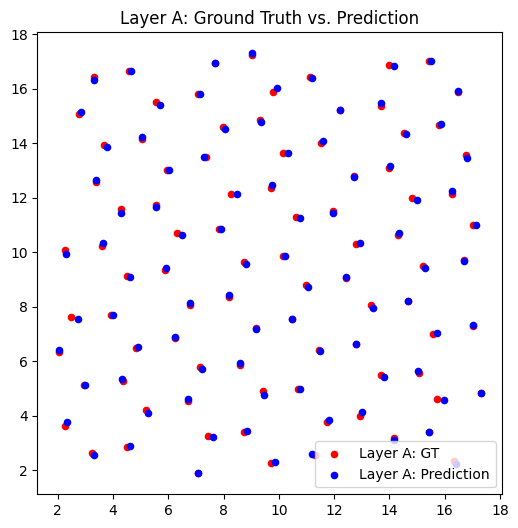

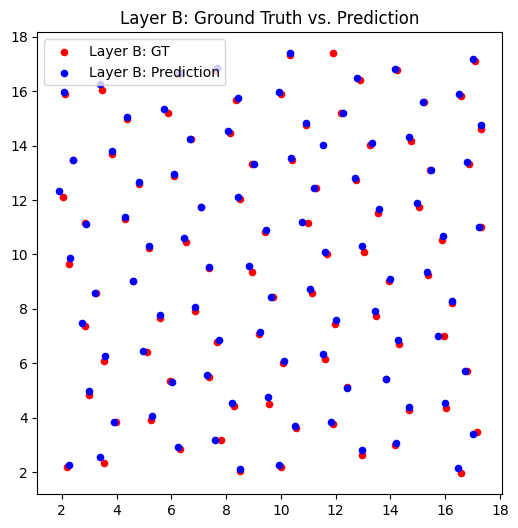

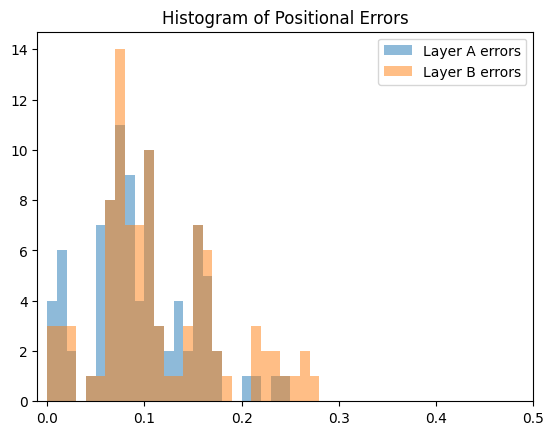

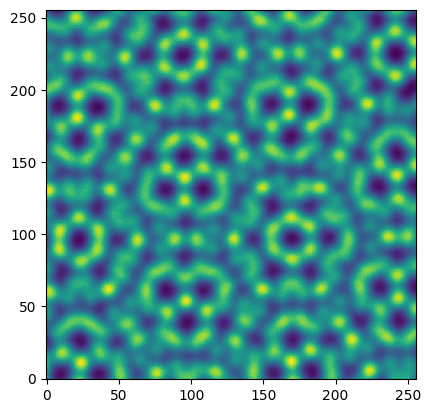

0.29810333251953125
GT 2*sigma =  0.06766667051332405
Total positional error for Layer A with prediction[1]: 0.10296402429326017
Total positional error for Layer A with prediction[0]: 0.30670608909971714
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.09718879931135344
Average positional error for both layers: 0.10007641180230681


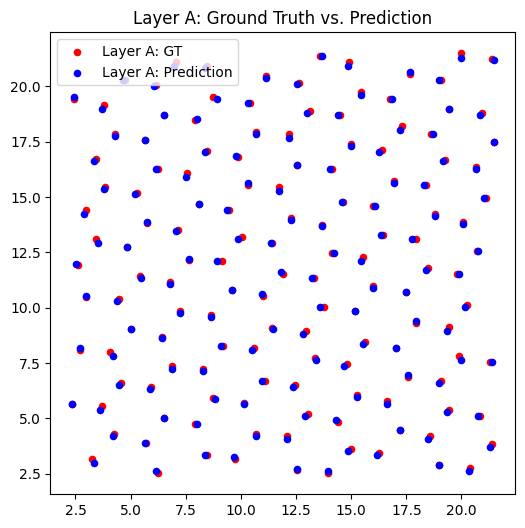

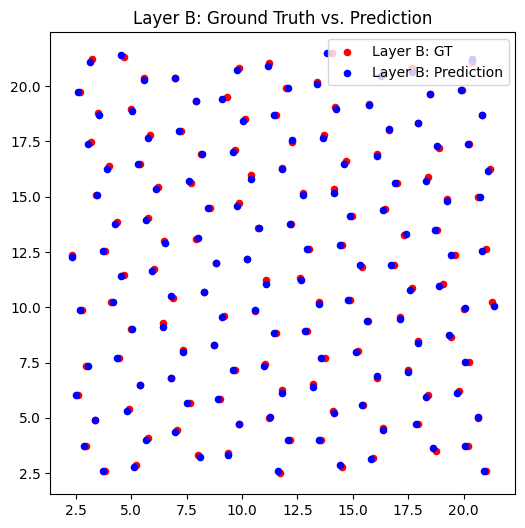

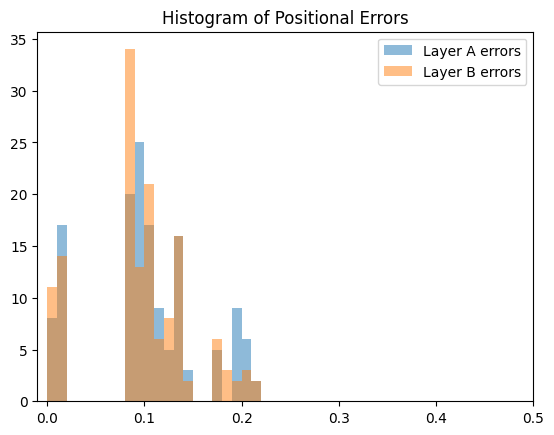

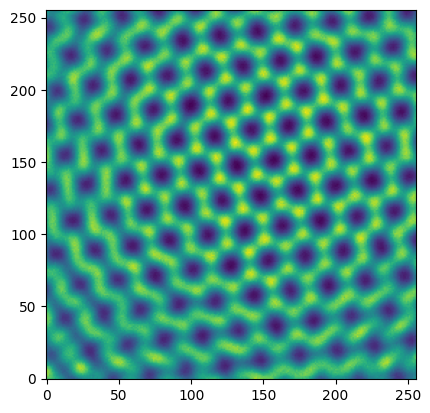

0.11956787109375
GT 2*sigma =  0.06853491467742213
Total positional error for Layer A with prediction[1]: 0.25140149052211763
Total positional error for Layer A with prediction[0]: 0.1278454518095984
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.131942561385813
Average positional error for both layers: 0.1298940065977057


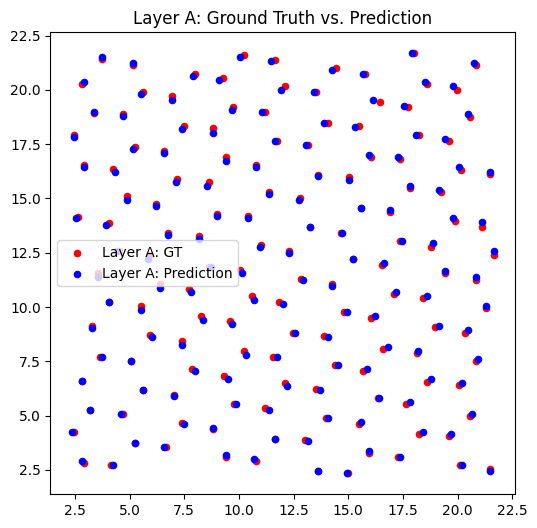

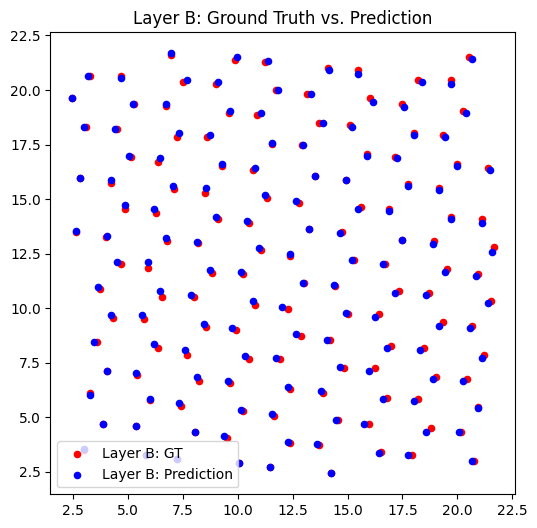

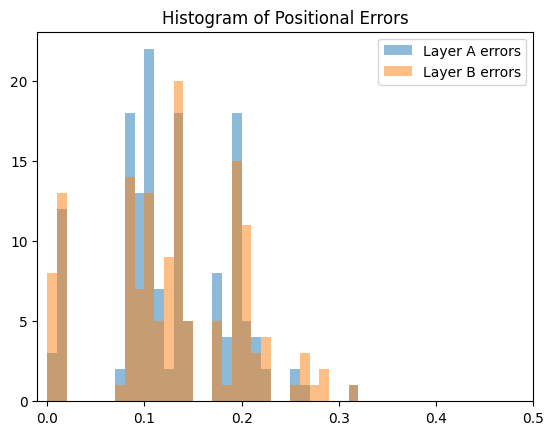

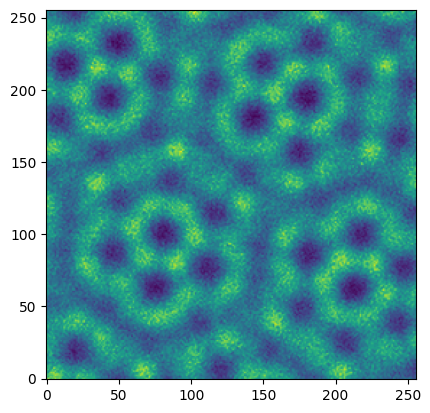

0.30538177490234375
GT 2*sigma =  0.0675496022598213
Total positional error for Layer A with prediction[1]: 0.1142231440259498
Total positional error for Layer A with prediction[0]: 0.3019083435573807
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.1212152098986252
Average positional error for both layers: 0.11771917696228751


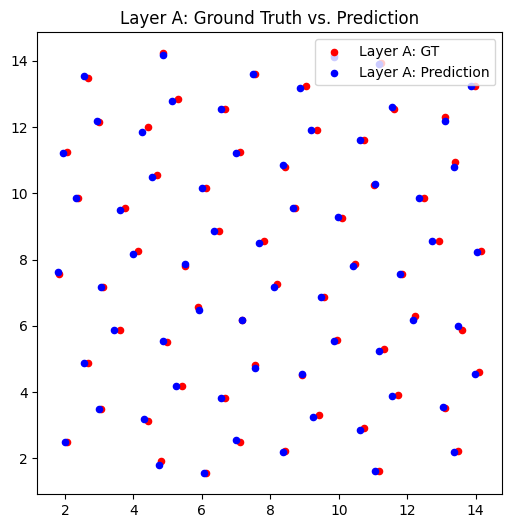

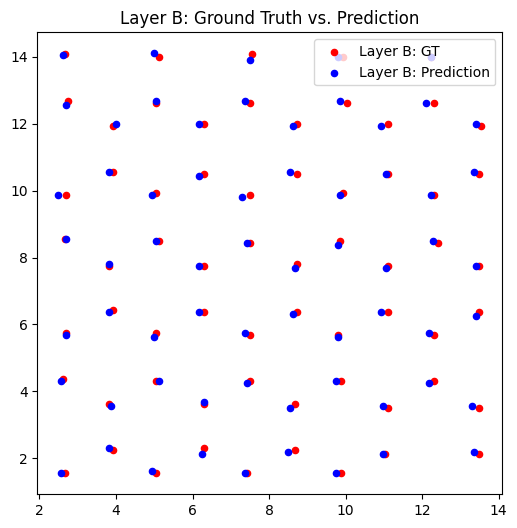

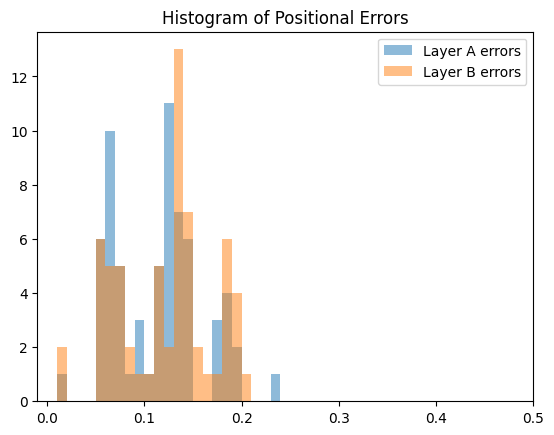

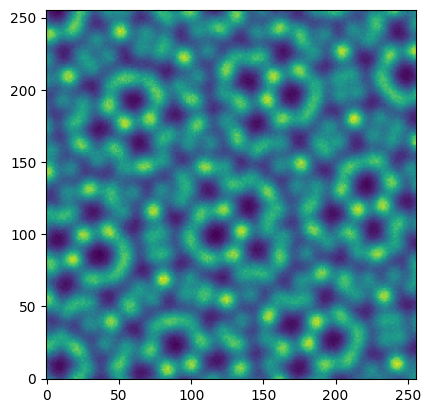

0.286956787109375
GT 2*sigma =  0.09769618423361213
Total positional error for Layer A with prediction[1]: 0.08439220441637356
Total positional error for Layer A with prediction[0]: 0.31483299371105233
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.07848237668564977
Average positional error for both layers: 0.08143729055101166


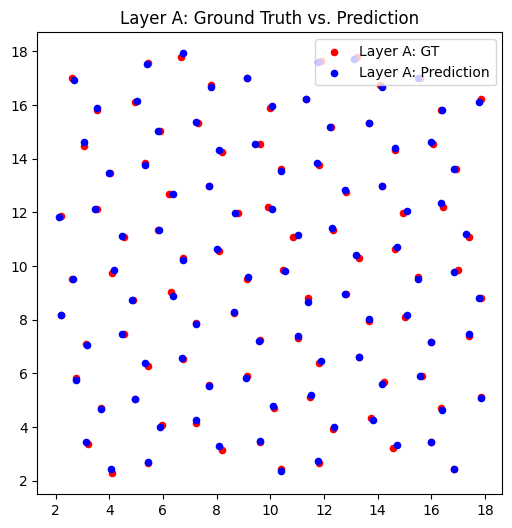

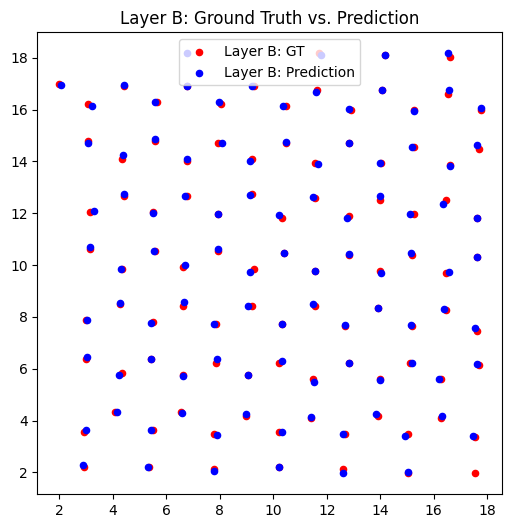

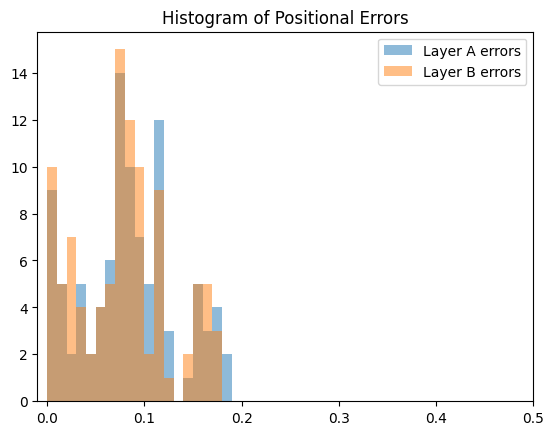

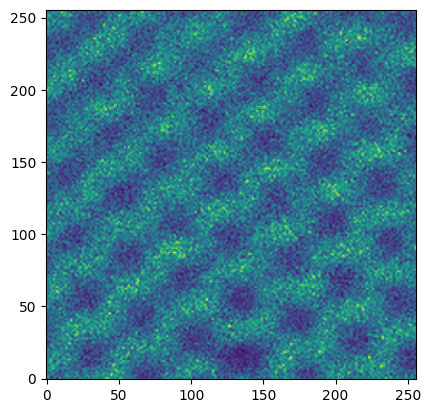

0.2543487548828125
GT 2*sigma =  0.06406719004840035
Total positional error for Layer A with prediction[1]: 0.23251577098491585
Total positional error for Layer A with prediction[0]: 0.30973523775737155
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.2951482866514685
Average positional error for both layers: 0.2638320288181922


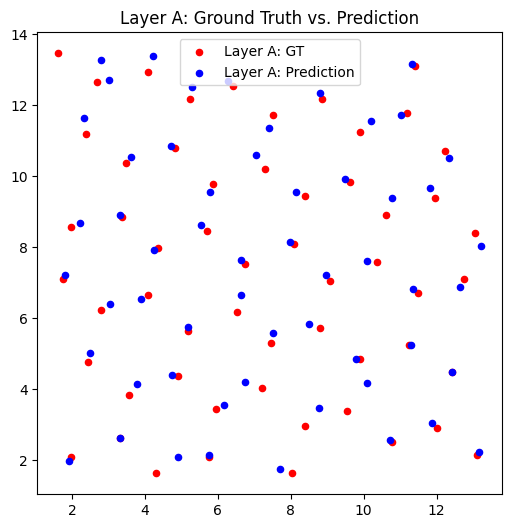

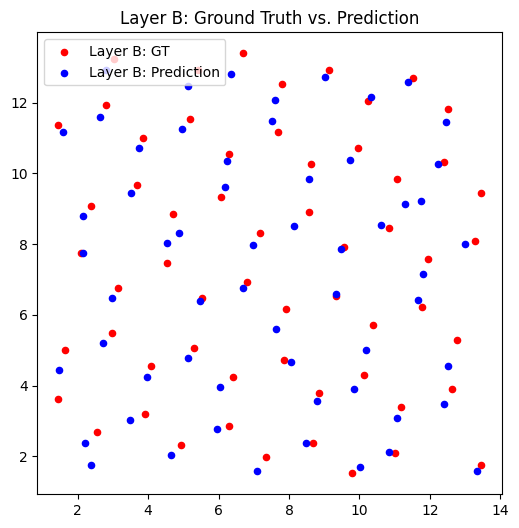

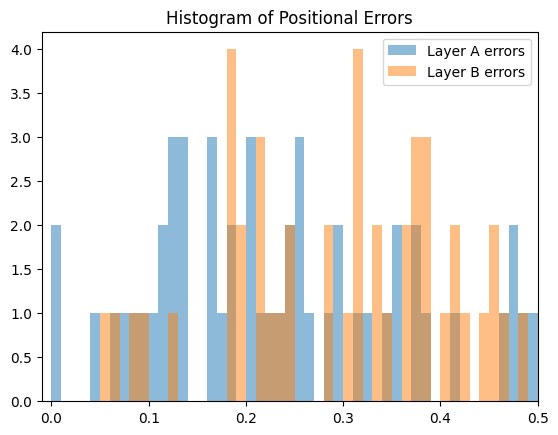

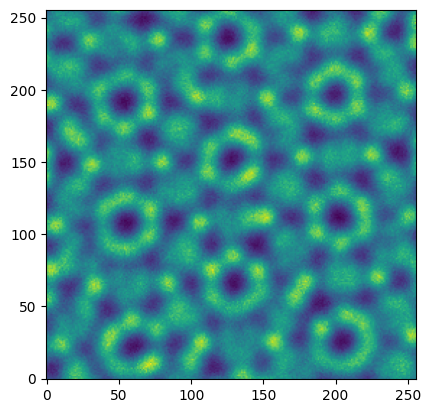

0.13353729248046875
GT 2*sigma =  0.13377083304914889
Total positional error for Layer A with prediction[1]: 0.23853115298939445
Total positional error for Layer A with prediction[0]: 0.15427430972167597
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.1592585939129764
Average positional error for both layers: 0.15676645181732618


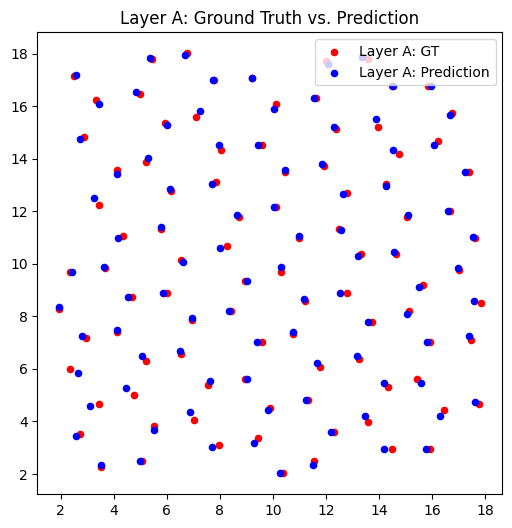

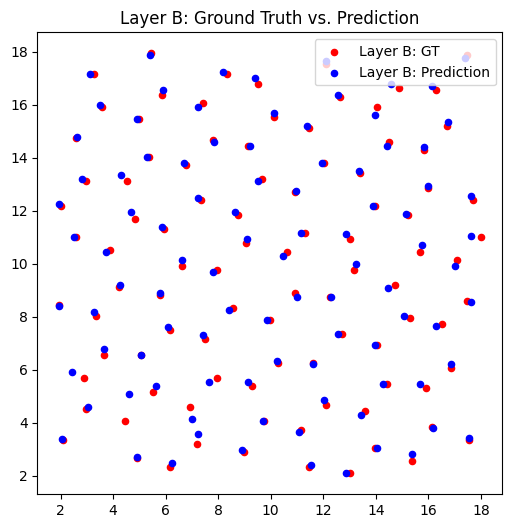

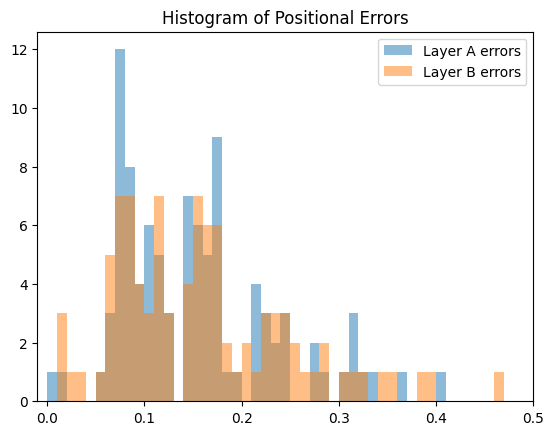

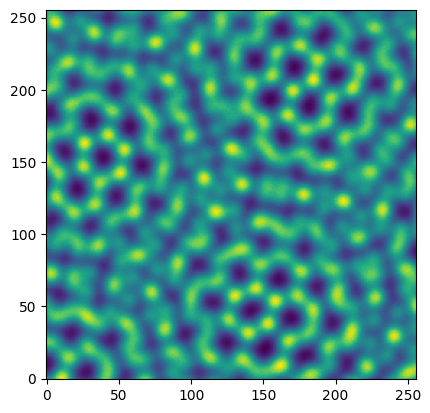

0.2974700927734375
GT 2*sigma =  0.12248291295892941
Total positional error for Layer A with prediction[1]: 0.10574748113780824
Total positional error for Layer A with prediction[0]: 0.30859529442401995
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.11036167860154814
Average positional error for both layers: 0.10805457986967819


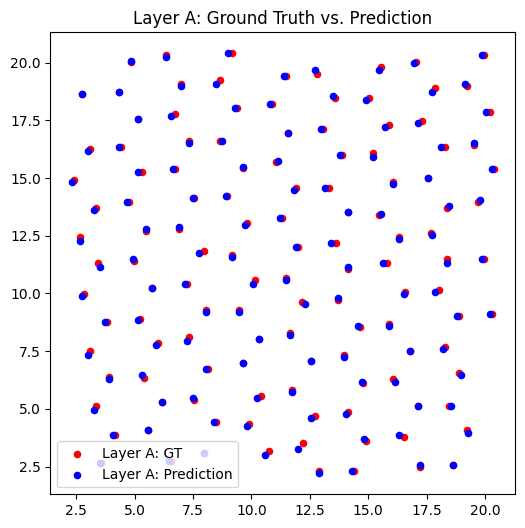

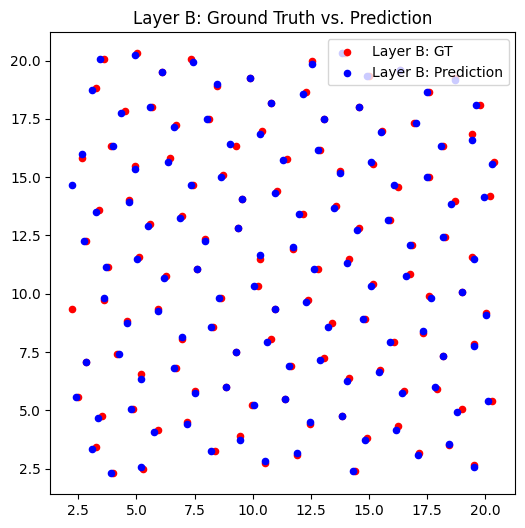

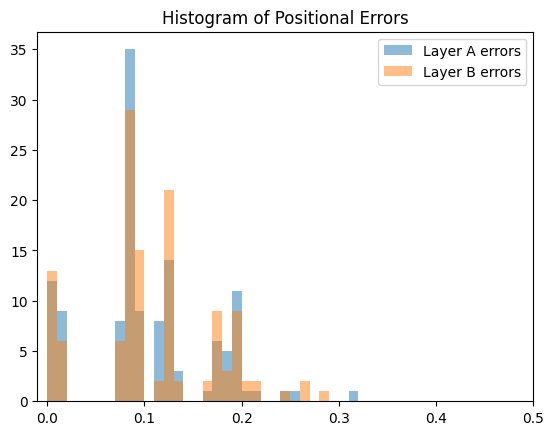

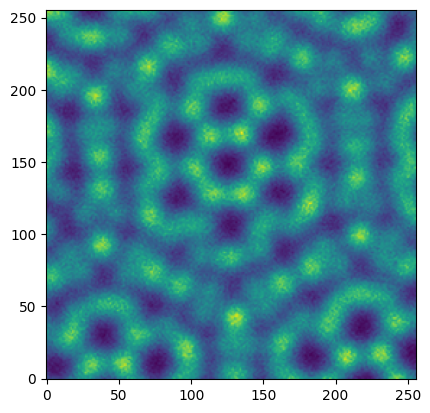

0.184814453125
GT 2*sigma =  0.12114531606000309
Total positional error for Layer A with prediction[1]: 0.15178498948715732
Total positional error for Layer A with prediction[0]: 0.22372023202574465
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.19890297025732842
Average positional error for both layers: 0.17534397987224287


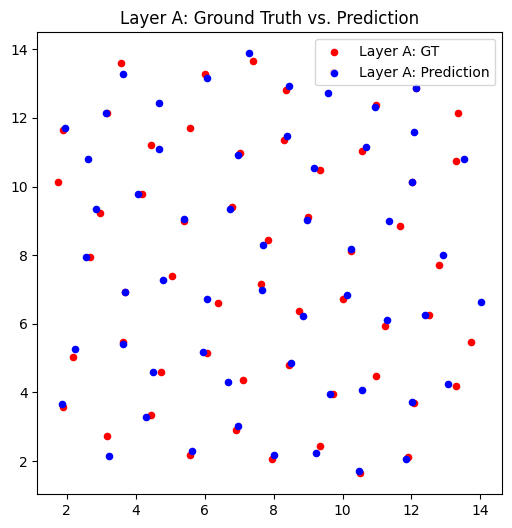

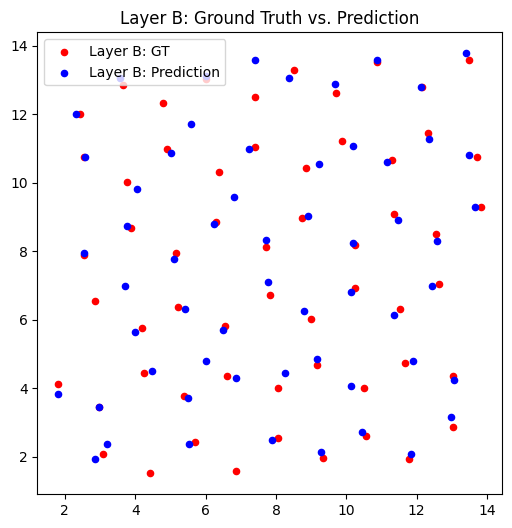

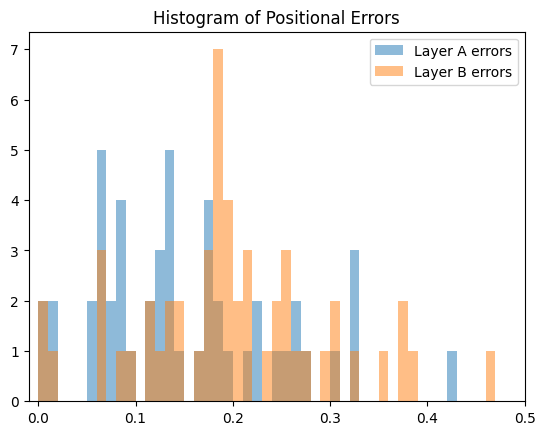

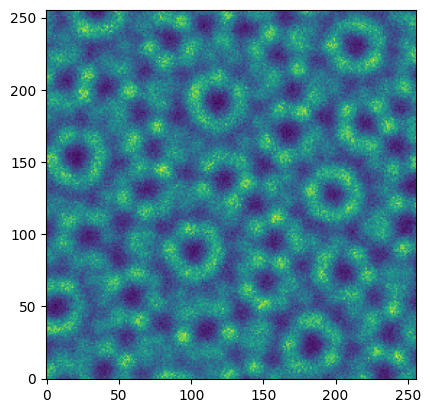

0.30133819580078125
GT 2*sigma =  0.10702482618214323
Total positional error for Layer A with prediction[1]: 0.09341713477064442
Total positional error for Layer A with prediction[0]: 0.3065729516075514
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.10106927134175371
Average positional error for both layers: 0.09724320305619907


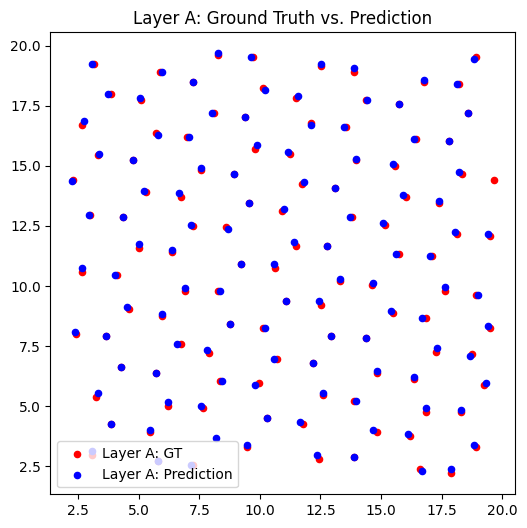

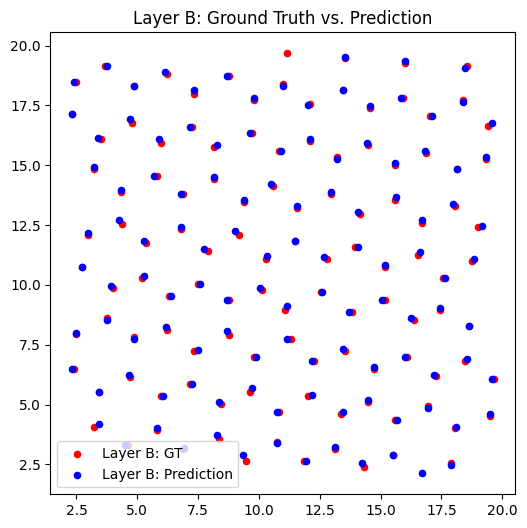

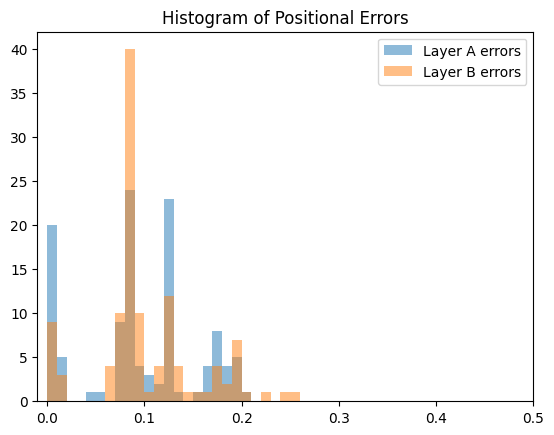

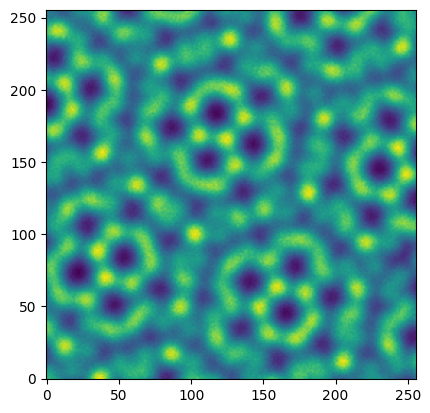

0.09223175048828125
GT 2*sigma =  0.06929073861113777
Total positional error for Layer A with prediction[1]: 0.2868306899045137
Total positional error for Layer A with prediction[0]: 0.06566604394859032
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.07175945194509296
Average positional error for both layers: 0.06871274794684165


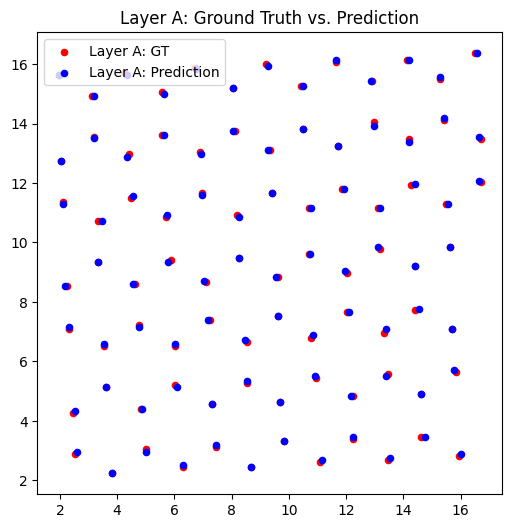

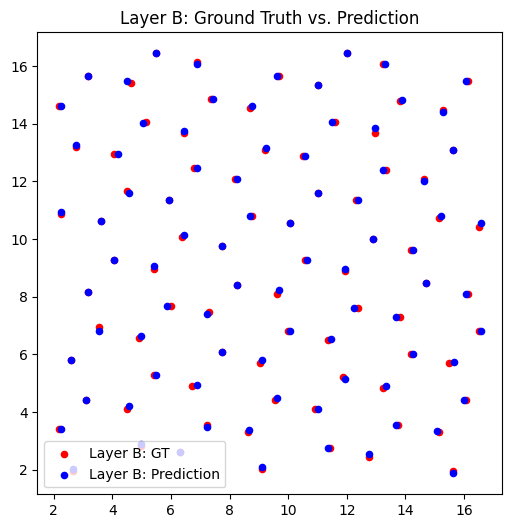

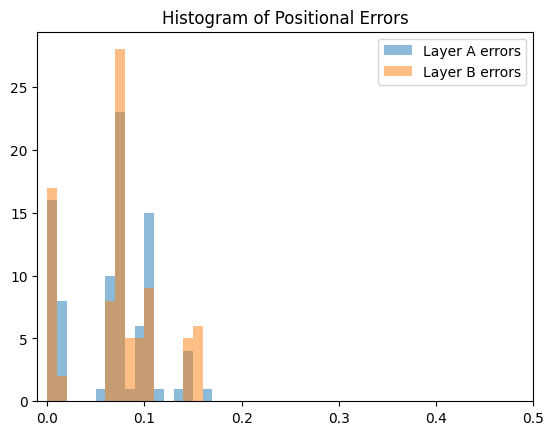

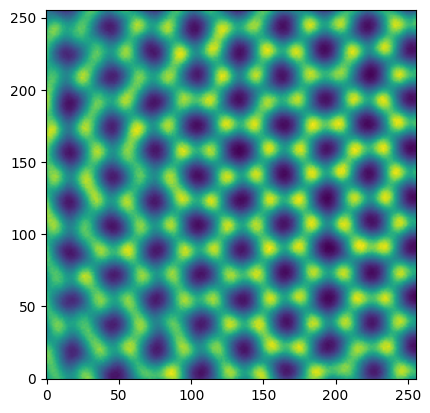

0.14511871337890625
GT 2*sigma =  0.0933215425425582
Total positional error for Layer A with prediction[1]: 0.14343051247029331
Total positional error for Layer A with prediction[0]: 0.15210729267222614
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.2305113431549477
Average positional error for both layers: 0.1869709278126205


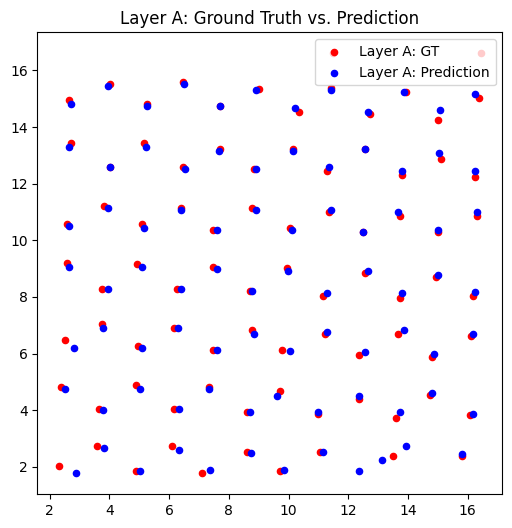

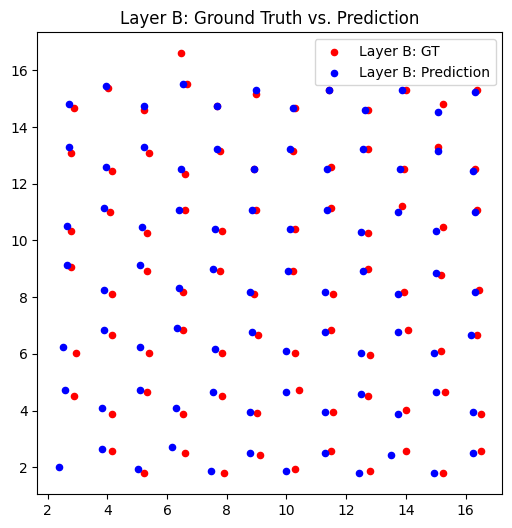

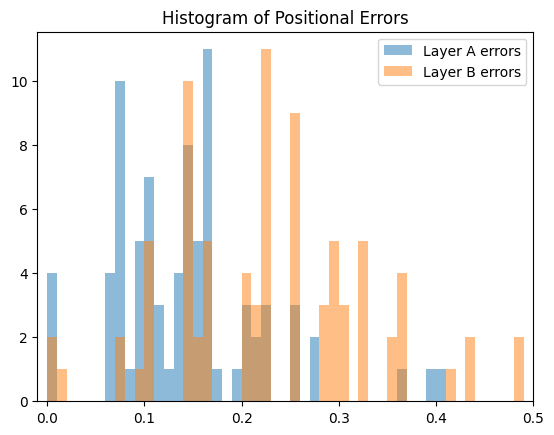

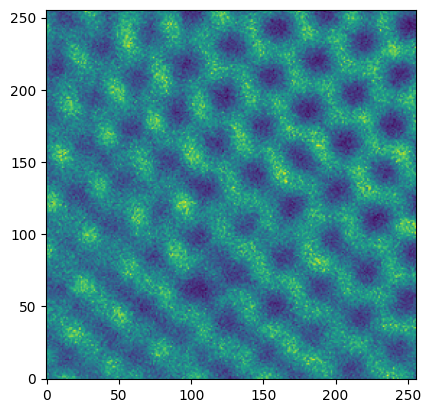

0.15386199951171875
GT 2*sigma =  0.10454695679358157
Total positional error for Layer A with prediction[1]: 0.30749085246551777
Total positional error for Layer A with prediction[0]: 0.1724406384434083
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.18629568061096927
Average positional error for both layers: 0.17936815952718876


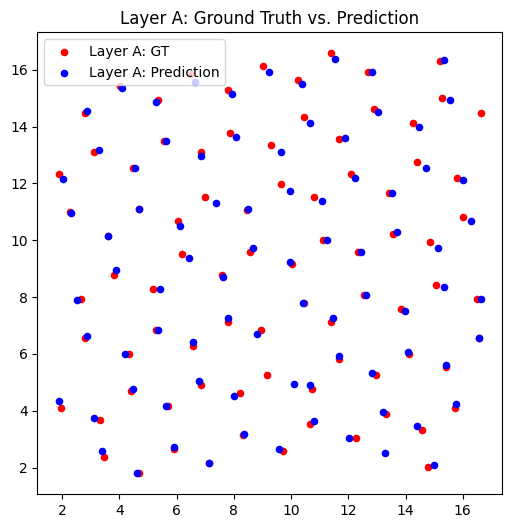

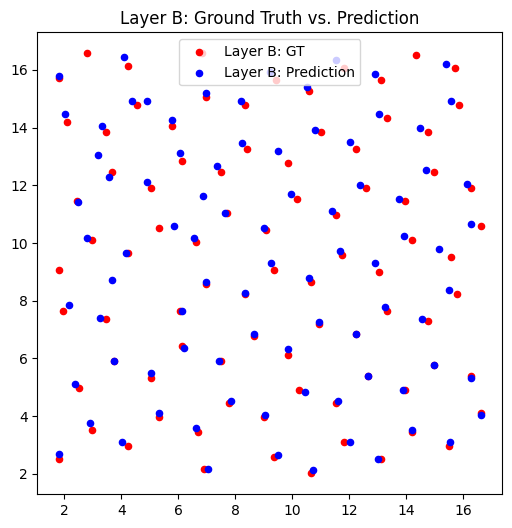

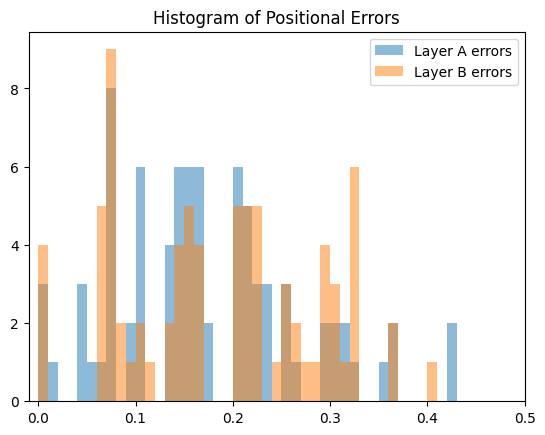

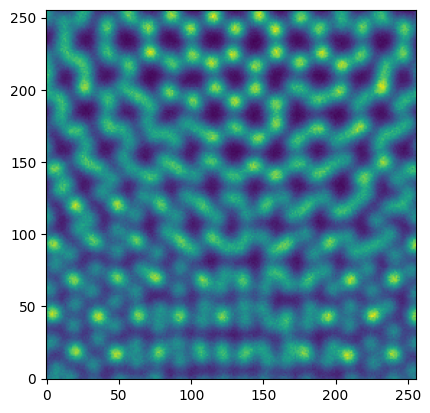

0.19112396240234375
GT 2*sigma =  0.12090722264299103
Total positional error for Layer A with prediction[1]: 0.18601260658711696
Total positional error for Layer A with prediction[0]: 0.2347801254299022
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.17517183150242627
Average positional error for both layers: 0.18059221904477163


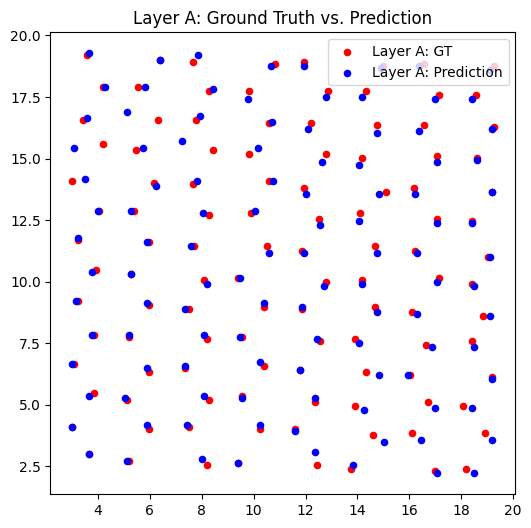

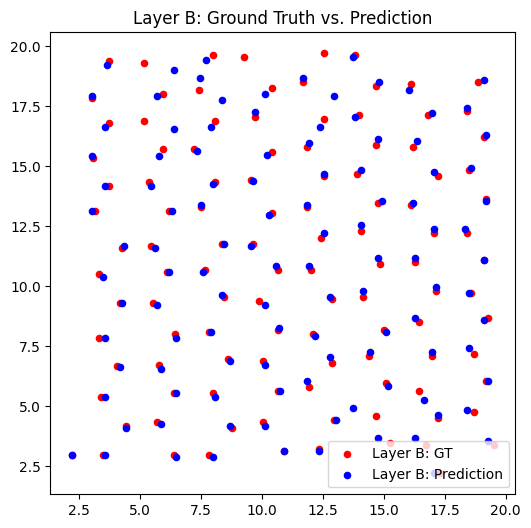

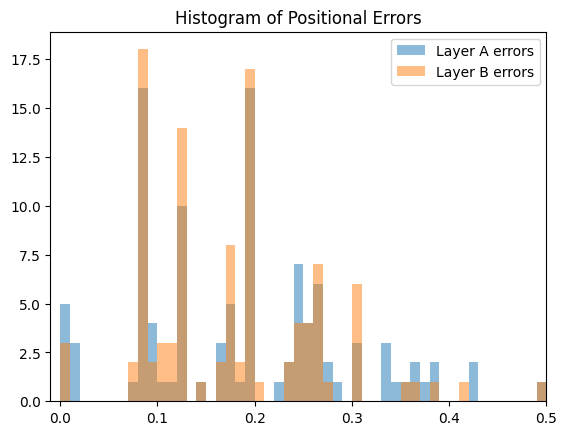

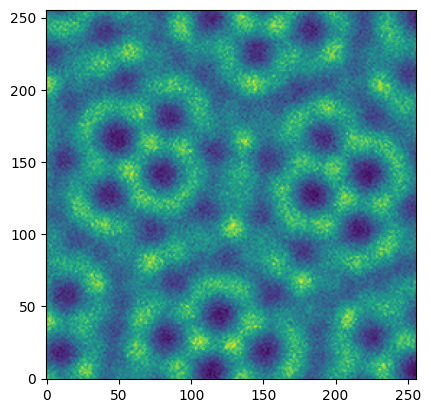

0.29451751708984375
GT 2*sigma =  0.06548073542944353
Total positional error for Layer A with prediction[1]: 0.09454485686587176
Total positional error for Layer A with prediction[0]: 0.27840658289032566
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.09045868798364026
Average positional error for both layers: 0.09250177242475602


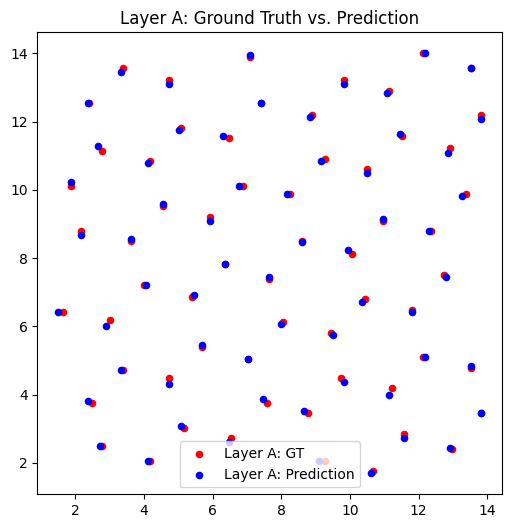

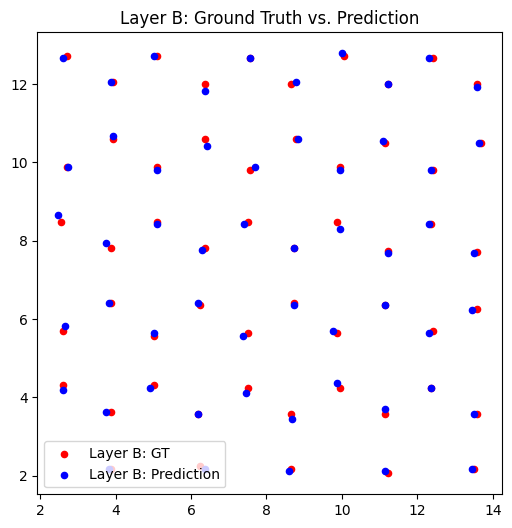

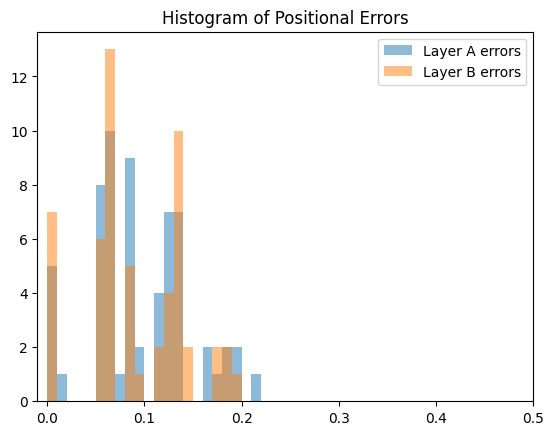

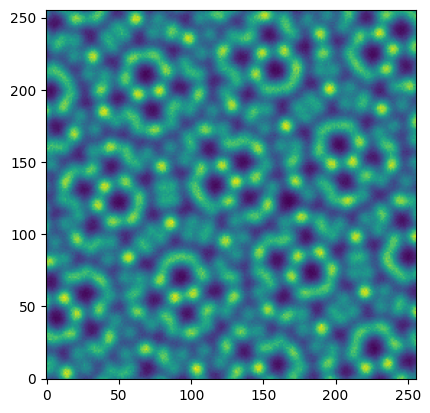

0.29851531982421875
GT 2*sigma =  0.07771728305237546
Total positional error for Layer A with prediction[1]: 0.0811609522218811
Total positional error for Layer A with prediction[0]: 0.2819865405837931
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.0853896121030849
Average positional error for both layers: 0.083275282162483


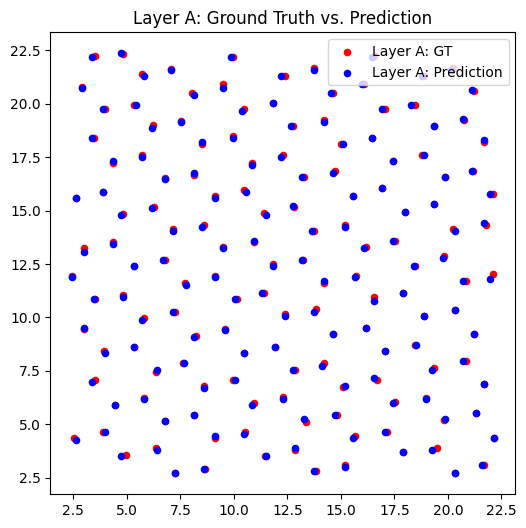

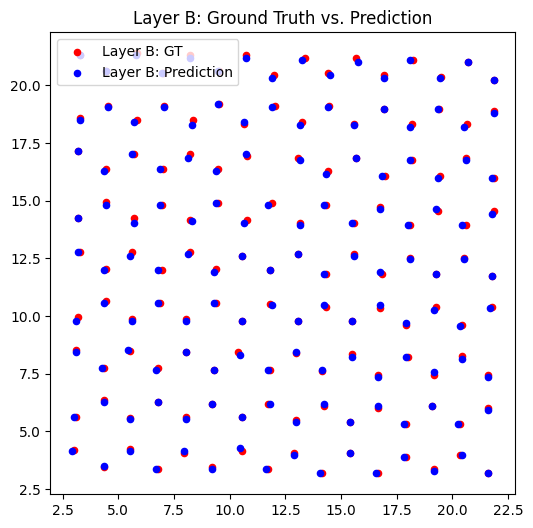

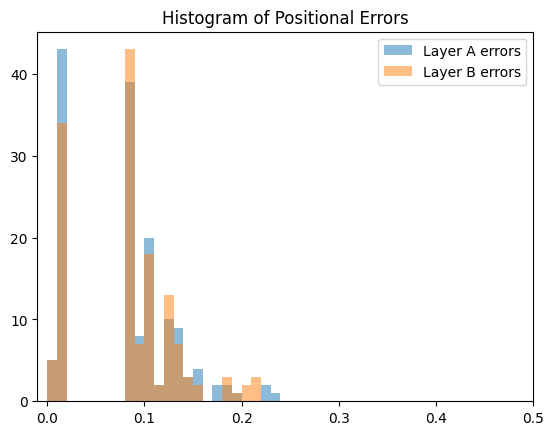

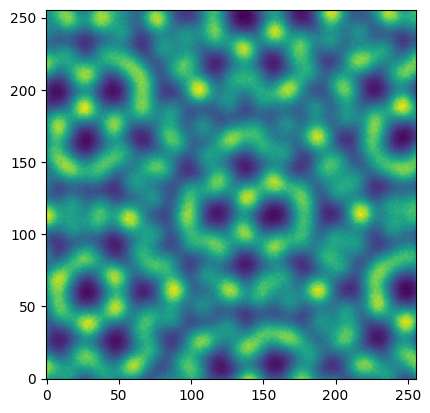

0.2198638916015625
GT 2*sigma =  0.09569596558254478
Total positional error for Layer A with prediction[1]: 0.17452578337142546
Total positional error for Layer A with prediction[0]: 0.1858689386953603
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.1417985396318787
Average positional error for both layers: 0.15816216150165208


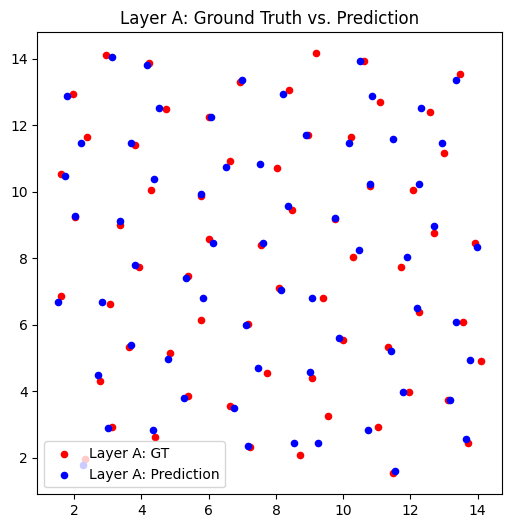

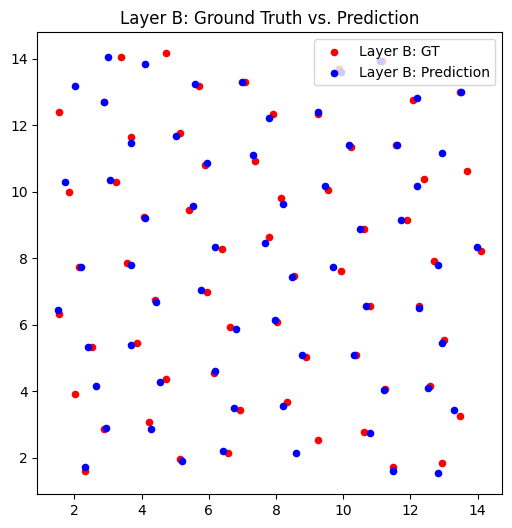

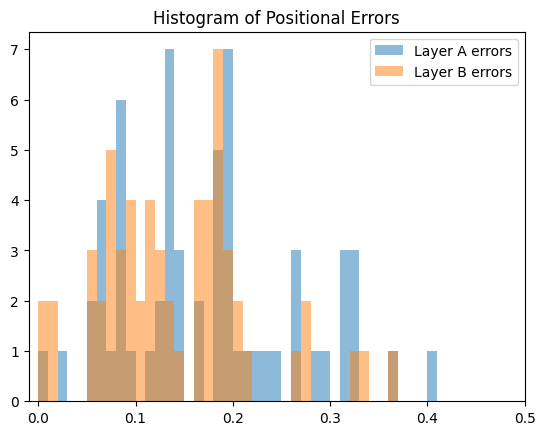

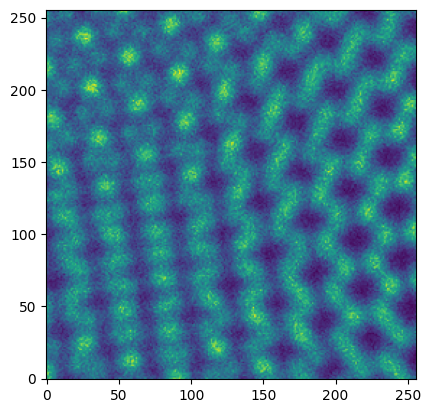

0.234771728515625
GT 2*sigma =  0.07447522416682628
Total positional error for Layer A with prediction[1]: 0.11947565088778664
Total positional error for Layer A with prediction[0]: 0.2472368675844455
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.12126175028421349
Average positional error for both layers: 0.12036870058600006


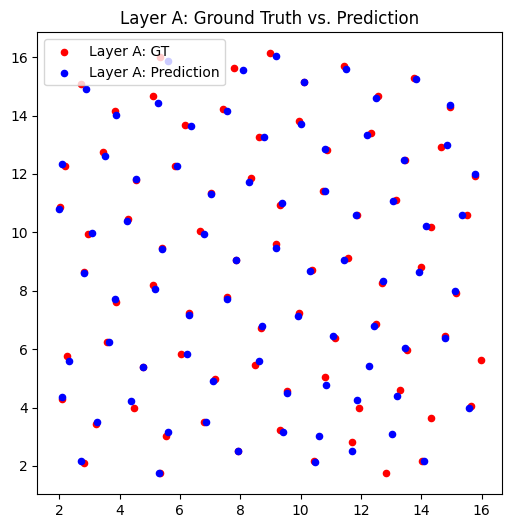

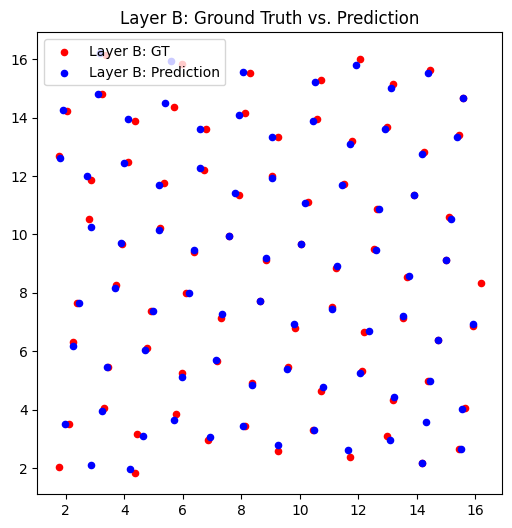

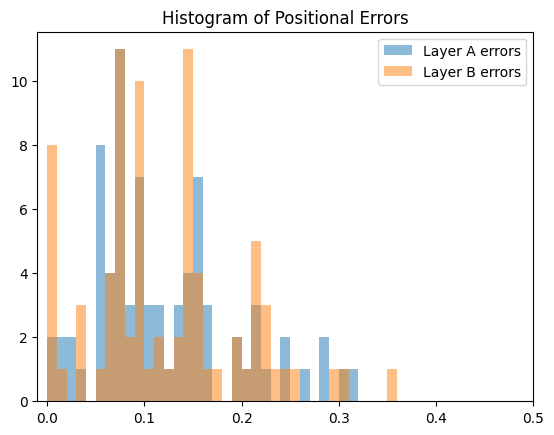

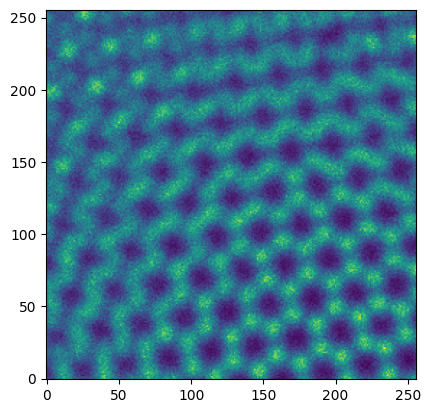

0.2190399169921875
GT 2*sigma =  0.0891851086815933
Total positional error for Layer A with prediction[1]: 0.17054819388427972
Total positional error for Layer A with prediction[0]: 0.24600757298254913
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.1464493173803888
Average positional error for both layers: 0.15849875563233426


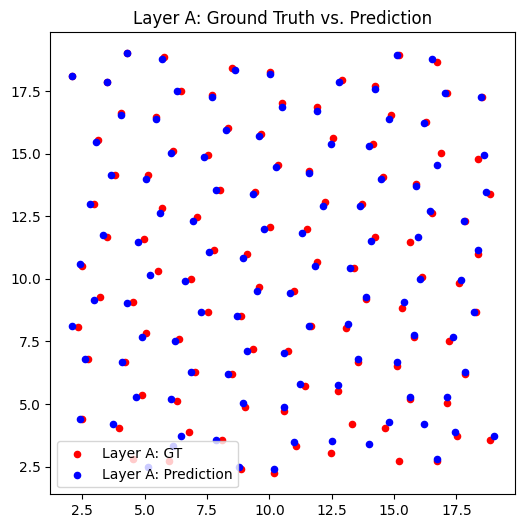

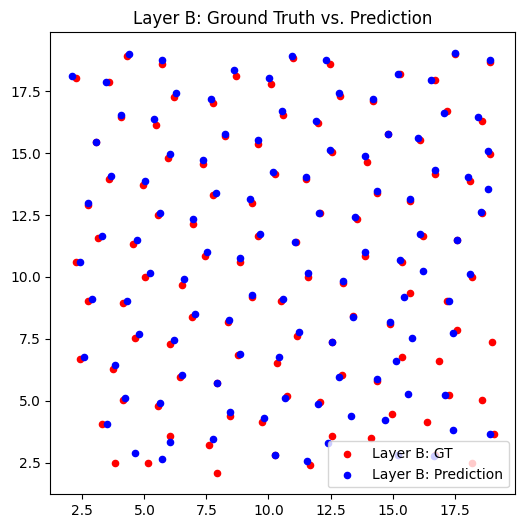

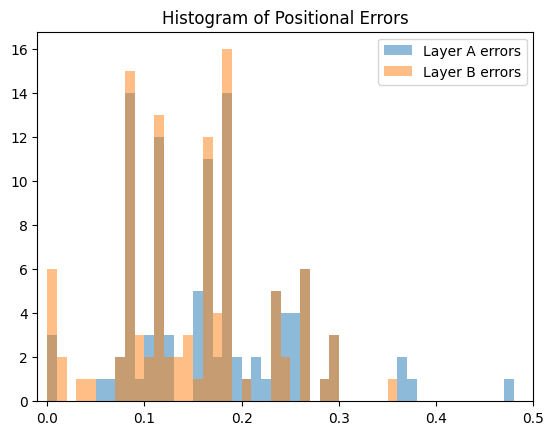

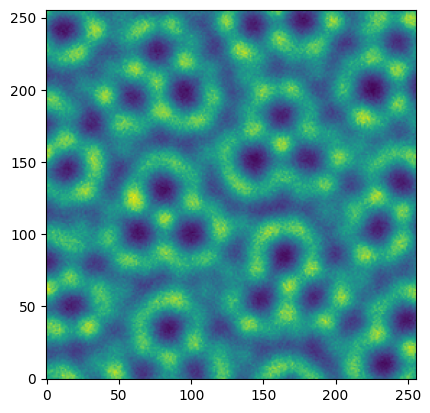

0.15189361572265625
GT 2*sigma =  0.13133922328315675
Total positional error for Layer A with prediction[1]: 0.2564528930022577
Total positional error for Layer A with prediction[0]: 0.1699390330846534
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.187071476151935
Average positional error for both layers: 0.1785052546182942


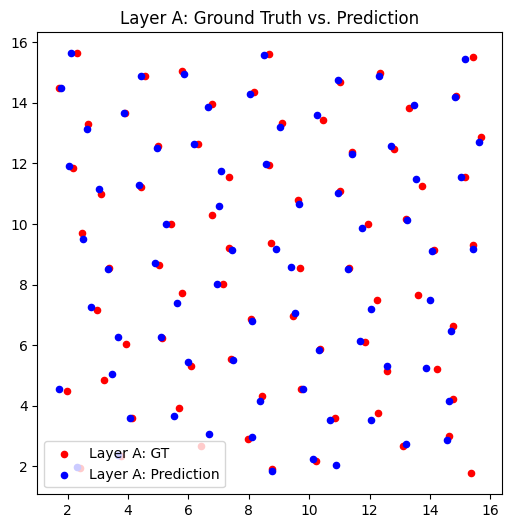

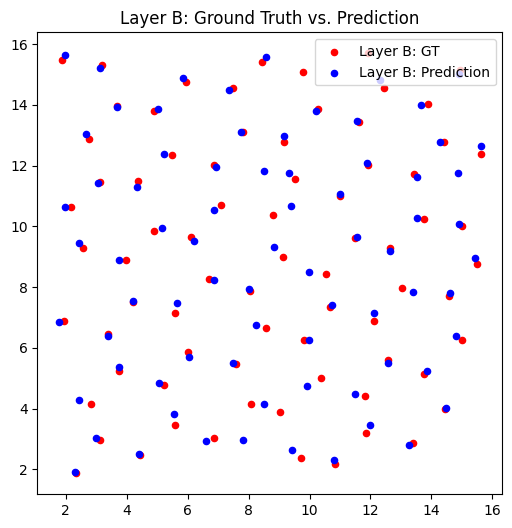

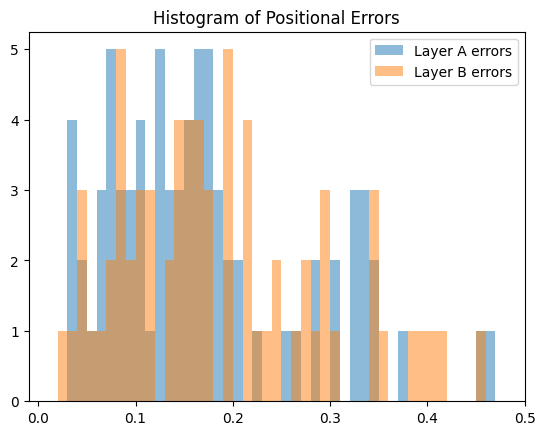

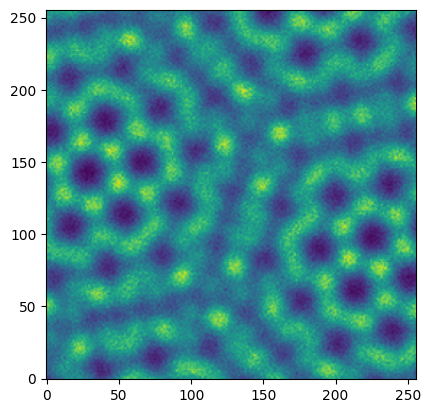

0.094268798828125
GT 2*sigma =  0.054361552449329956
Total positional error for Layer A with prediction[1]: 0.26361847093202717
Total positional error for Layer A with prediction[0]: 0.09109368758666907
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.08133716518427425
Average positional error for both layers: 0.08621542638547167


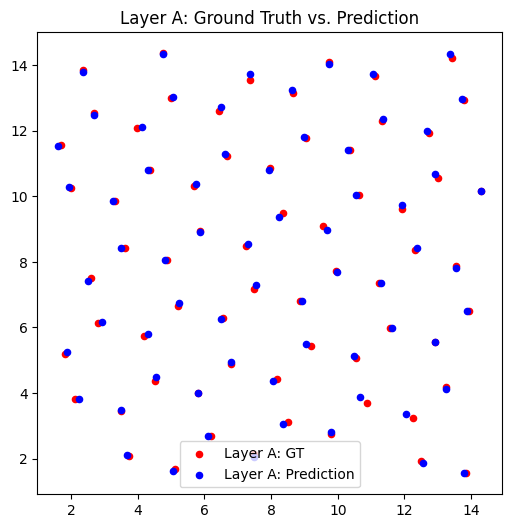

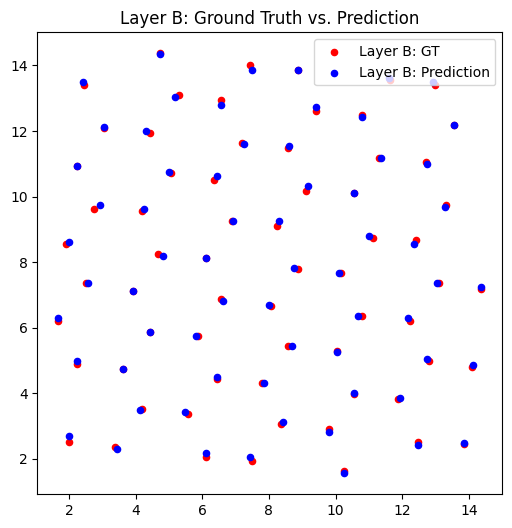

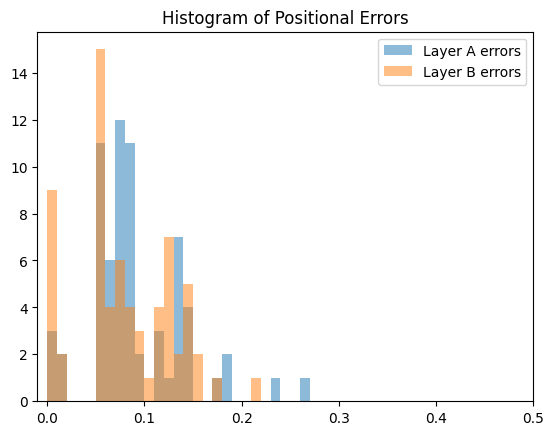

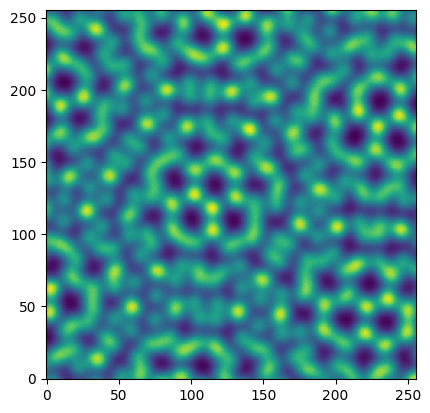

0.09647369384765625
GT 2*sigma =  0.11883502597240306
Total positional error for Layer A with prediction[1]: 0.28450723417246077
Total positional error for Layer A with prediction[0]: 0.09833968172593748
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.10035577293961967
Average positional error for both layers: 0.09934772733277858


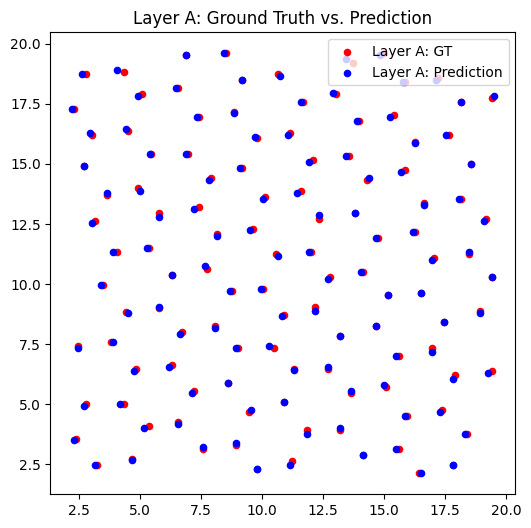

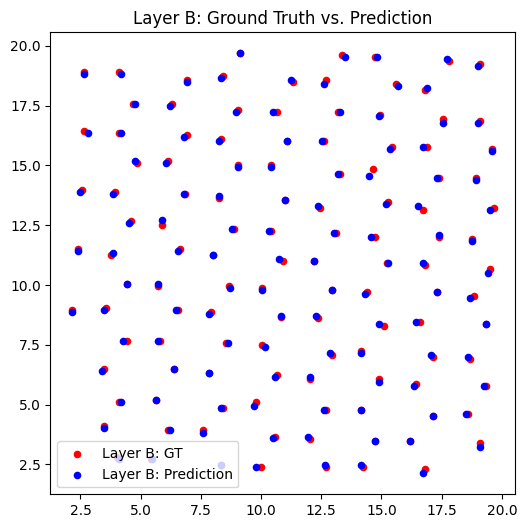

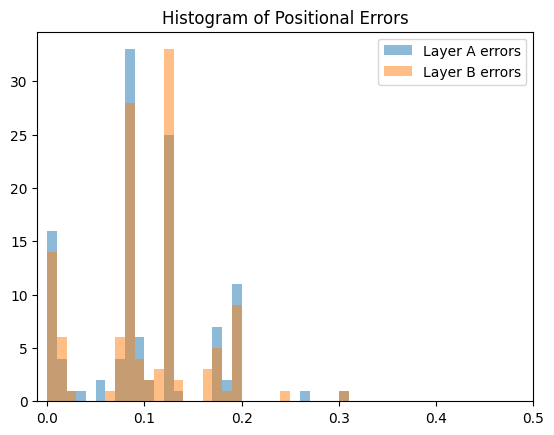

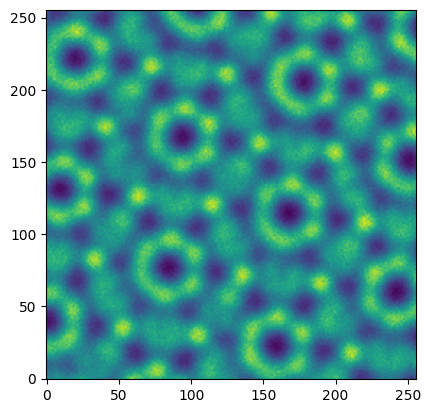

0.30753326416015625
GT 2*sigma =  0.08694663830397686
Total positional error for Layer A with prediction[1]: 0.07221220284835639
Total positional error for Layer A with prediction[0]: 0.27324384770006116
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.08455255603187051
Average positional error for both layers: 0.07838237944011345


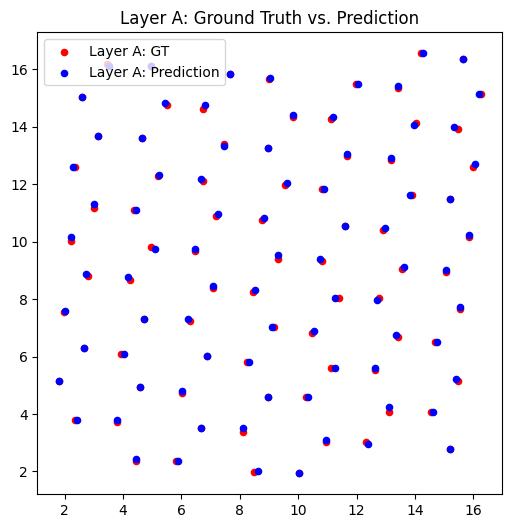

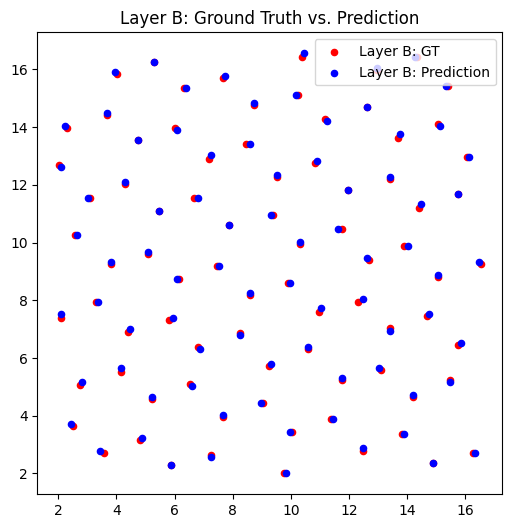

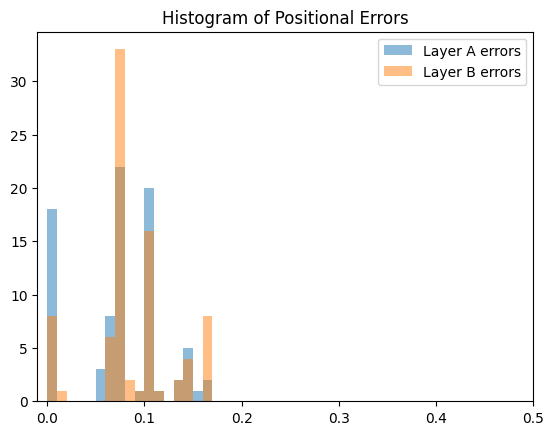

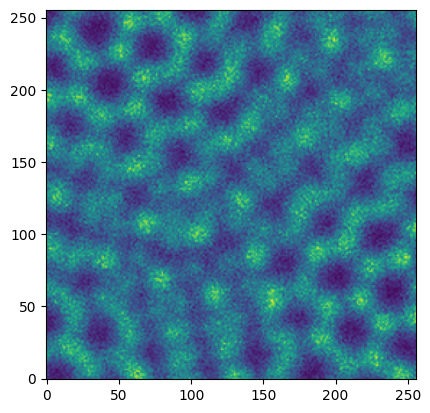

0.21547698974609375
GT 2*sigma =  0.14789255082826303
Total positional error for Layer A with prediction[1]: 0.15886249069021496
Total positional error for Layer A with prediction[0]: 0.2478597177162803
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.16071336938625447
Average positional error for both layers: 0.15978793003823472


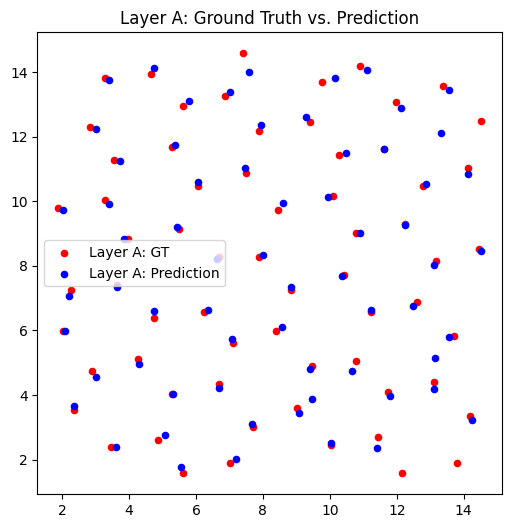

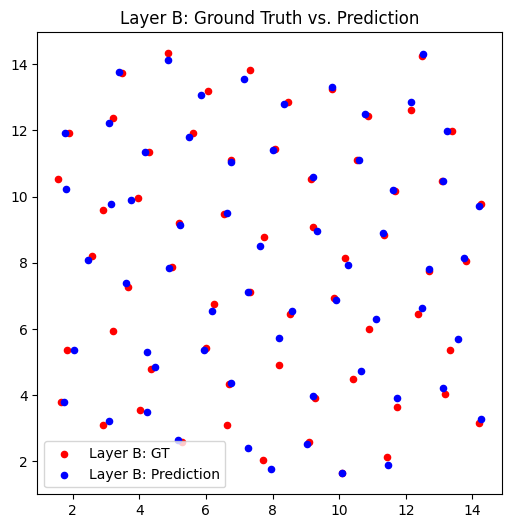

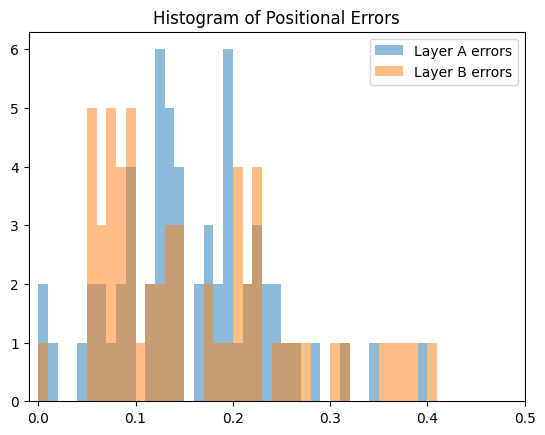

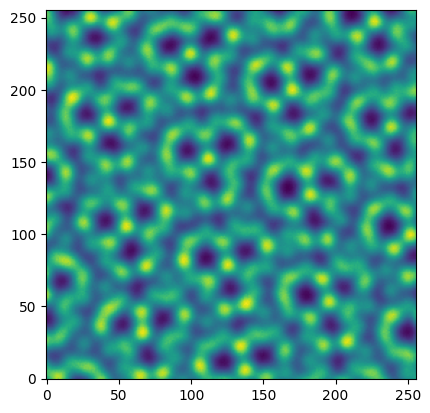

0.304168701171875
GT 2*sigma =  0.09506197428605692
Total positional error for Layer A with prediction[1]: 0.10143648514219418
Total positional error for Layer A with prediction[0]: 0.3273594052077032
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.10702787903163652
Average positional error for both layers: 0.10423218208691534


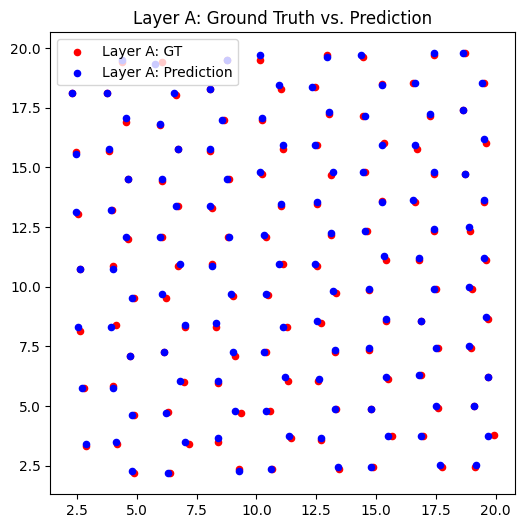

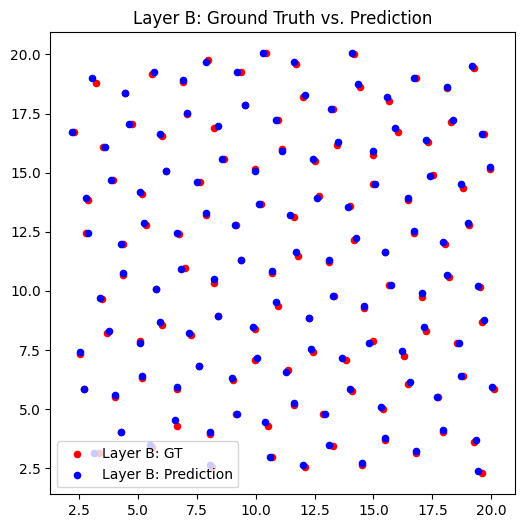

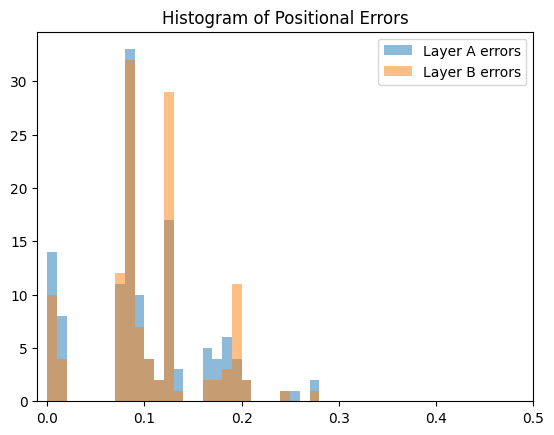

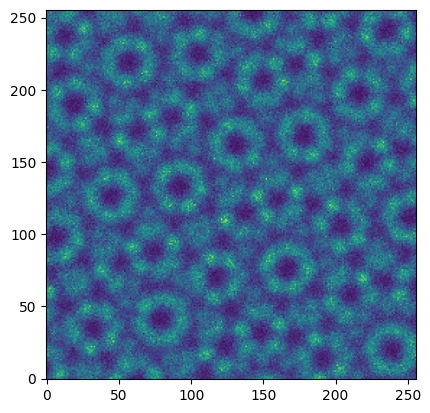

0.1038360595703125
GT 2*sigma =  0.07687278133346252
Total positional error for Layer A with prediction[1]: 0.3337417675417132
Total positional error for Layer A with prediction[0]: 0.1108878350706894
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.11157936612601023
Average positional error for both layers: 0.11123360059834982


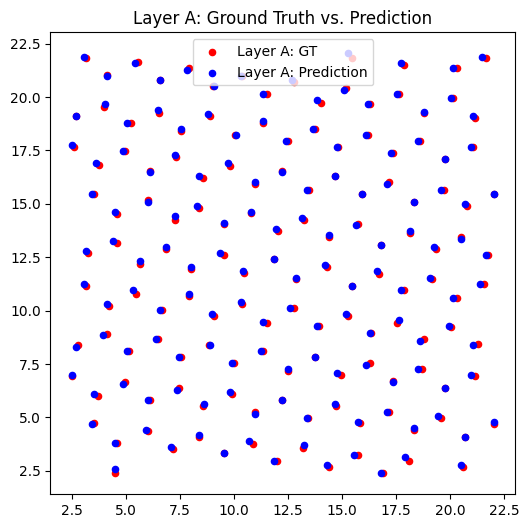

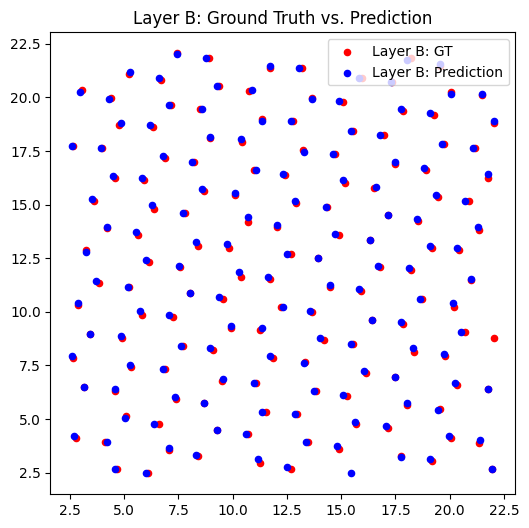

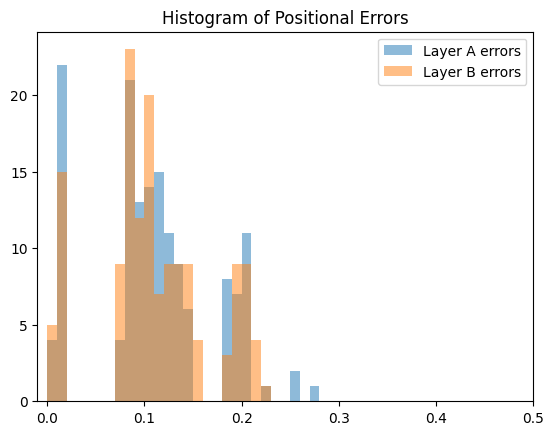

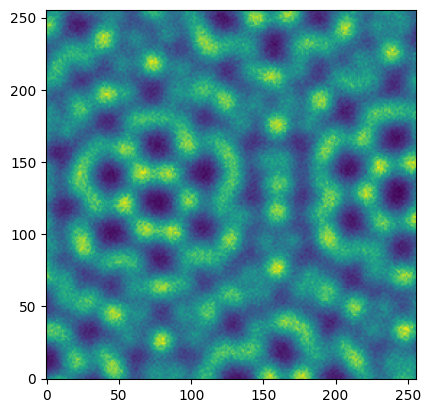

0.16663360595703125
GT 2*sigma =  0.11915728147091917
Total positional error for Layer A with prediction[1]: 0.2063955160391271
Total positional error for Layer A with prediction[0]: 0.17941041923224438
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.17166682245302925
Average positional error for both layers: 0.17553862084263683


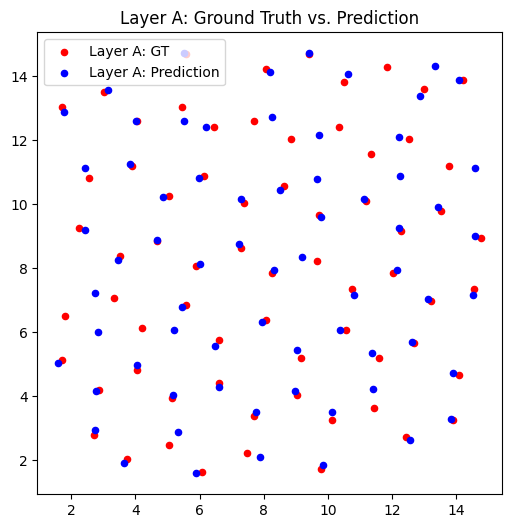

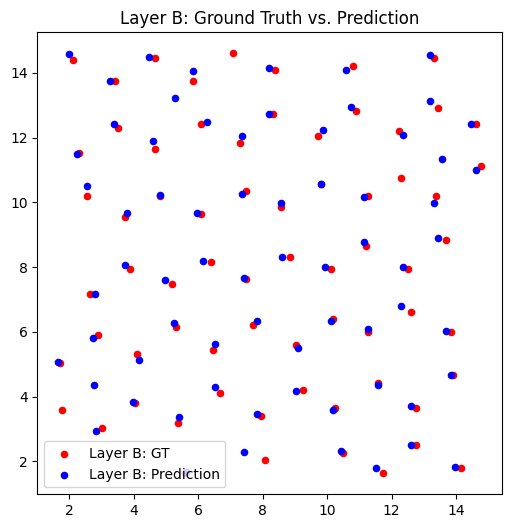

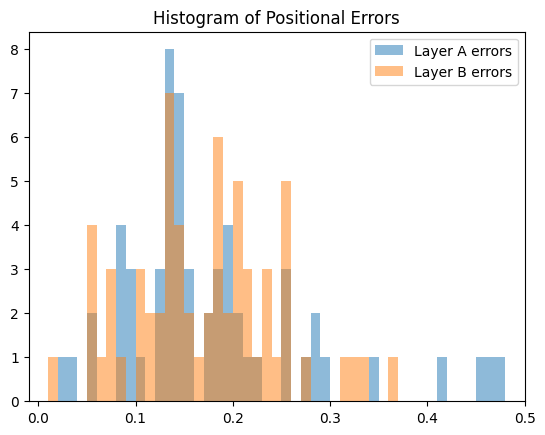

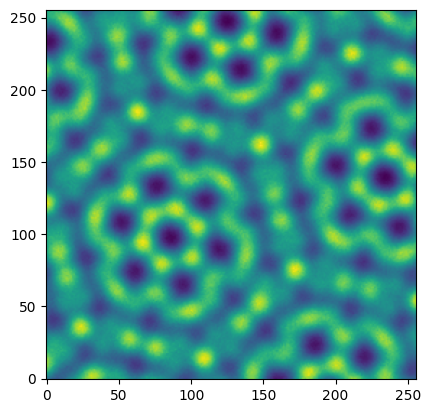

0.095550537109375
GT 2*sigma =  0.07582943291765132
Total positional error for Layer A with prediction[1]: 0.3171012279455339
Total positional error for Layer A with prediction[0]: 0.07594346282845568
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.07325602081236346
Average positional error for both layers: 0.07459974182040957


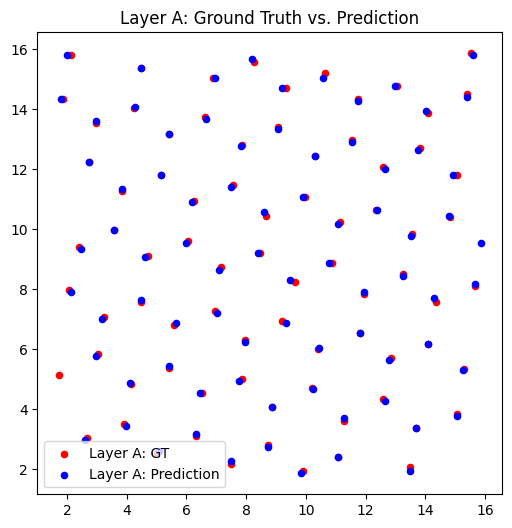

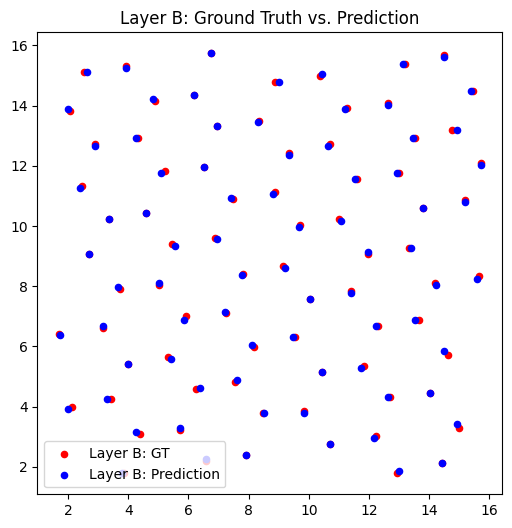

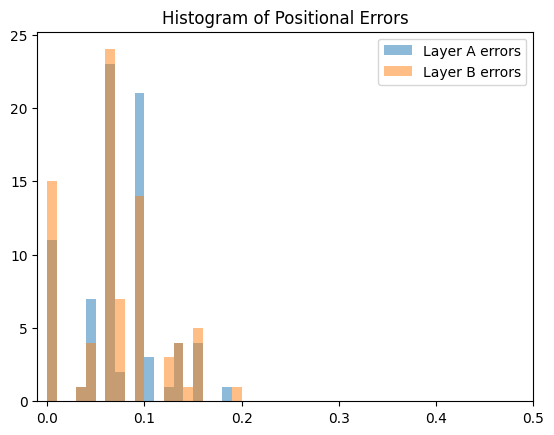

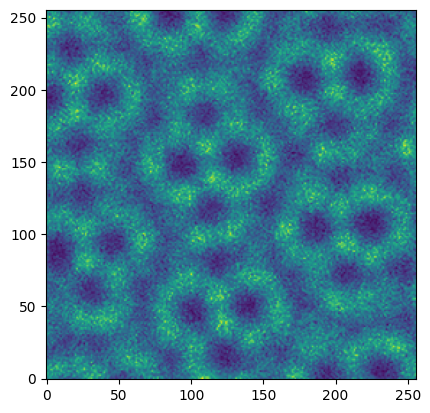

0.14771270751953125
GT 2*sigma =  0.09595873333579613
Total positional error for Layer A with prediction[1]: 0.2768015500722502
Total positional error for Layer A with prediction[0]: 0.1660752809642667
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.1625641679710869
Average positional error for both layers: 0.1643197244676768


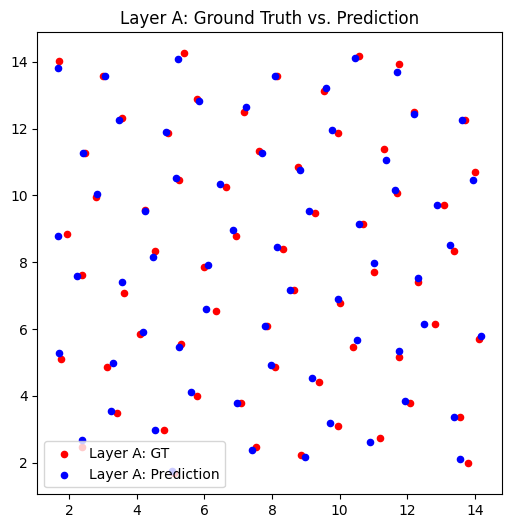

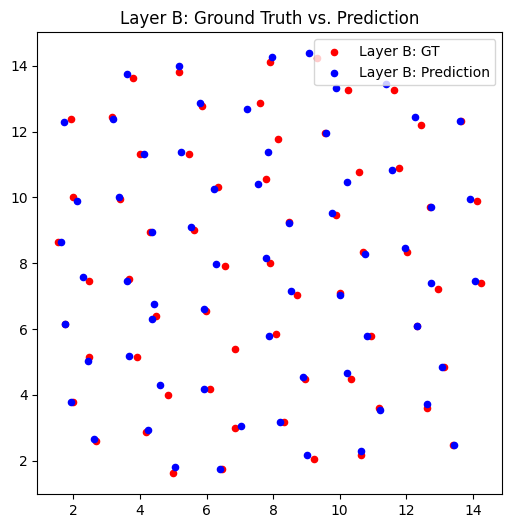

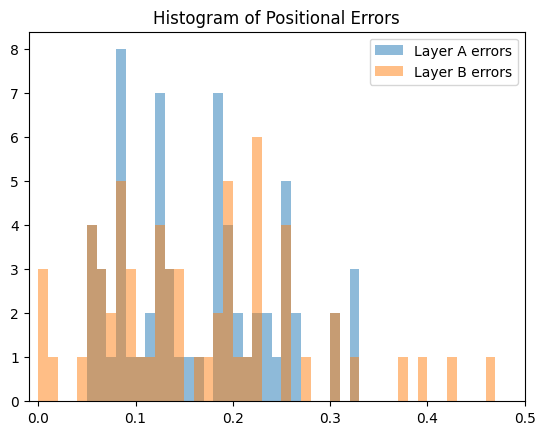

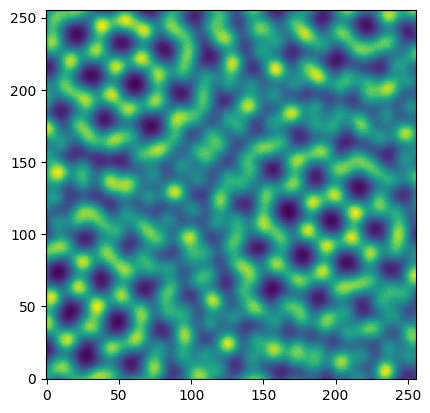

0.2915802001953125
GT 2*sigma =  0.13794457523512332
Total positional error for Layer A with prediction[1]: 0.12173117292253903
Total positional error for Layer A with prediction[0]: 0.33702452976905556
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.12994012154214393
Average positional error for both layers: 0.12583564723234147


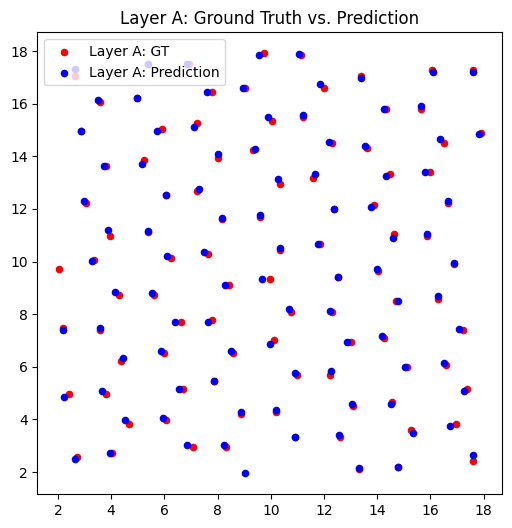

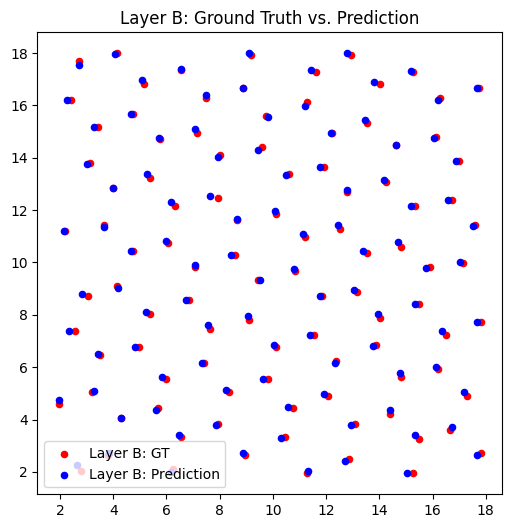

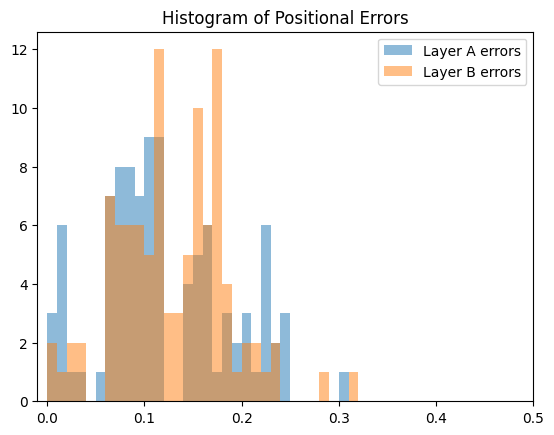

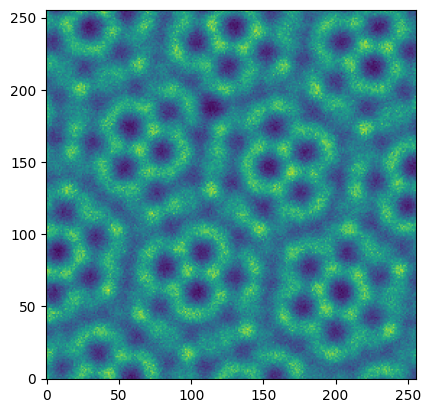

0.3170318603515625
GT 2*sigma =  0.04448153167965486
Total positional error for Layer A with prediction[1]: 0.06812761393168612
Total positional error for Layer A with prediction[0]: 0.30191143521591635
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.05699107674148562
Average positional error for both layers: 0.06255934533658587


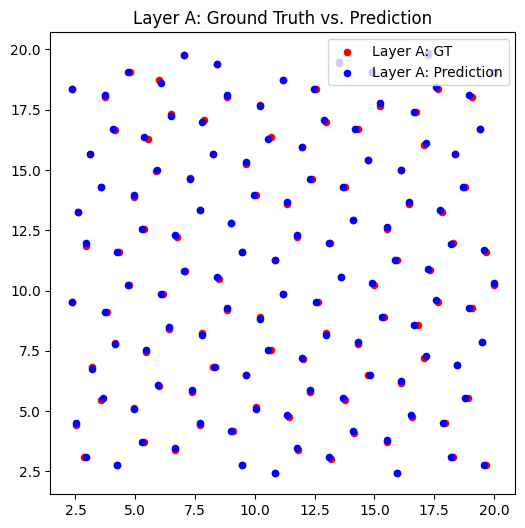

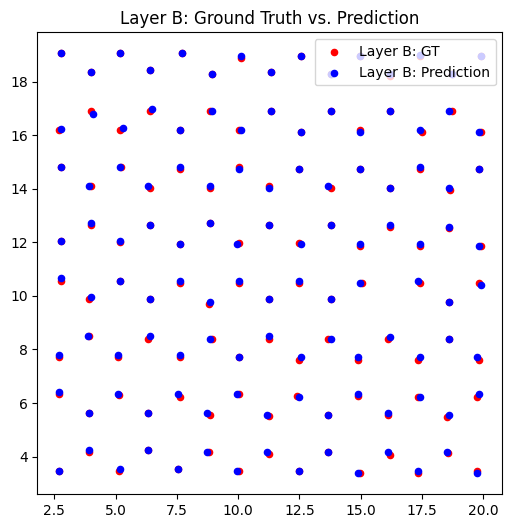

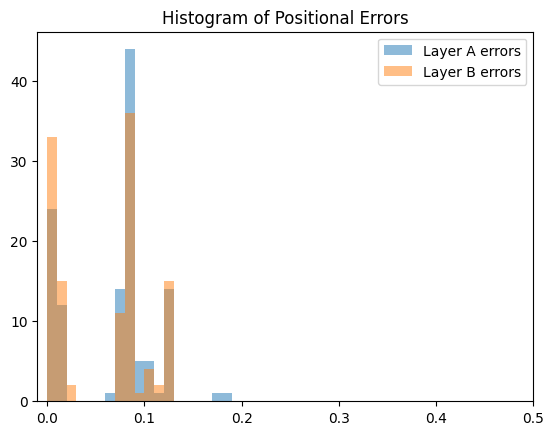

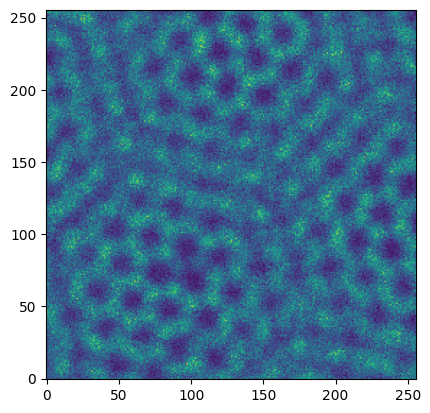

0.11301422119140625
GT 2*sigma =  0.12126212286461258
Total positional error for Layer A with prediction[1]: 0.31914404787454037
Total positional error for Layer A with prediction[0]: 0.12089031992910323
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.10765723628856312
Average positional error for both layers: 0.11427377810883318


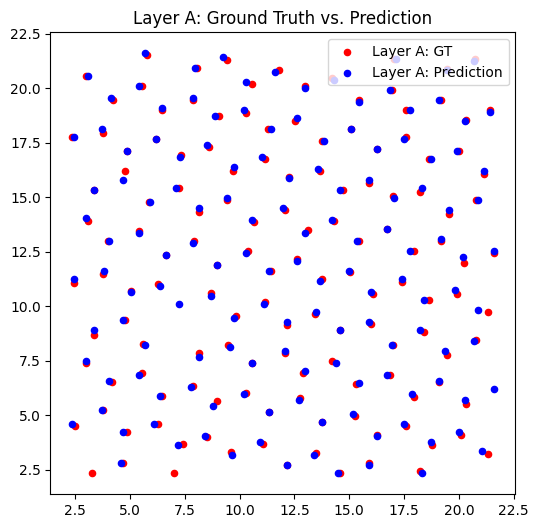

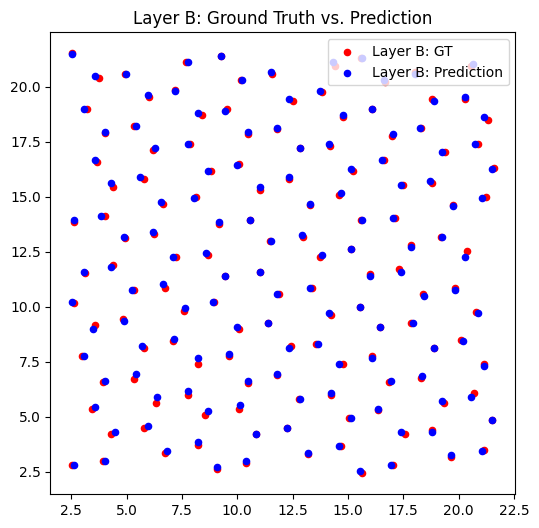

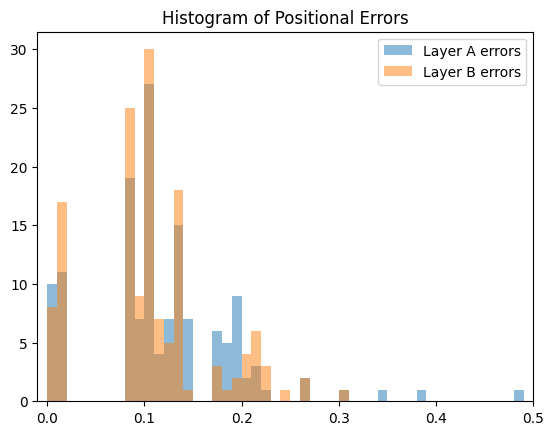

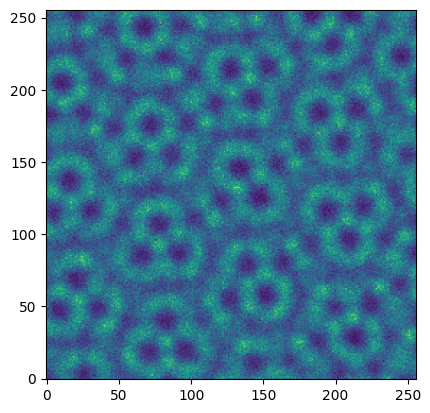

0.1085968017578125
GT 2*sigma =  0.11083423441386428
Total positional error for Layer A with prediction[1]: 0.32675156640823794
Total positional error for Layer A with prediction[0]: 0.09880028775115134
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.09741832266487008
Average positional error for both layers: 0.0981093052080107


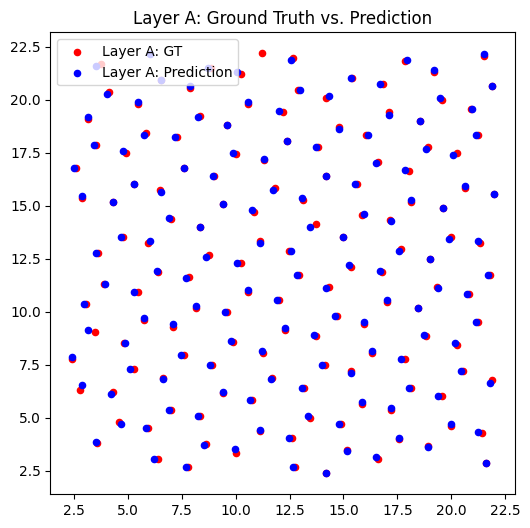

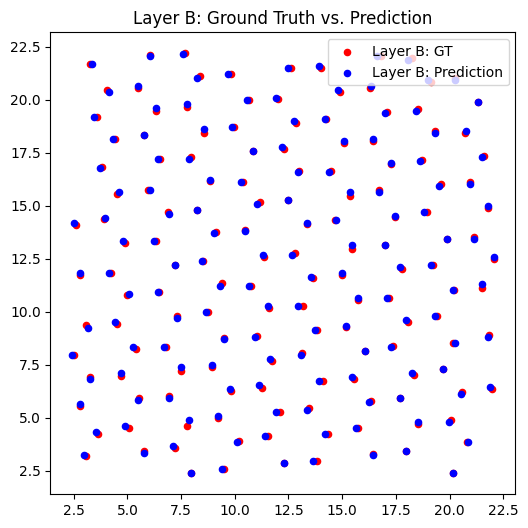

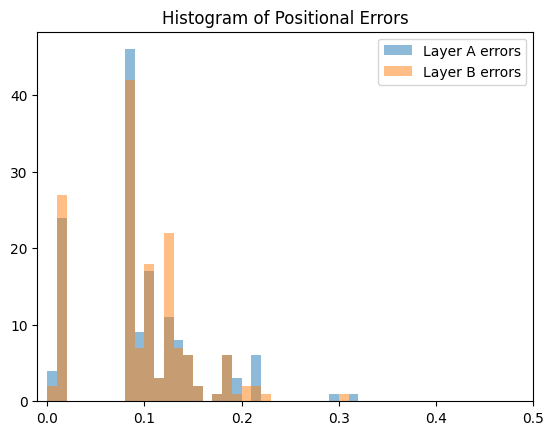

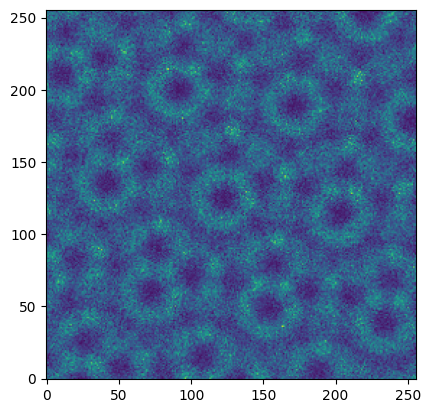

0.275909423828125
GT 2*sigma =  0.07081065342195814
Total positional error for Layer A with prediction[1]: 0.13043806277940165
Total positional error for Layer A with prediction[0]: 0.28949603168177646
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.1012229192079972
Average positional error for both layers: 0.11583049099369942


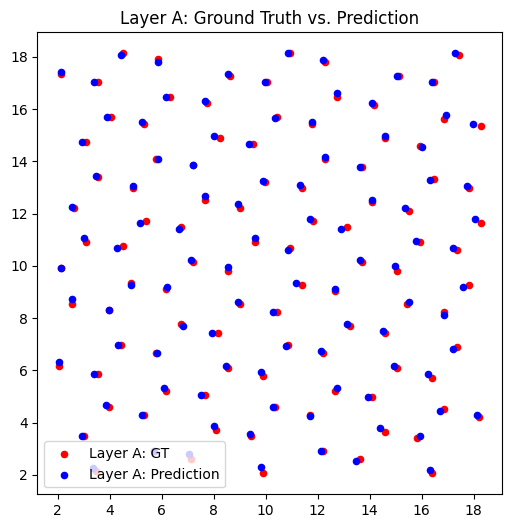

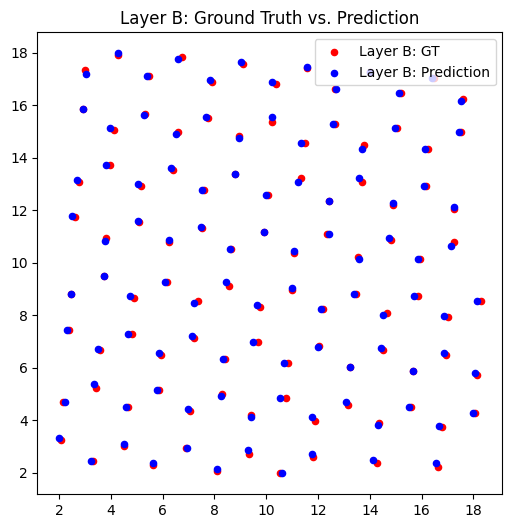

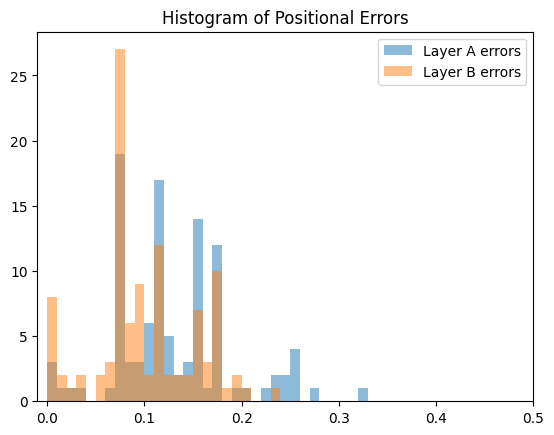

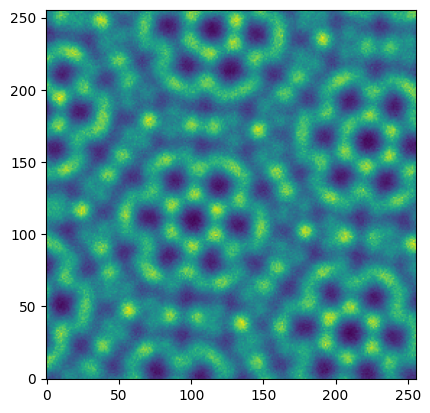

0.09267425537109375
GT 2*sigma =  0.09255993437785726
Total positional error for Layer A with prediction[1]: 0.3239806945288913
Total positional error for Layer A with prediction[0]: 0.08656534426048569
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.0797618681648739
Average positional error for both layers: 0.08316360621267979


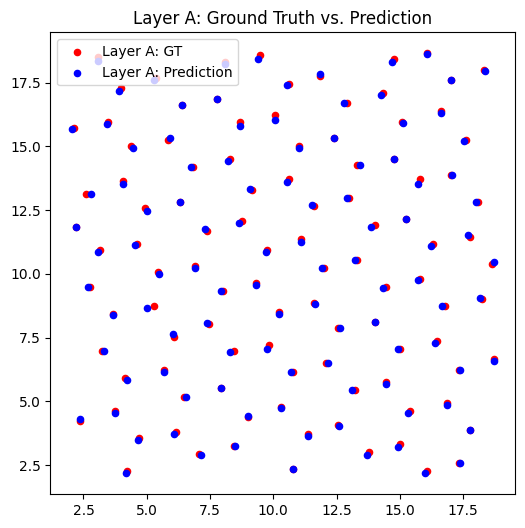

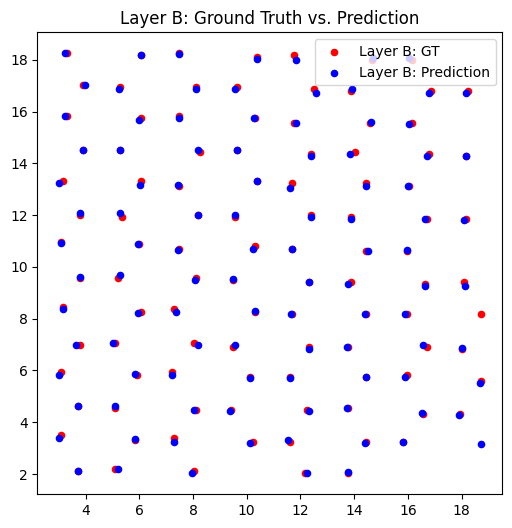

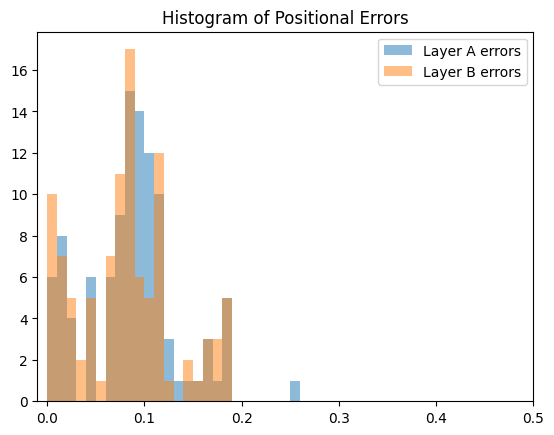

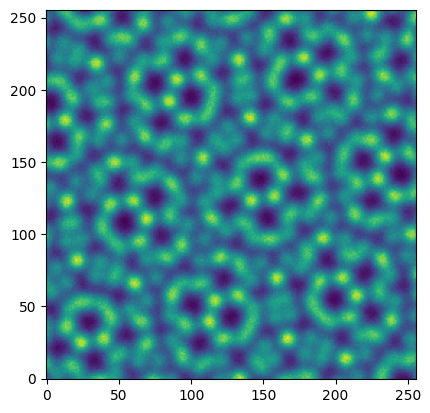

0.29363250732421875
GT 2*sigma =  0.0684674893189155
Total positional error for Layer A with prediction[1]: 0.08102745958134809
Total positional error for Layer A with prediction[0]: 0.30412753827983635
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.0771063660510257
Average positional error for both layers: 0.07906691281618689


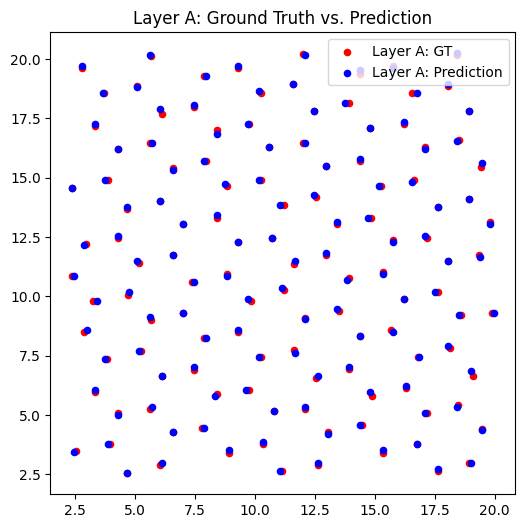

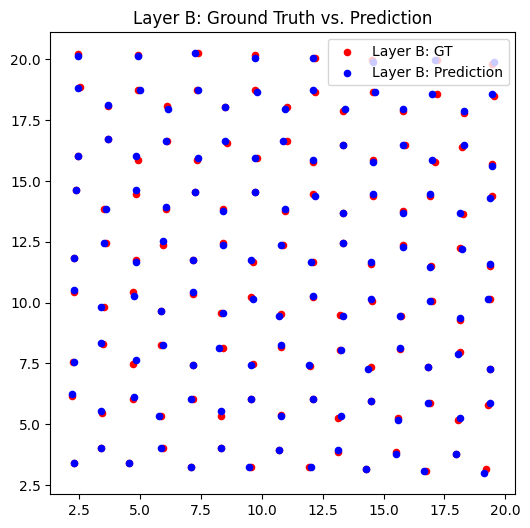

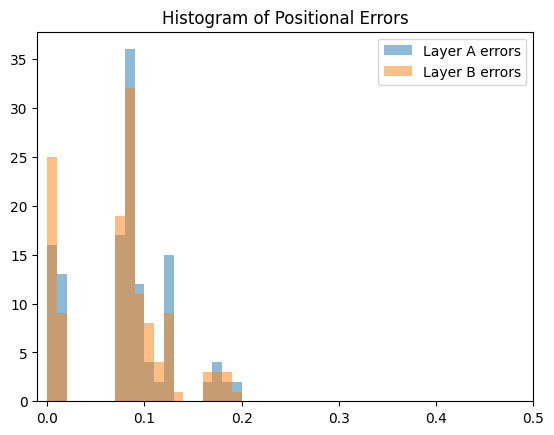

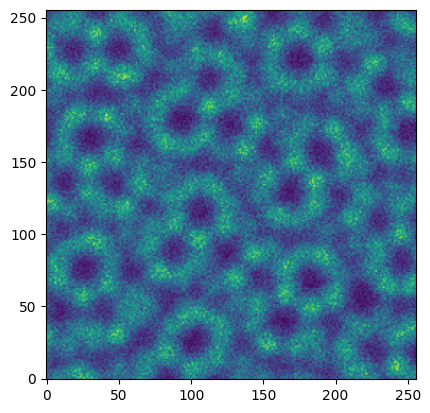

0.127288818359375
GT 2*sigma =  0.08531128263407015
Total positional error for Layer A with prediction[1]: 0.29961464401721233
Total positional error for Layer A with prediction[0]: 0.16948651594526748
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.17100040888707208
Average positional error for both layers: 0.17024346241616978


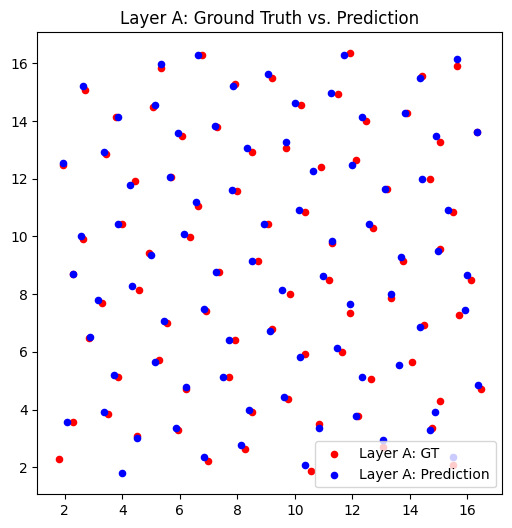

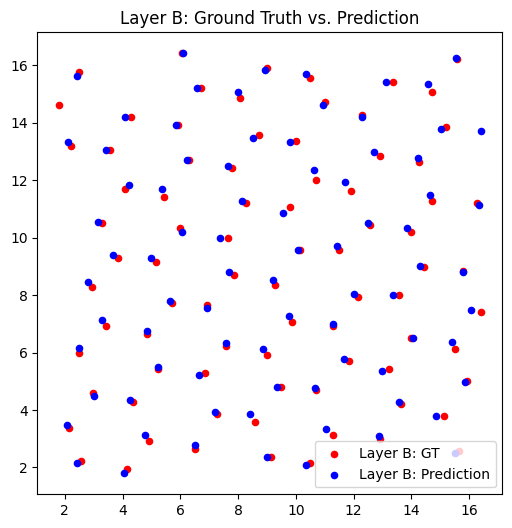

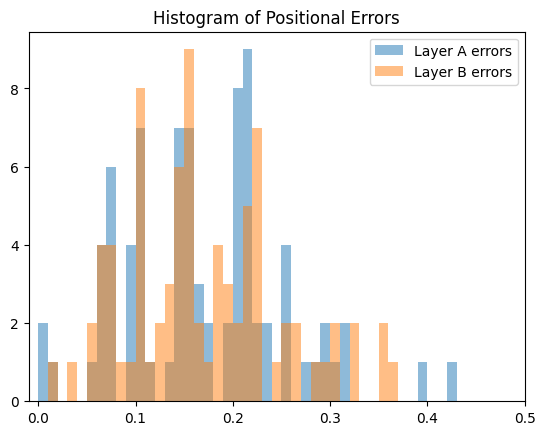

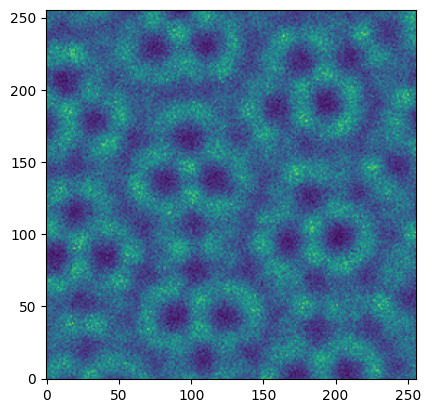

0.12577056884765625
GT 2*sigma =  0.10640720014714936
Total positional error for Layer A with prediction[1]: 0.32402627694754393
Total positional error for Layer A with prediction[0]: 0.13988155605226477
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.15220124758339706
Average positional error for both layers: 0.14604140181783093


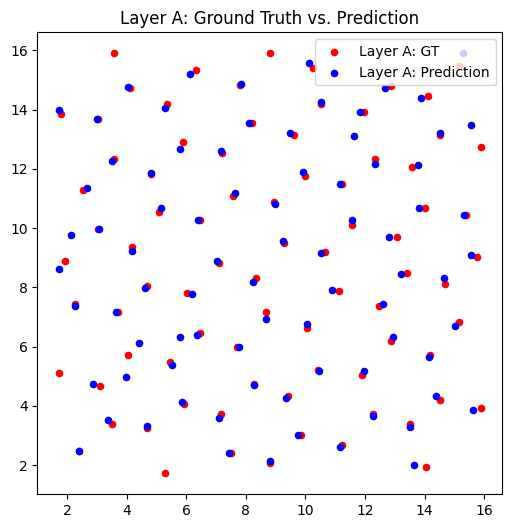

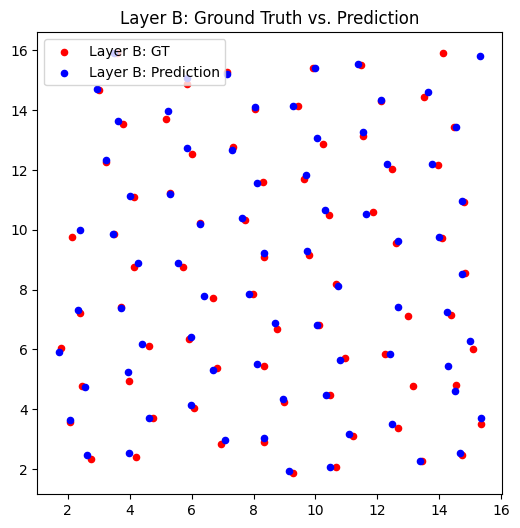

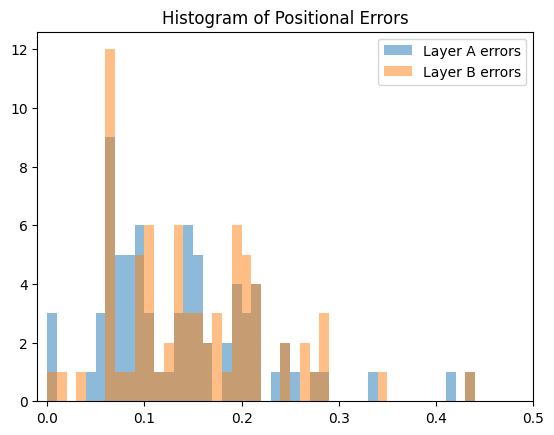

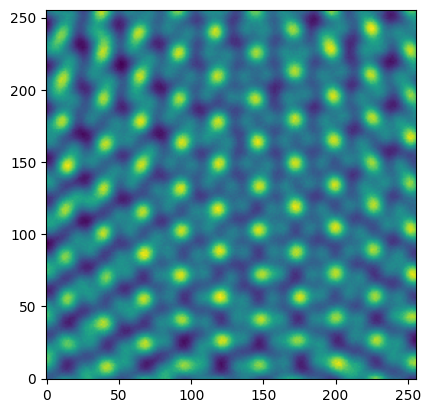

0.1185455322265625
GT 2*sigma =  0.09997236450861882
Total positional error for Layer A with prediction[1]: 0.18977828072736147
Total positional error for Layer A with prediction[0]: 0.12312692981763272
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.1251959261391775
Average positional error for both layers: 0.1241614279784051


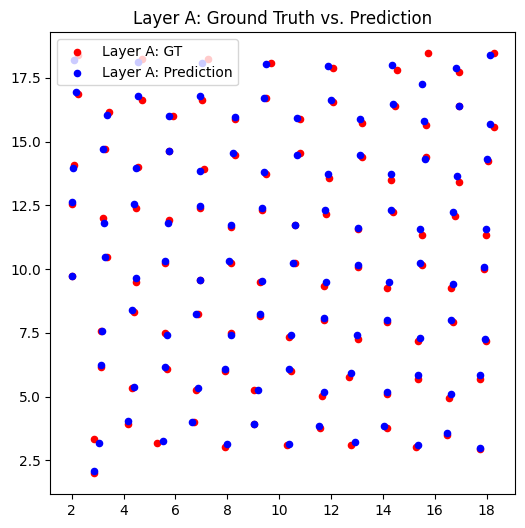

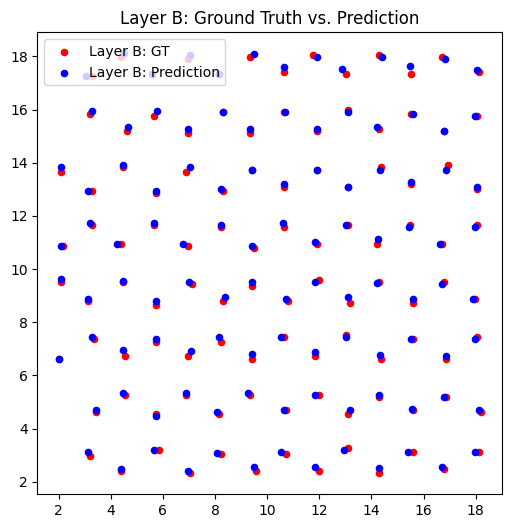

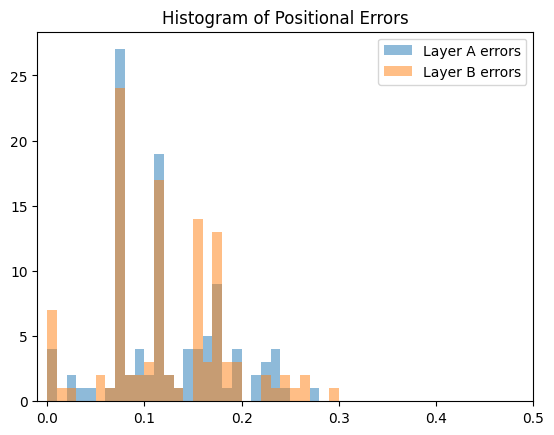

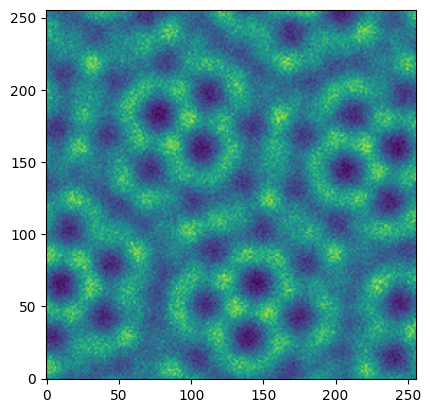

0.30083465576171875
GT 2*sigma =  0.06425939005536864
Total positional error for Layer A with prediction[1]: 0.07538154179165393
Total positional error for Layer A with prediction[0]: 0.28635224888155913
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.08291463922376038
Average positional error for both layers: 0.07914809050770716


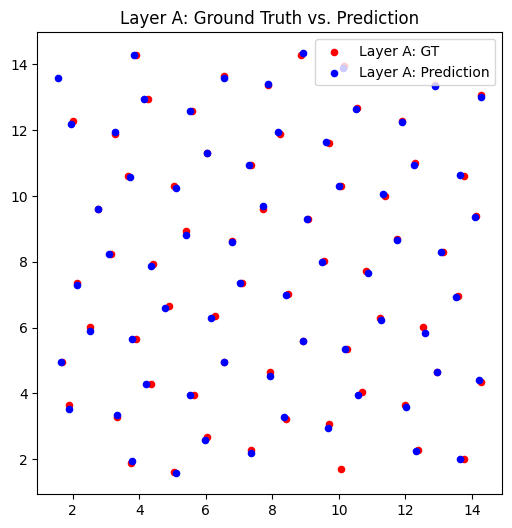

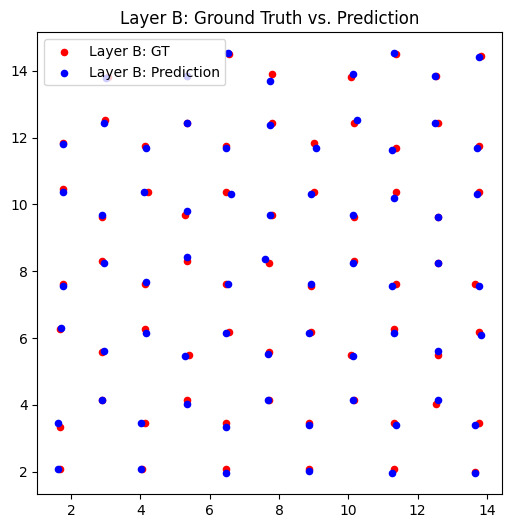

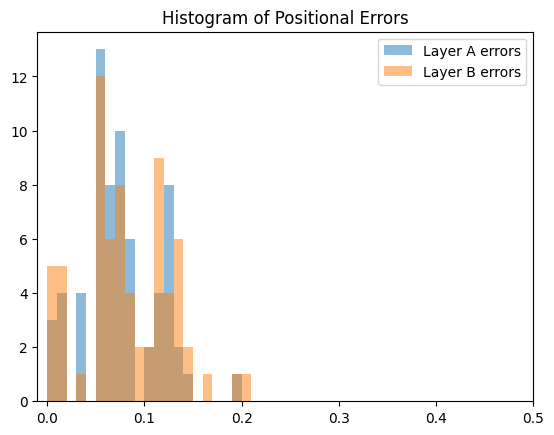

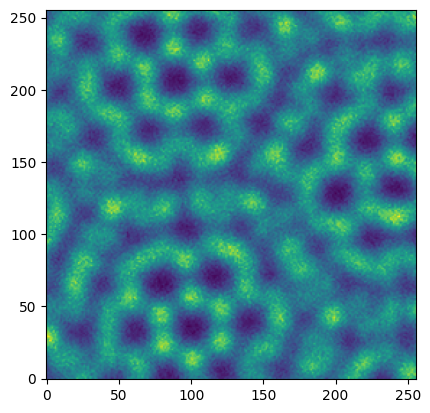

0.169677734375
GT 2*sigma =  0.11787196138996797
Total positional error for Layer A with prediction[1]: 0.2749721084729094
Total positional error for Layer A with prediction[0]: 0.18117729907770805
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.22182479699824492
Average positional error for both layers: 0.20150104803797647


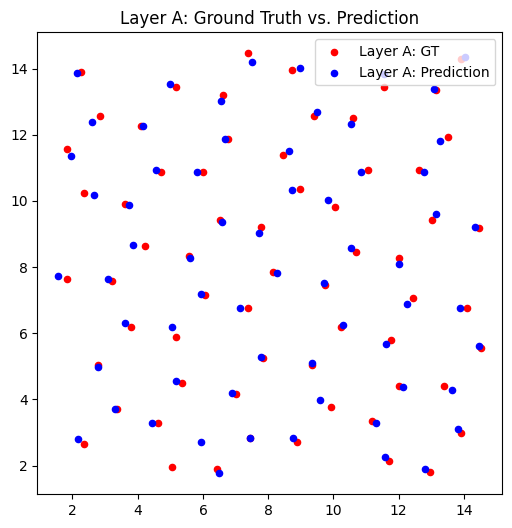

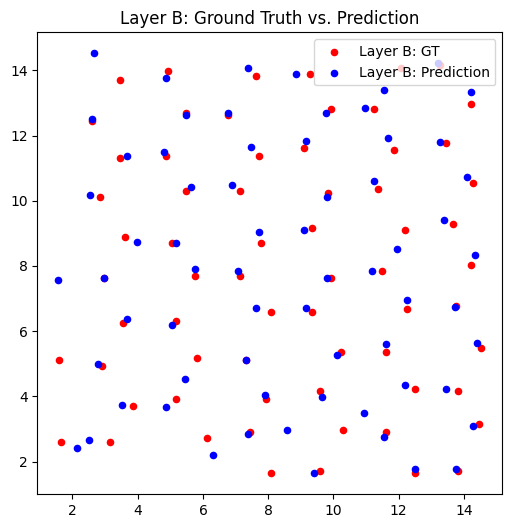

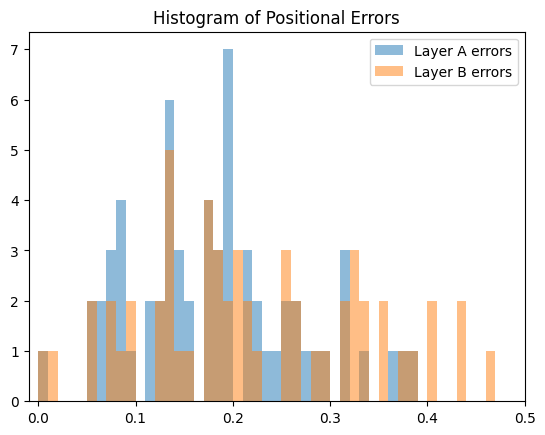

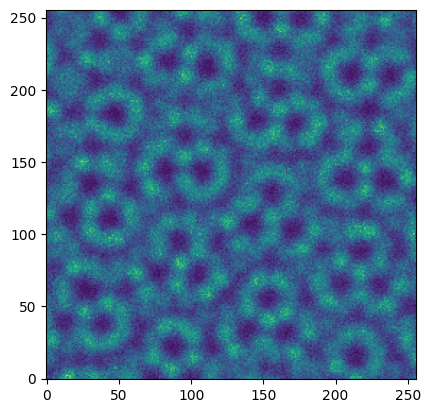

0.09627532958984375
GT 2*sigma =  0.12144388835796543
Total positional error for Layer A with prediction[1]: 0.31234452045134603
Total positional error for Layer A with prediction[0]: 0.12057736697464491
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.10074715403179889
Average positional error for both layers: 0.1106622605032219


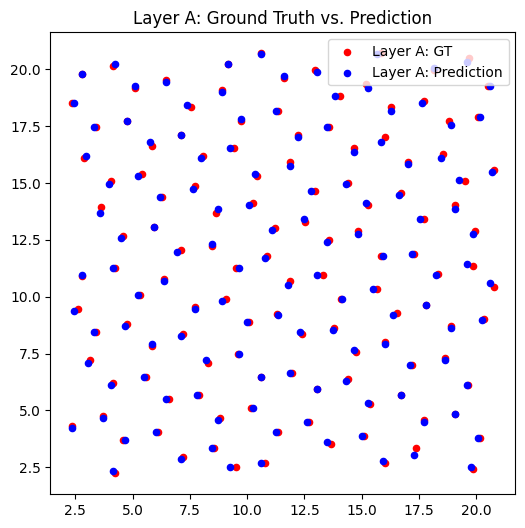

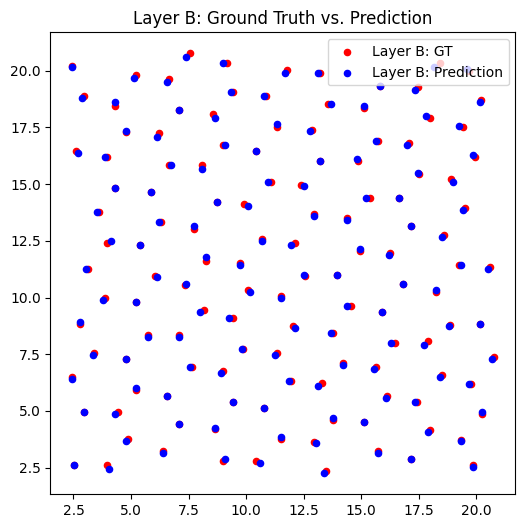

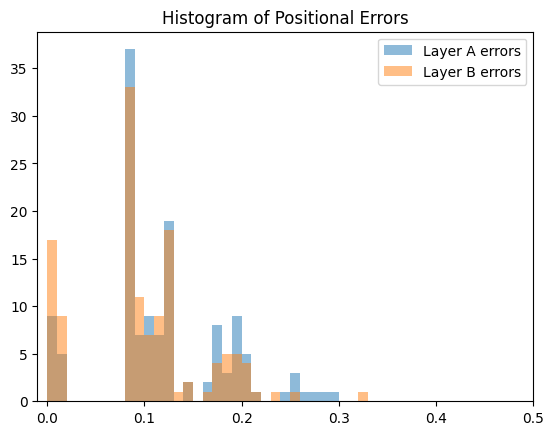

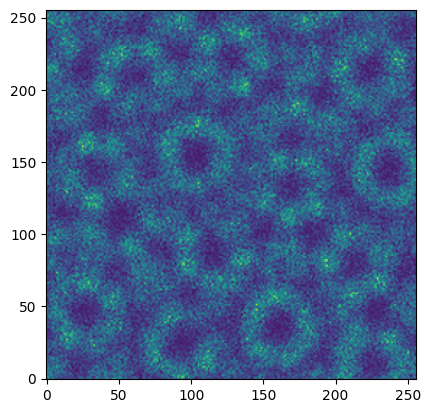

0.172821044921875
GT 2*sigma =  0.1310682330639194
Total positional error for Layer A with prediction[1]: 0.24560448128114698
Total positional error for Layer A with prediction[0]: 0.22706953407089137
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.2801530133037064
Average positional error for both layers: 0.25361127368729885


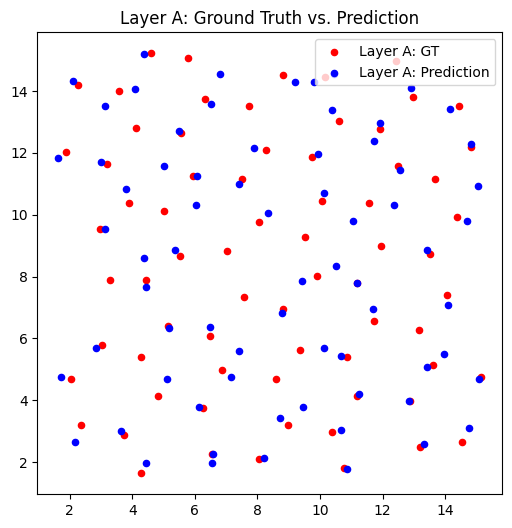

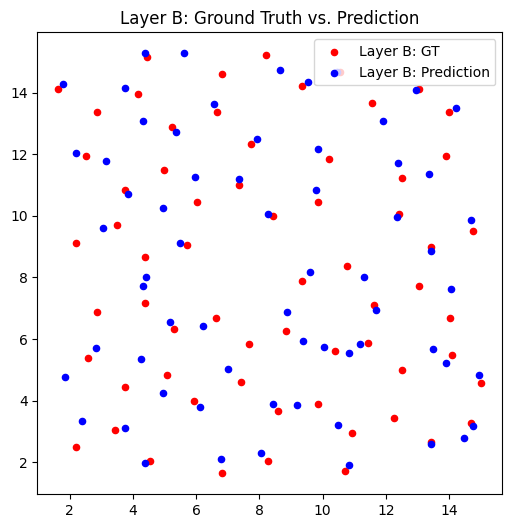

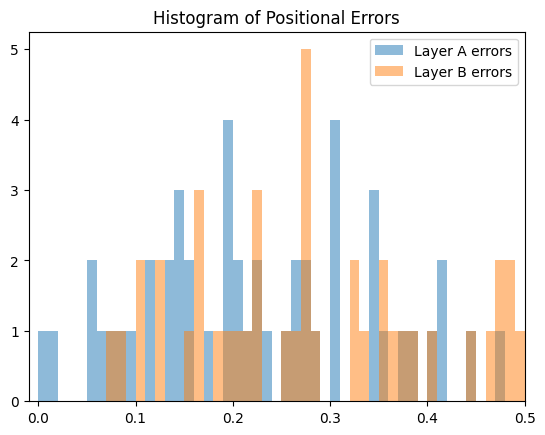

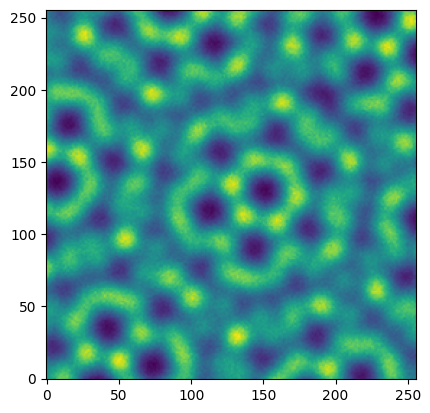

0.10402679443359375
GT 2*sigma =  0.06837731628122515
Total positional error for Layer A with prediction[1]: 0.2770980269080011
Total positional error for Layer A with prediction[0]: 0.11093572667743981
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.10037281927316702
Average positional error for both layers: 0.10565427297530341


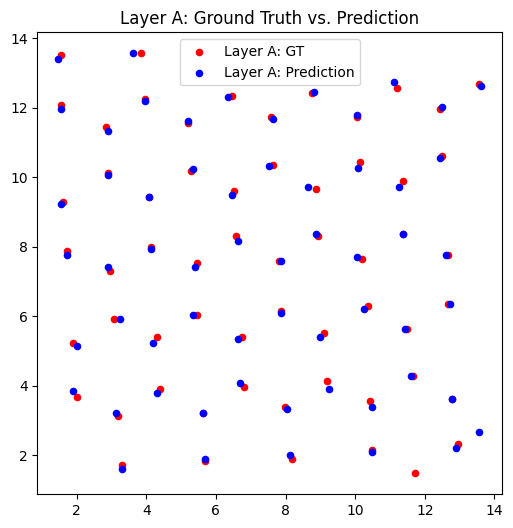

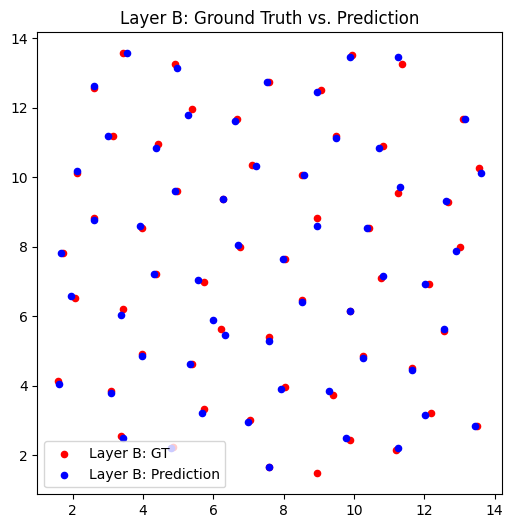

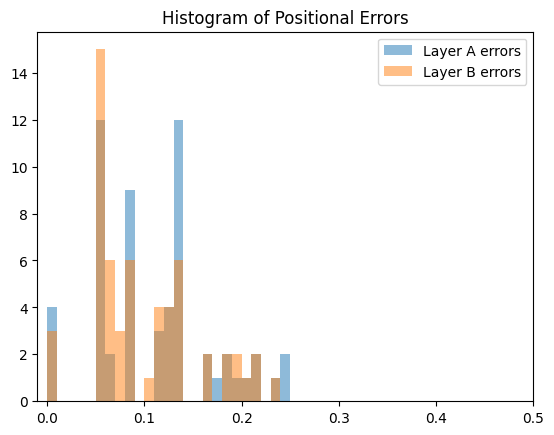

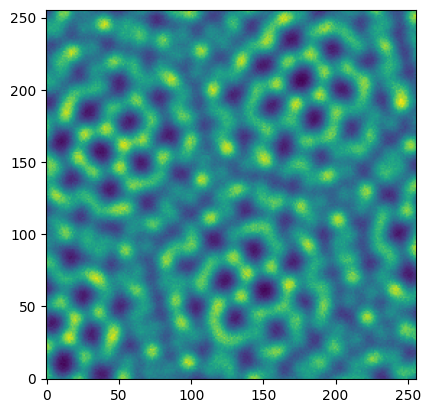

0.099609375
GT 2*sigma =  0.12153584599993042
Total positional error for Layer A with prediction[1]: 0.31086196690712387
Total positional error for Layer A with prediction[0]: 0.09324467612788764
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.09166772008984478
Average positional error for both layers: 0.09245619810886621


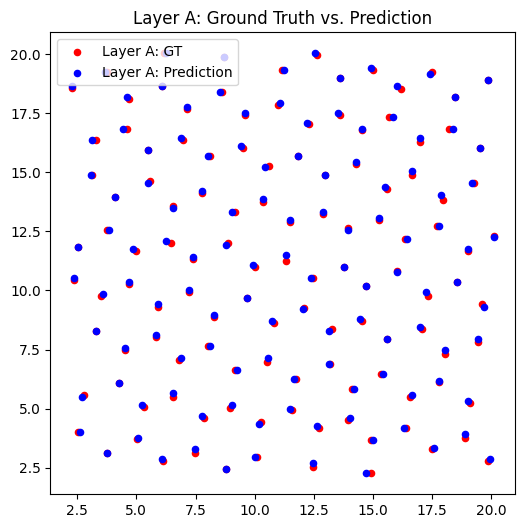

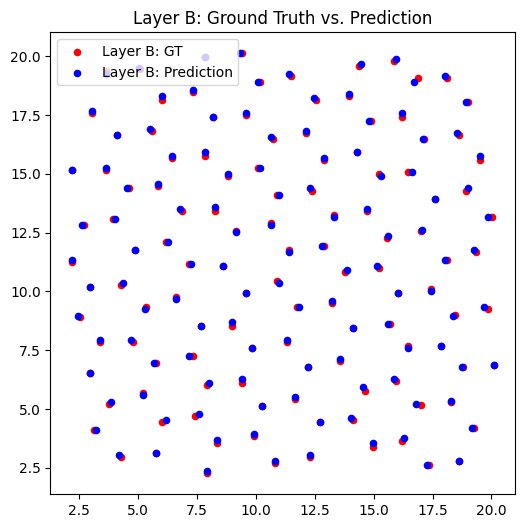

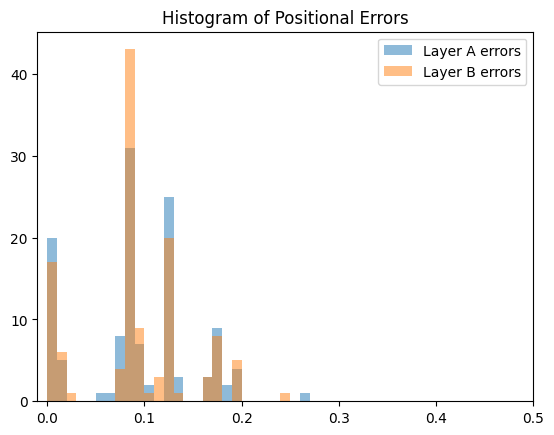

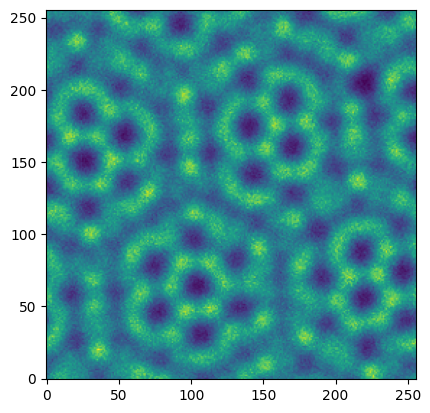

0.2544708251953125
GT 2*sigma =  0.07480683099400055
Total positional error for Layer A with prediction[1]: 0.1371749914950637
Total positional error for Layer A with prediction[0]: 0.24513610600898134
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.12519600972872438
Average positional error for both layers: 0.13118550061189405


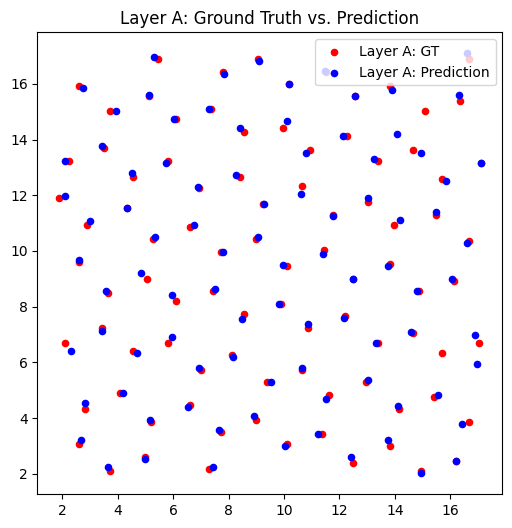

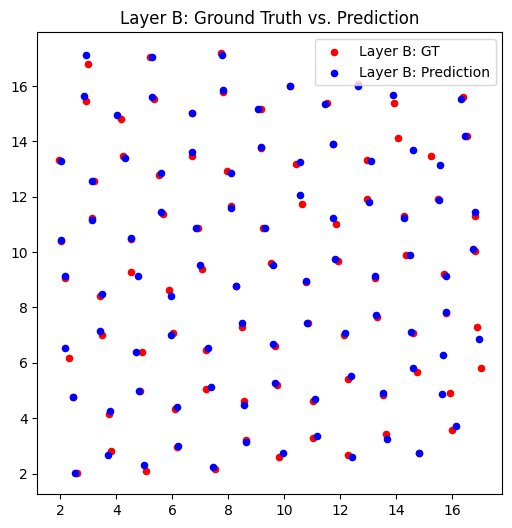

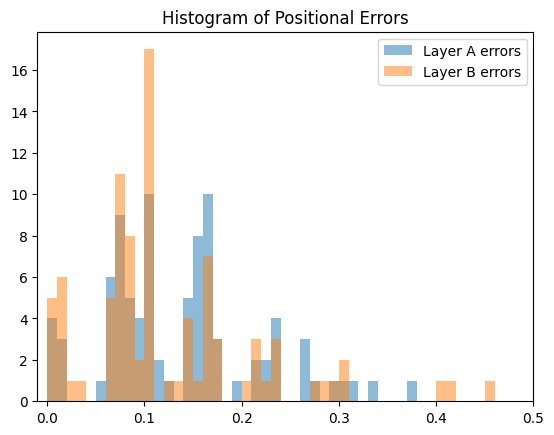

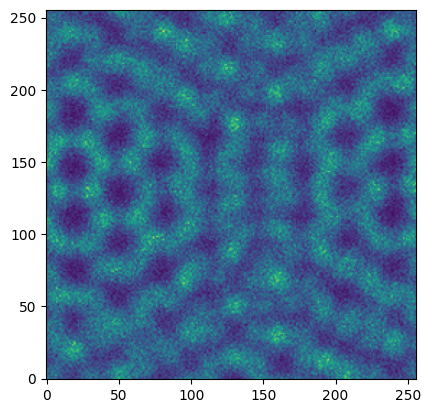

0.20183563232421875
GT 2*sigma =  0.14944377845329643
Total positional error for Layer A with prediction[1]: 0.18412293256194442
Total positional error for Layer A with prediction[0]: 0.23784267578705756
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.1870596541795743
Average positional error for both layers: 0.18559129337075936


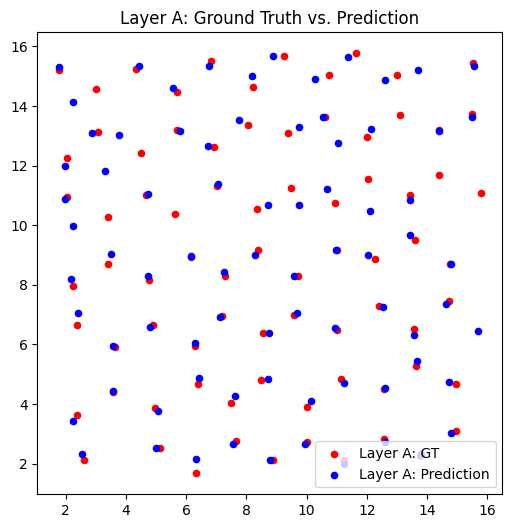

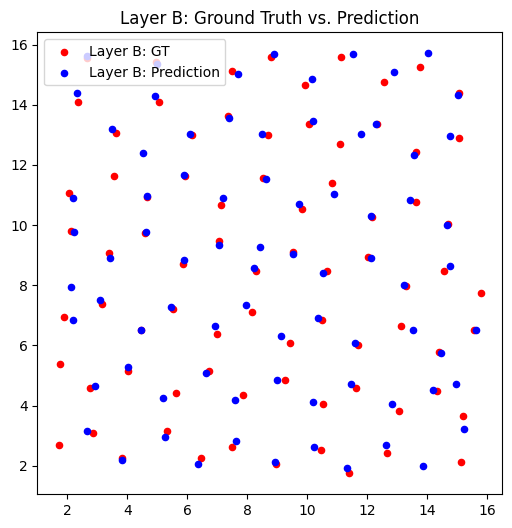

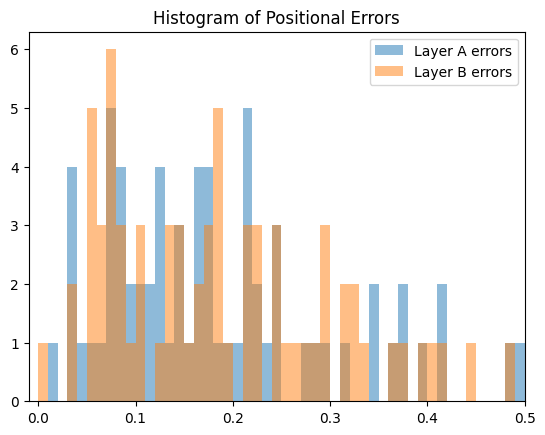

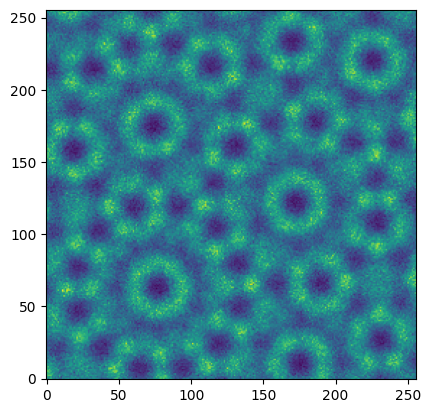

0.19812774658203125
GT 2*sigma =  0.05851034445959935
Total positional error for Layer A with prediction[1]: 0.20576924379709458
Total positional error for Layer A with prediction[0]: 0.22178571292755014
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.1774040042971657
Average positional error for both layers: 0.19158662404713014


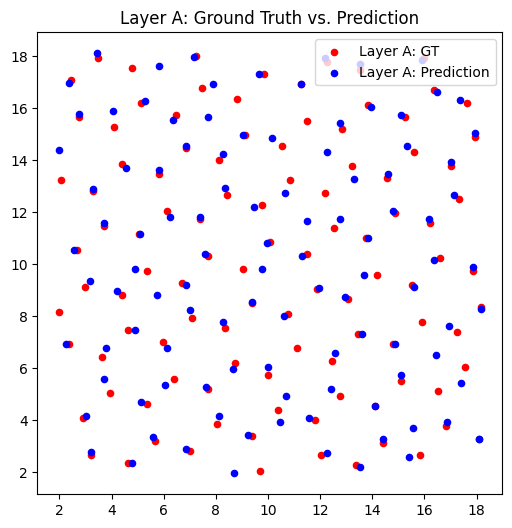

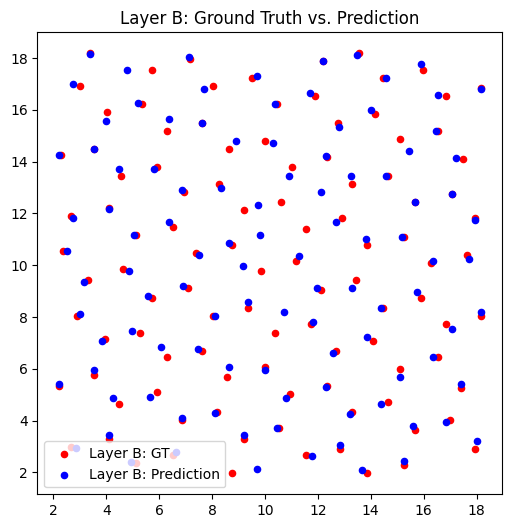

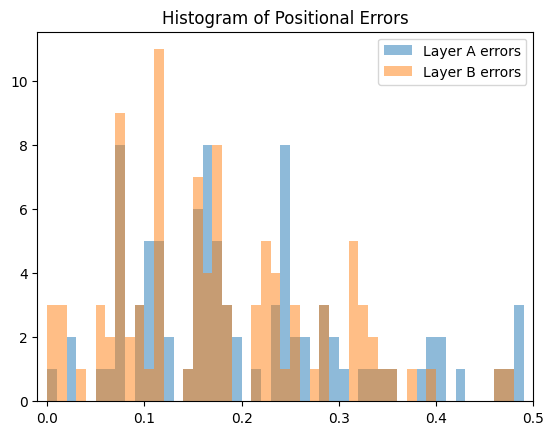

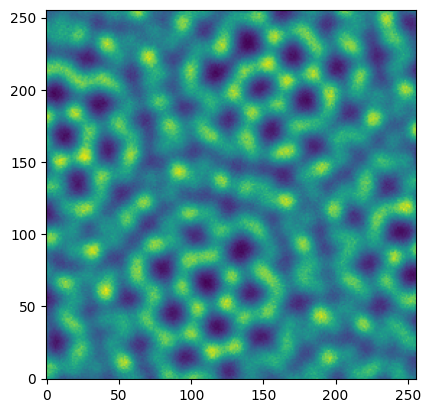

0.1108245849609375
GT 2*sigma =  0.12981110543890734
Total positional error for Layer A with prediction[1]: 0.29935149338222633
Total positional error for Layer A with prediction[0]: 0.1383763719739418
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.12776015348745987
Average positional error for both layers: 0.13306826273070083


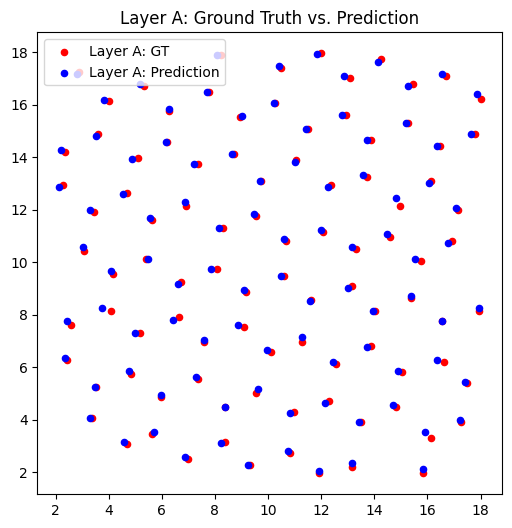

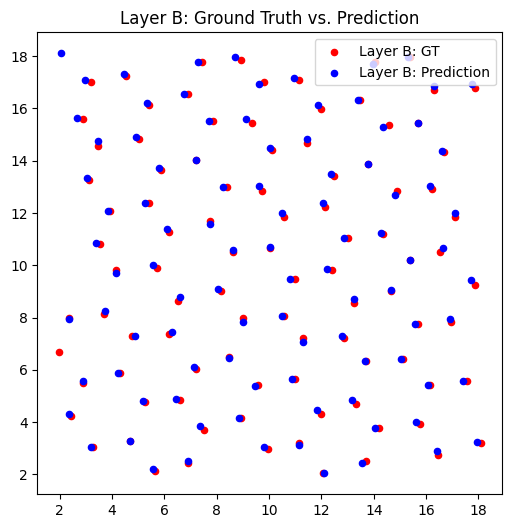

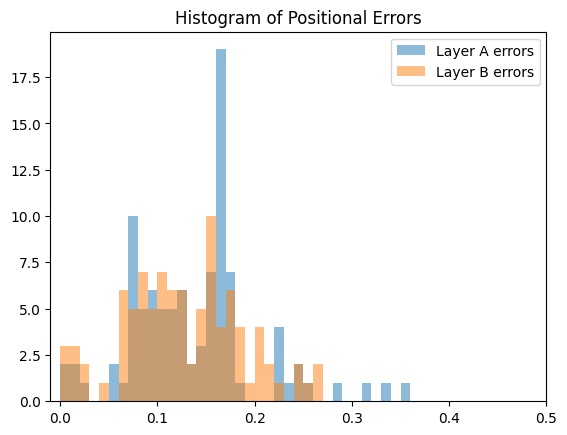

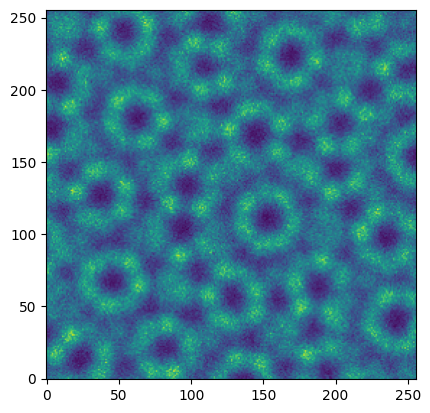

0.29576873779296875
GT 2*sigma =  0.12392336161567831
Total positional error for Layer A with prediction[1]: 0.098195858105754
Total positional error for Layer A with prediction[0]: 0.3278446733314201
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.09750478801049146
Average positional error for both layers: 0.09785032305812273


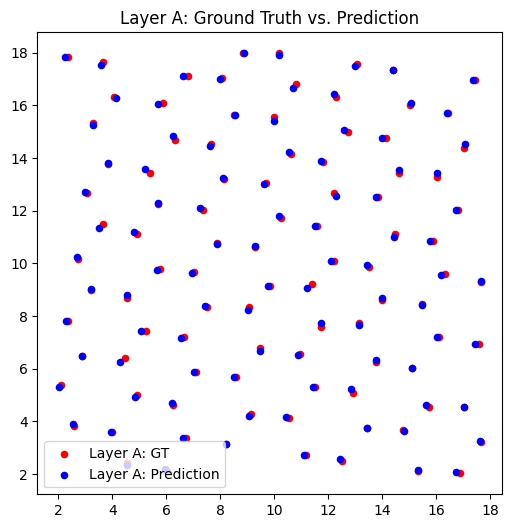

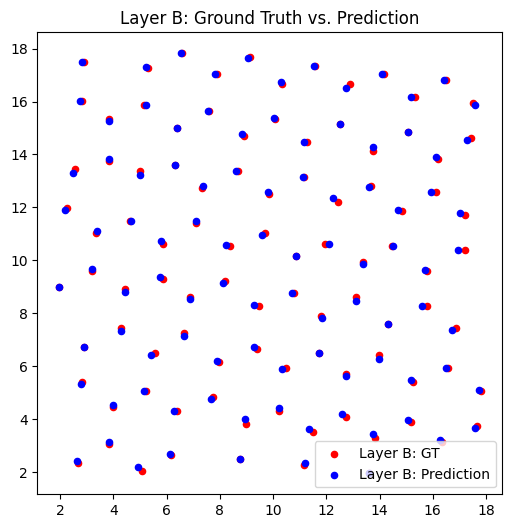

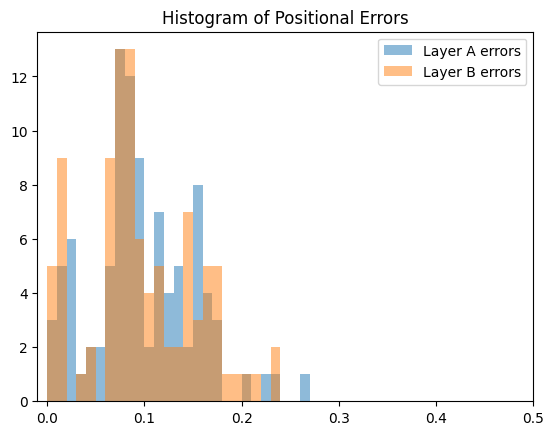

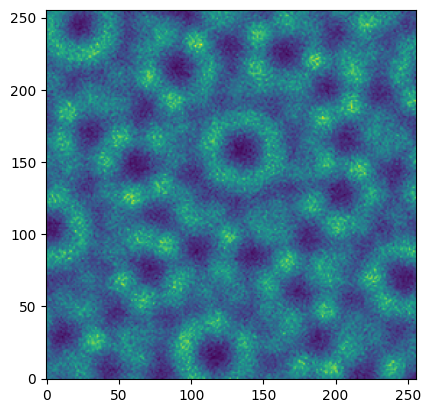

0.24913787841796875
GT 2*sigma =  0.12358019505266346
Total positional error for Layer A with prediction[1]: 0.147054116977799
Total positional error for Layer A with prediction[0]: 0.2617120008998882
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.14799593760444876
Average positional error for both layers: 0.14752502729112388


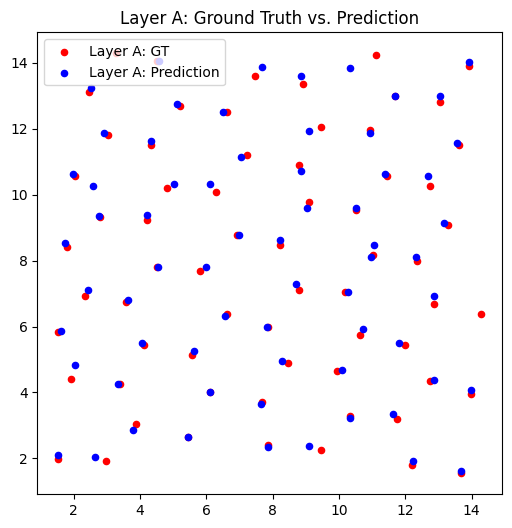

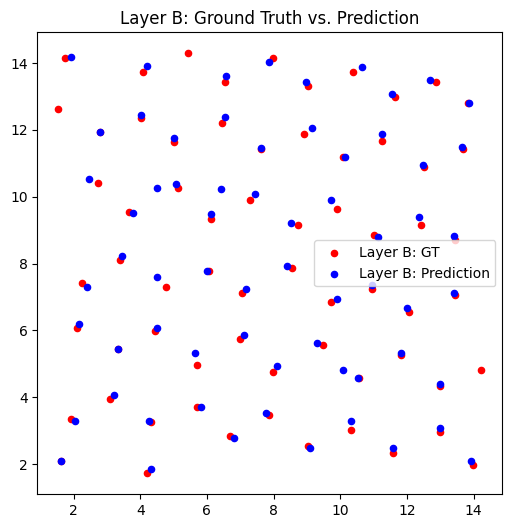

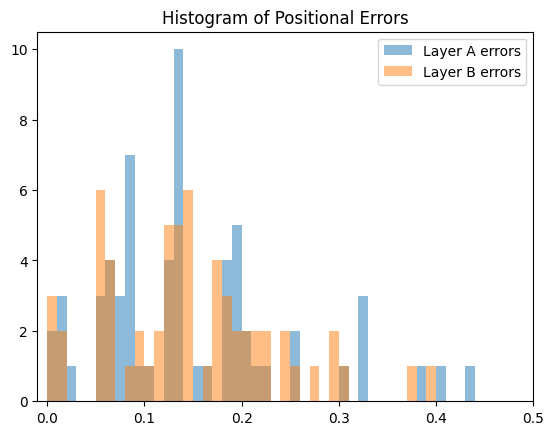

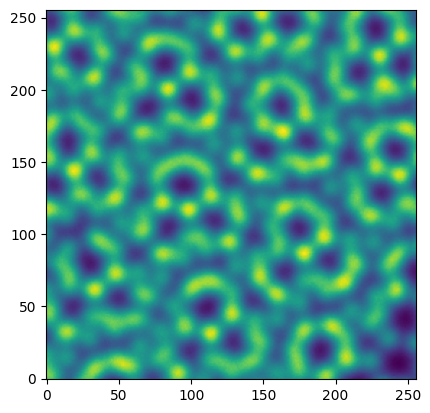

0.300384521484375
GT 2*sigma =  0.10072750802719453
Total positional error for Layer A with prediction[1]: 0.09187693915004033
Total positional error for Layer A with prediction[0]: 0.3269444407448969
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.08712458218086419
Average positional error for both layers: 0.08950076066545226


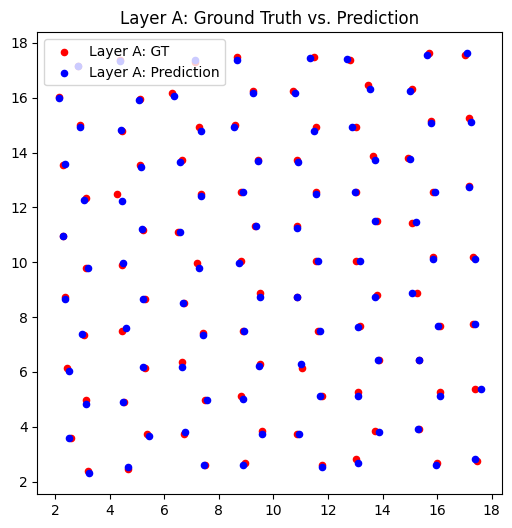

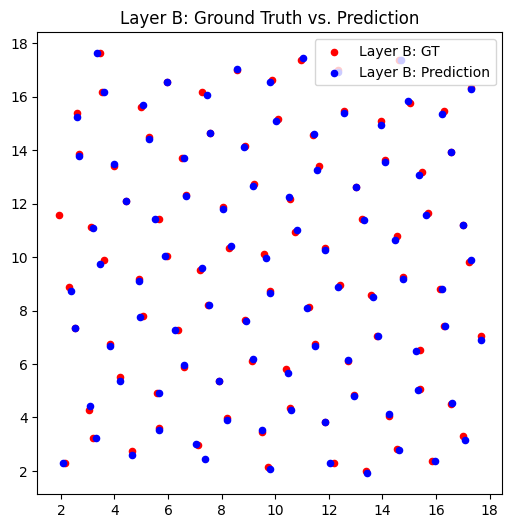

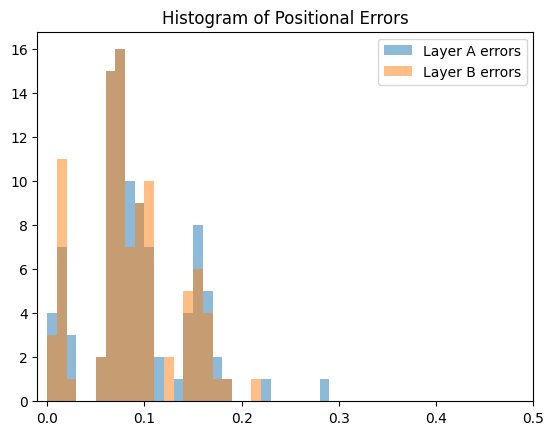

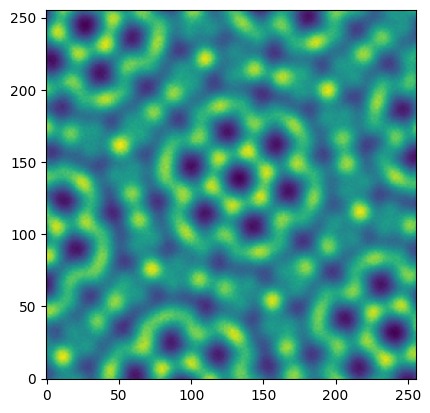

0.0996856689453125
GT 2*sigma =  0.07790440644656542
Total positional error for Layer A with prediction[1]: 0.30220558873797265
Total positional error for Layer A with prediction[0]: 0.09967200721334395
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.08925661927778357
Average positional error for both layers: 0.09446431324556376


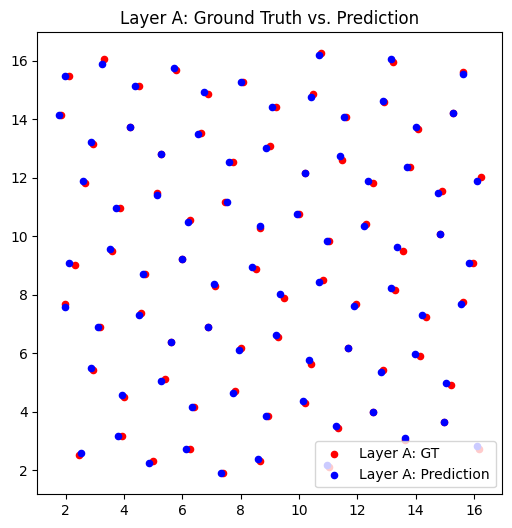

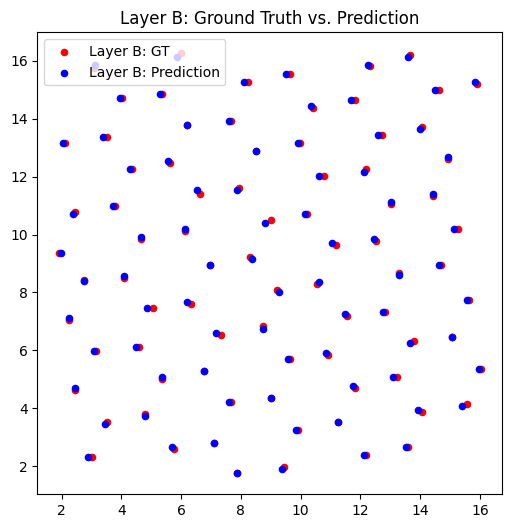

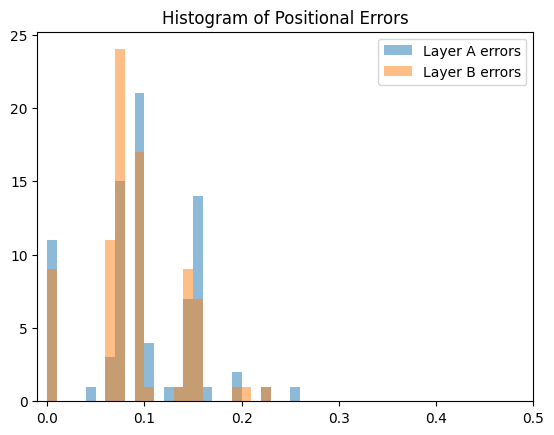

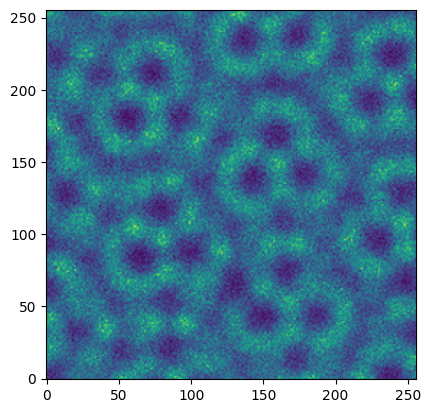

0.121612548828125
GT 2*sigma =  0.09445028976363448
Total positional error for Layer A with prediction[1]: 0.30594204432348115
Total positional error for Layer A with prediction[0]: 0.13896141938726655
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.12347967088095582
Average positional error for both layers: 0.1312205451341112


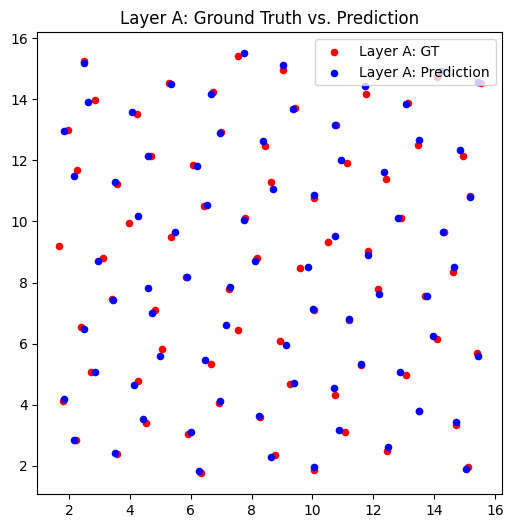

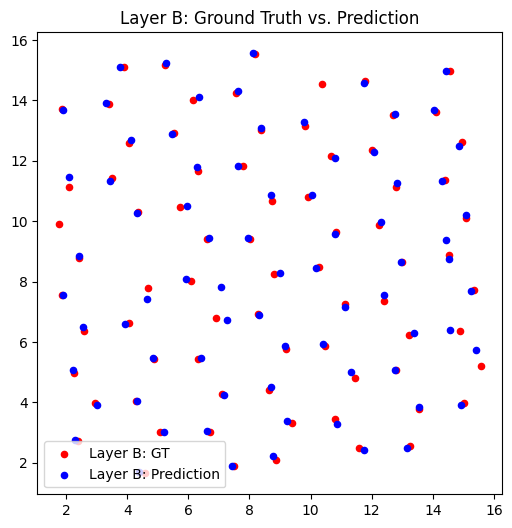

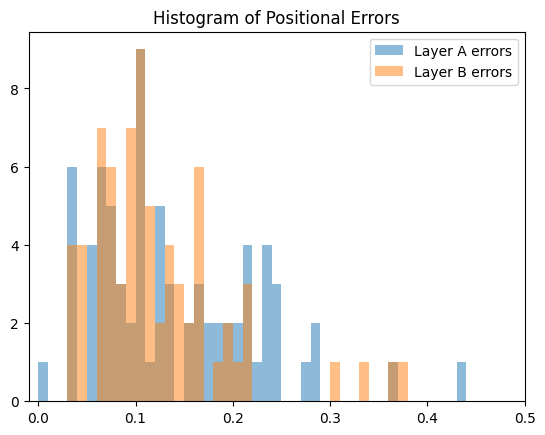

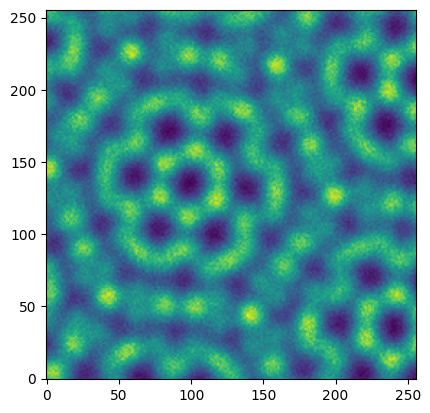

0.11484527587890625
GT 2*sigma =  0.06430901518509051
Total positional error for Layer A with prediction[1]: 0.2692137936267156
Total positional error for Layer A with prediction[0]: 0.12254968955537673
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.10745744400178305
Average positional error for both layers: 0.1150035667785799


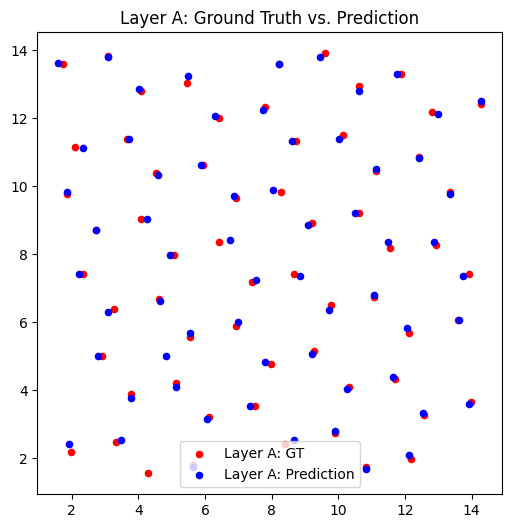

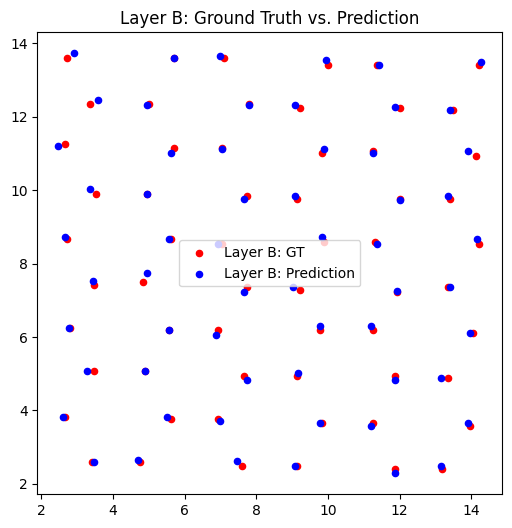

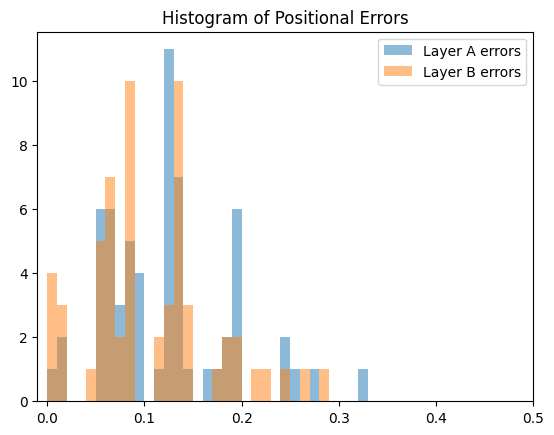

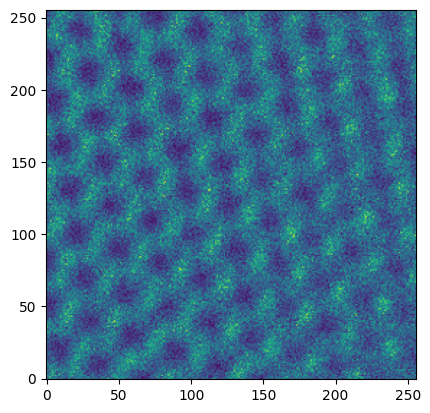

0.2356719970703125
GT 2*sigma =  0.08681048207553181
Total positional error for Layer A with prediction[1]: 0.22190394976379818
Total positional error for Layer A with prediction[0]: 0.2598584958189369
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.22059635126876245
Average positional error for both layers: 0.22125015051628033


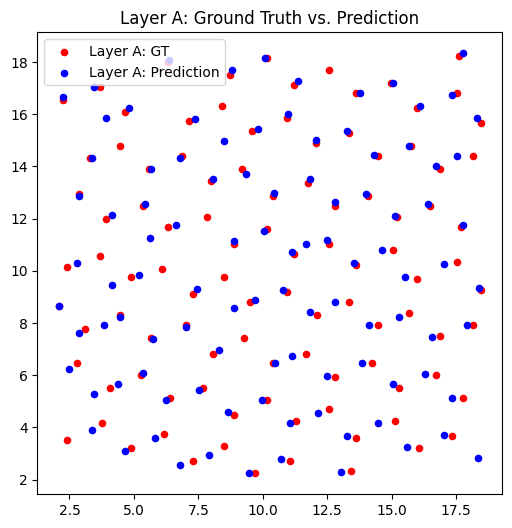

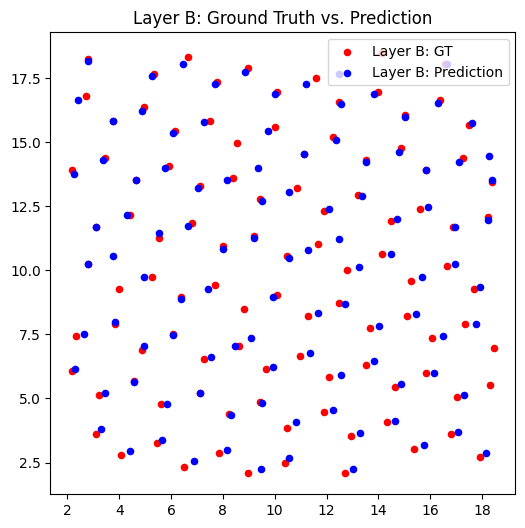

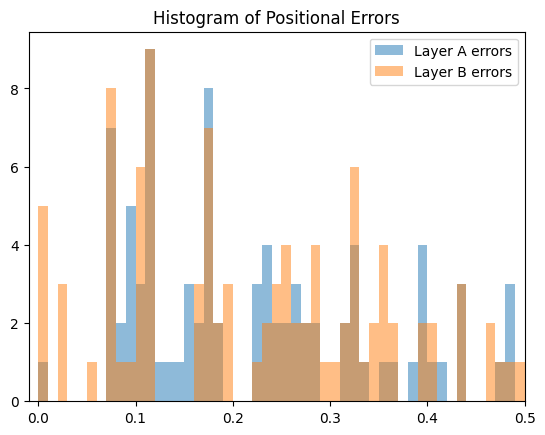

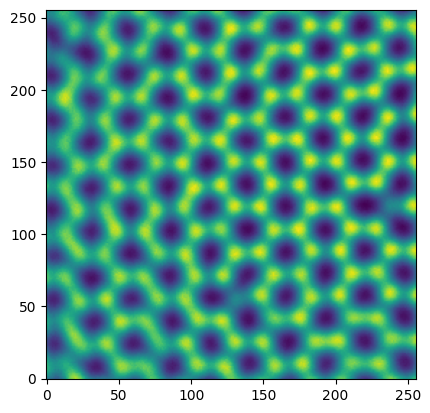

0.13564300537109375
GT 2*sigma =  0.09041886711858273
Total positional error for Layer A with prediction[1]: 0.17800404210637116
Total positional error for Layer A with prediction[0]: 0.17632622274272133
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.18588494735464478
Average positional error for both layers: 0.18110558504868307


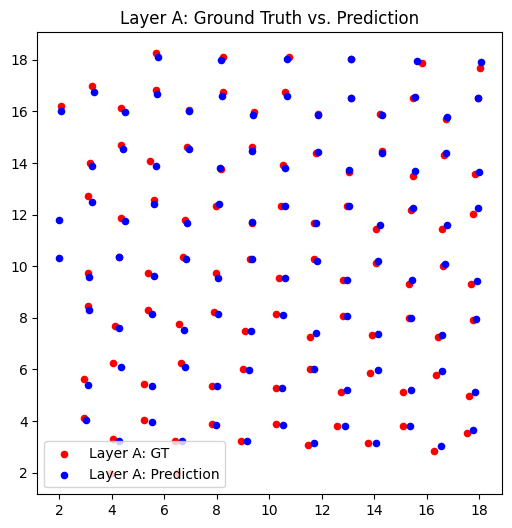

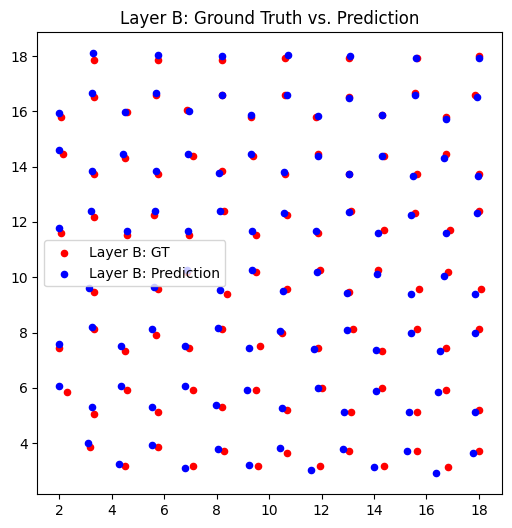

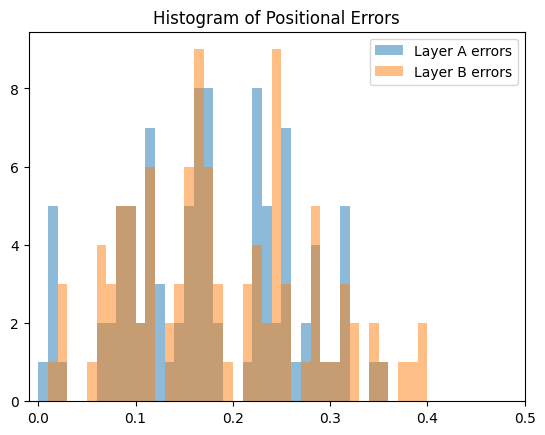

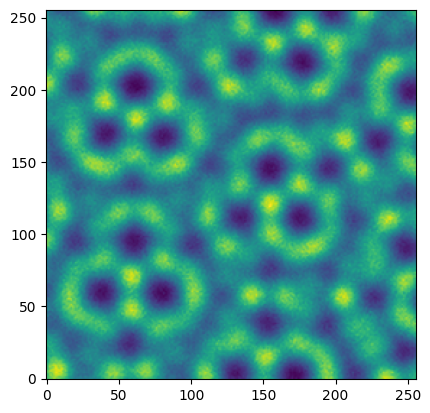

0.13976287841796875
GT 2*sigma =  0.07554516454861276
Total positional error for Layer A with prediction[1]: 0.22857281939123017
Total positional error for Layer A with prediction[0]: 0.14319651298467817
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.1382077396617517
Average positional error for both layers: 0.14070212632321494


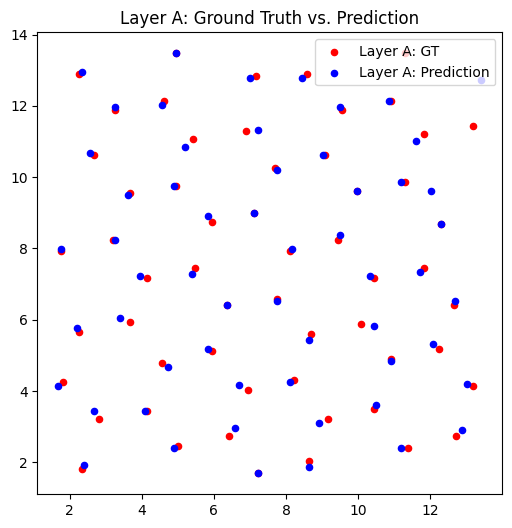

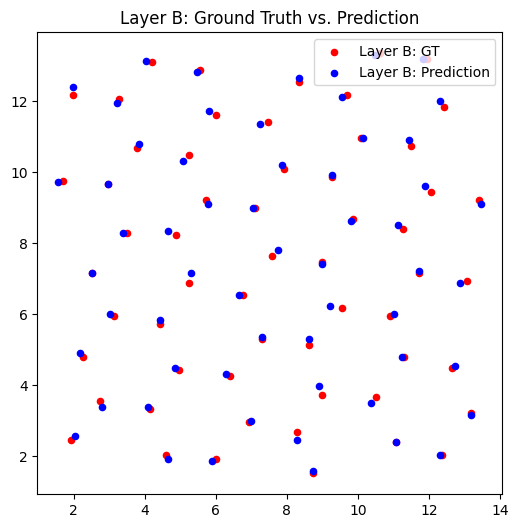

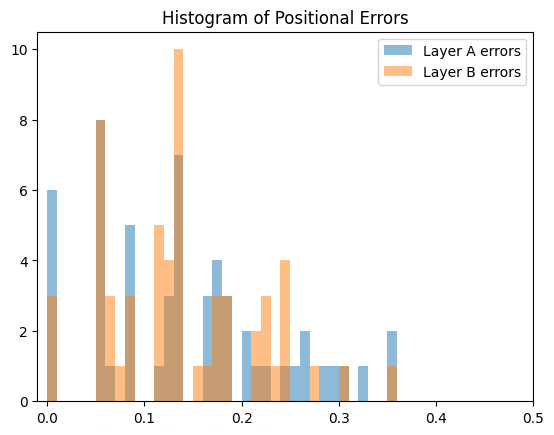

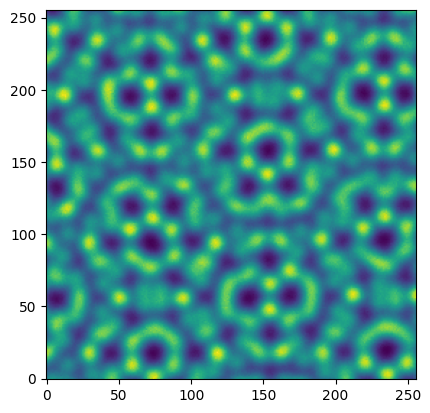

0.29113006591796875
GT 2*sigma =  0.08717365913206657
Total positional error for Layer A with prediction[1]: 0.09481429218698603
Total positional error for Layer A with prediction[0]: 0.30772303599296547
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.09505646493726119
Average positional error for both layers: 0.09493537856212361


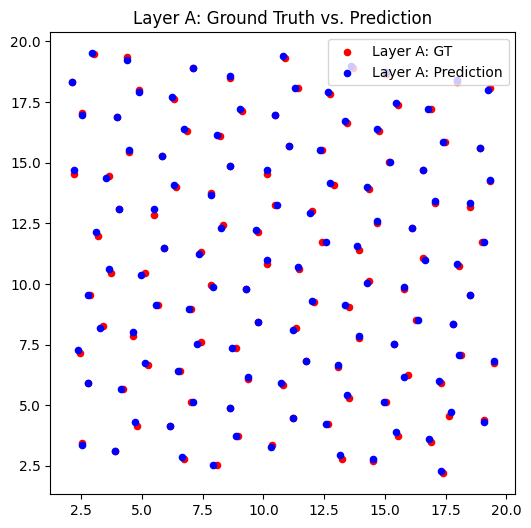

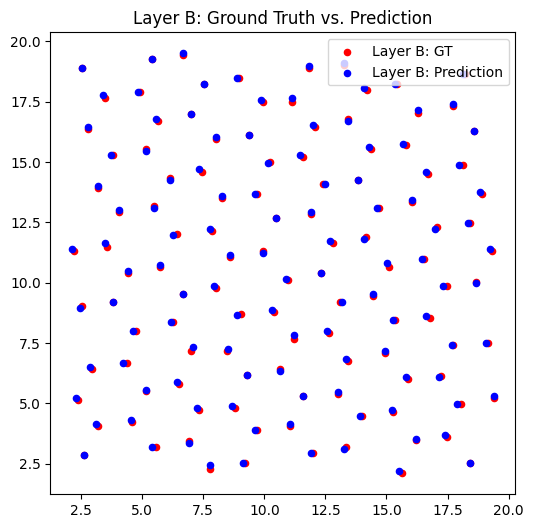

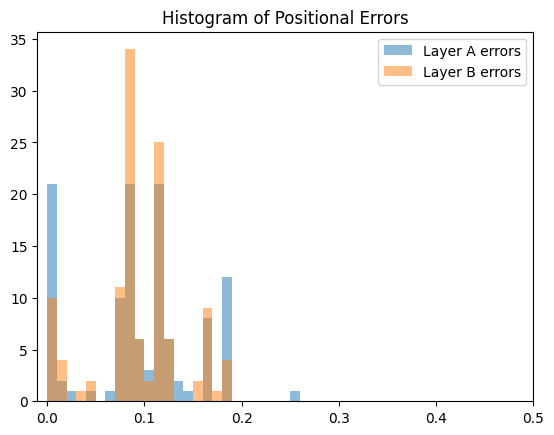

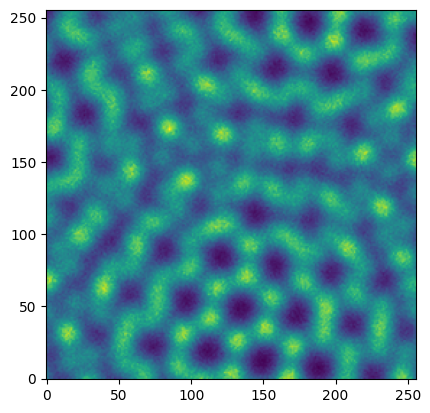

0.252349853515625
GT 2*sigma =  0.11552401835142778
Total positional error for Layer A with prediction[1]: 0.13444264751483292
Total positional error for Layer A with prediction[0]: 0.20522263256935916
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.13911327736231907
Average positional error for both layers: 0.13677796243857598


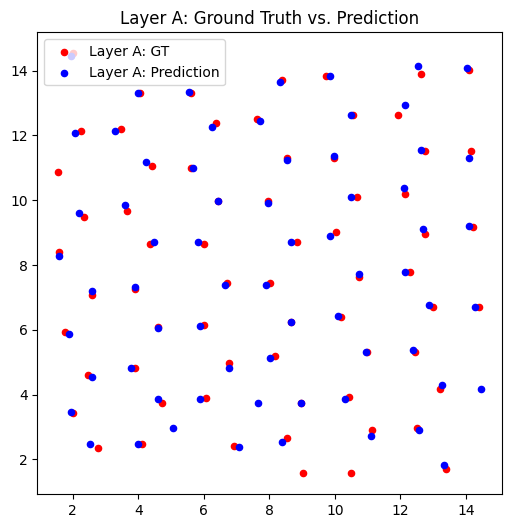

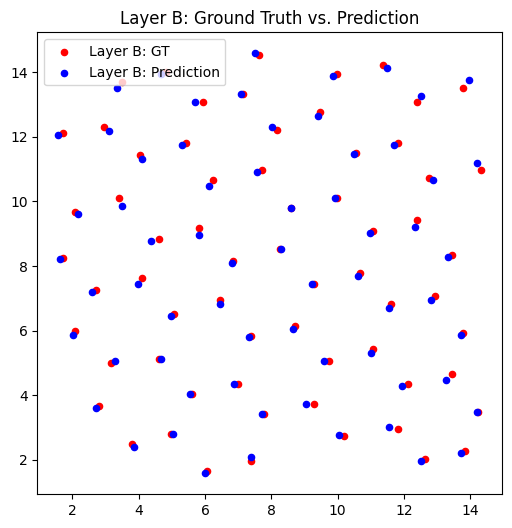

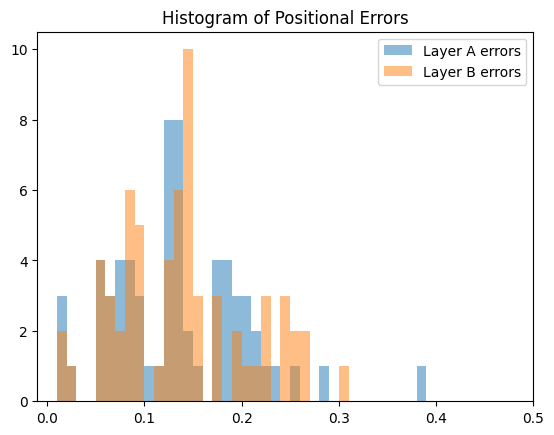

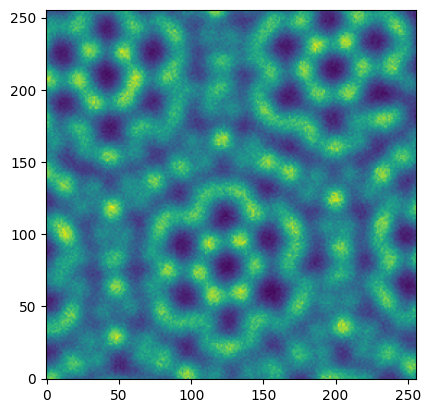

0.16727447509765625
GT 2*sigma =  0.10951338883919531
Total positional error for Layer A with prediction[1]: 0.22913258774859466
Total positional error for Layer A with prediction[0]: 0.17671612344020252
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.19288112804776597
Average positional error for both layers: 0.18479862574398426


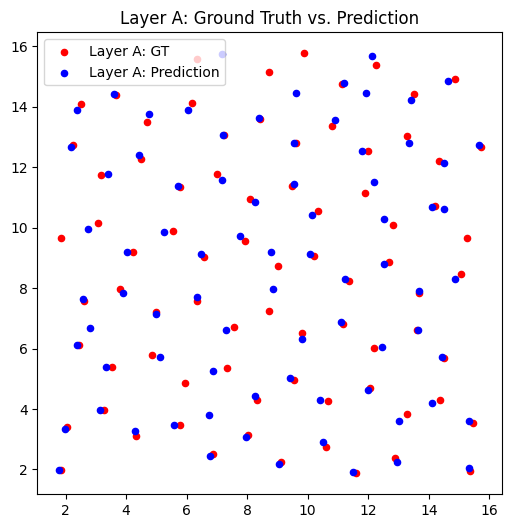

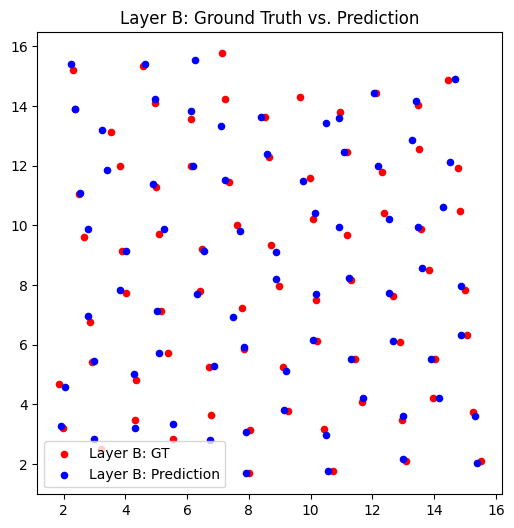

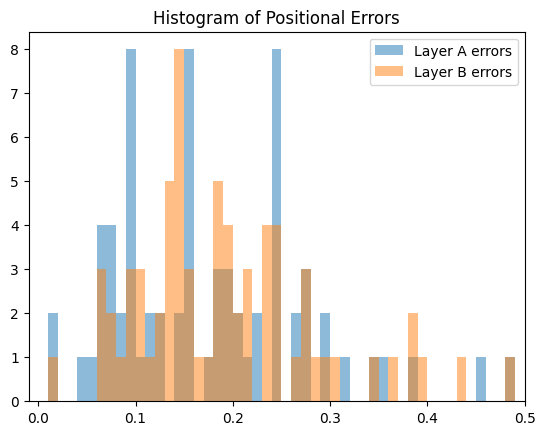

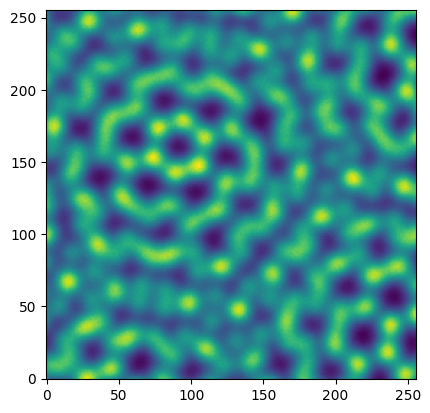

0.2916717529296875
GT 2*sigma =  0.14071487223084167
Total positional error for Layer A with prediction[1]: 0.12556710571404817
Total positional error for Layer A with prediction[0]: 0.29937596354258383
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.11437567971490392
Average positional error for both layers: 0.11997139271447604


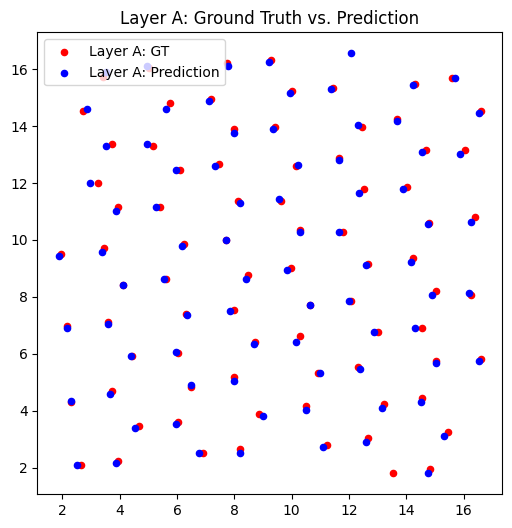

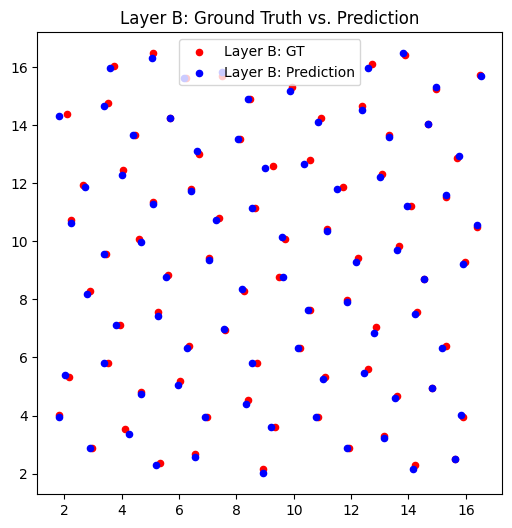

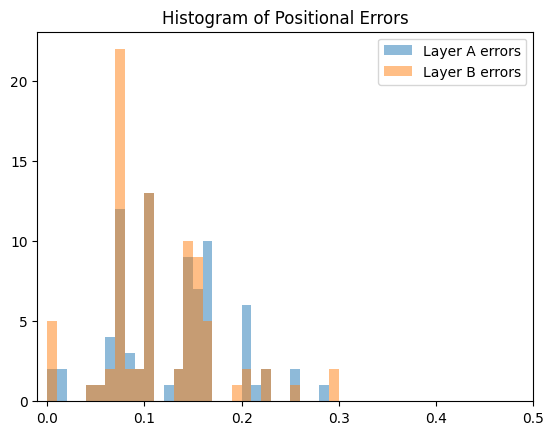

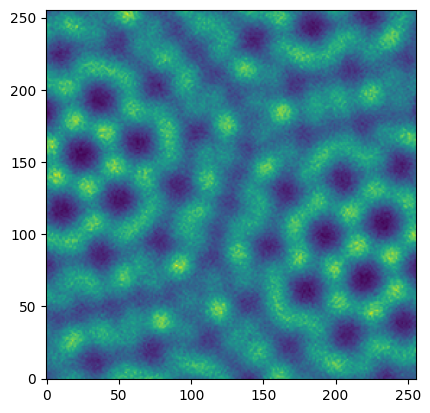

0.11600494384765625
GT 2*sigma =  0.04852638787486653
Total positional error for Layer A with prediction[1]: 0.28264448472045045
Total positional error for Layer A with prediction[0]: 0.12132001365909323
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.11849104537488447
Average positional error for both layers: 0.11990552951698885


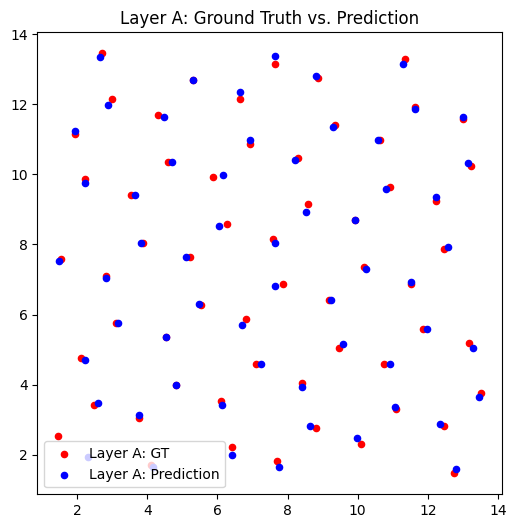

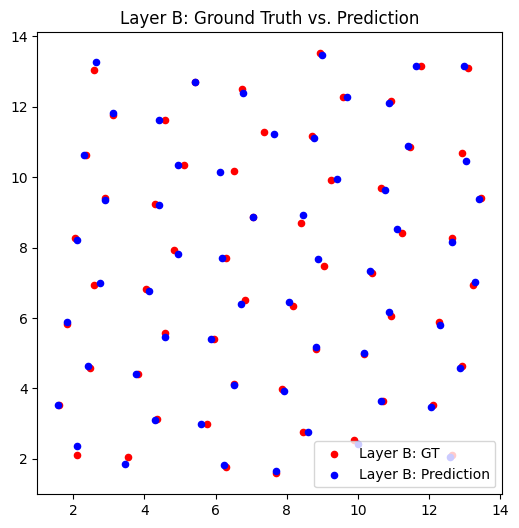

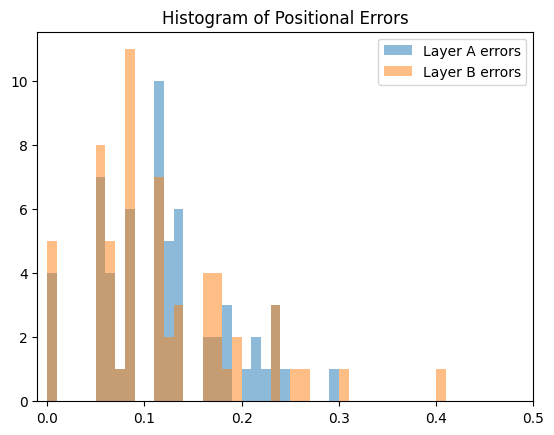

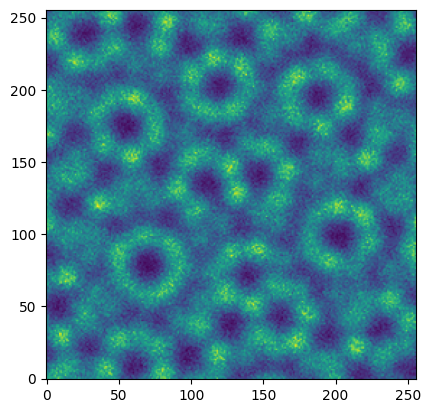

0.27207183837890625
GT 2*sigma =  0.1364832099501633
Total positional error for Layer A with prediction[1]: 0.10187467218386487
Total positional error for Layer A with prediction[0]: 0.29948625899896225
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.10769971003045498
Average positional error for both layers: 0.10478719110715992


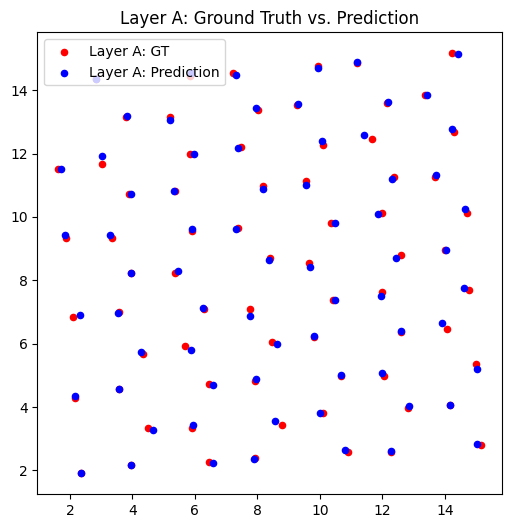

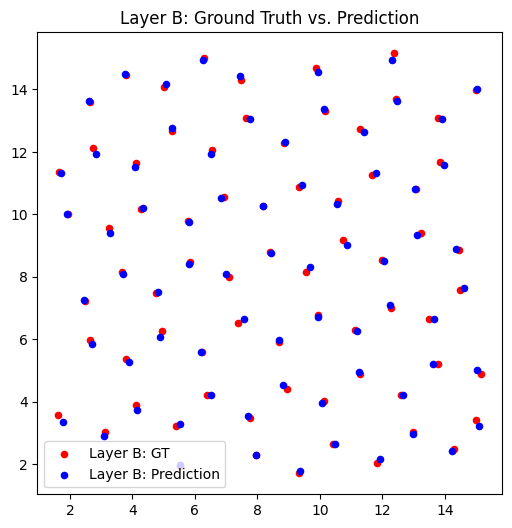

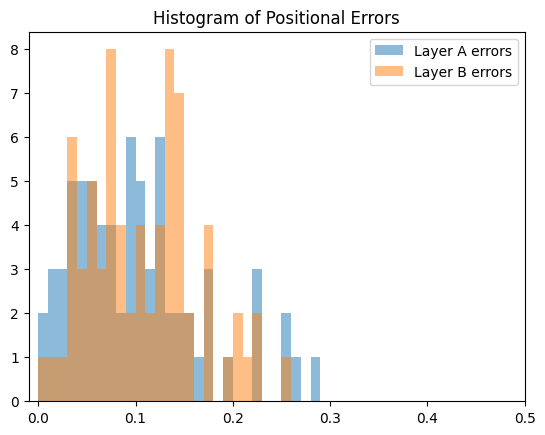

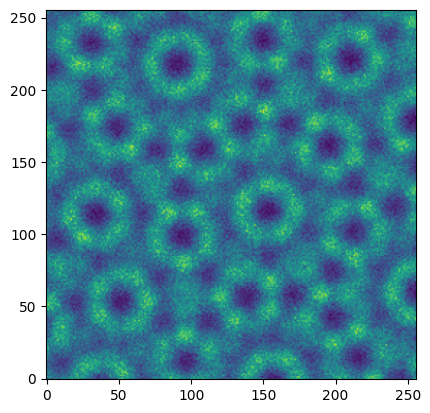

0.1949920654296875
GT 2*sigma =  0.06270187590034565
Total positional error for Layer A with prediction[1]: 0.20253640517548693
Total positional error for Layer A with prediction[0]: 0.19941984576322194
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.20523053408957134
Average positional error for both layers: 0.20232518992639664


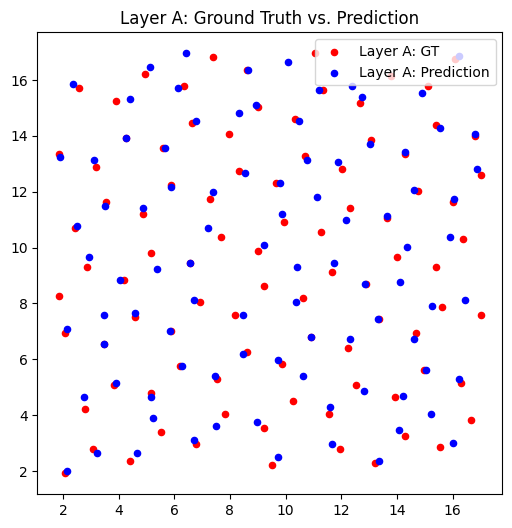

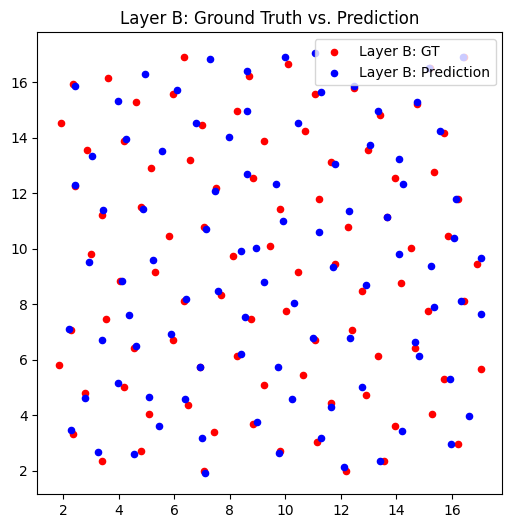

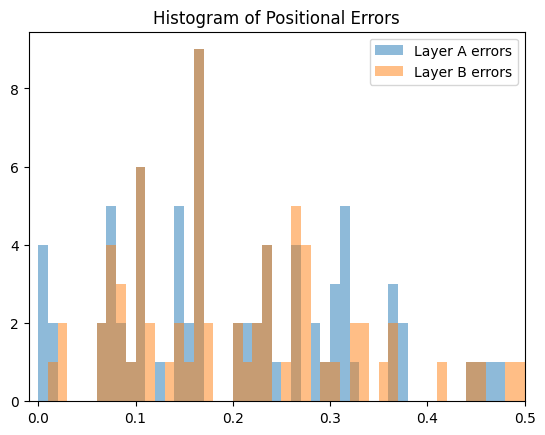

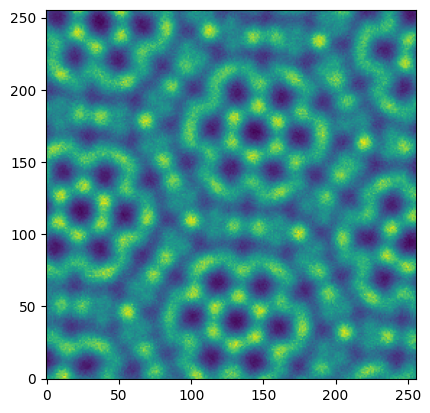

0.09746551513671875
GT 2*sigma =  0.06574553530336656
Total positional error for Layer A with prediction[1]: 0.3108756578200747
Total positional error for Layer A with prediction[0]: 0.10327430649026896
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.10017213178551064
Average positional error for both layers: 0.1017232191378898


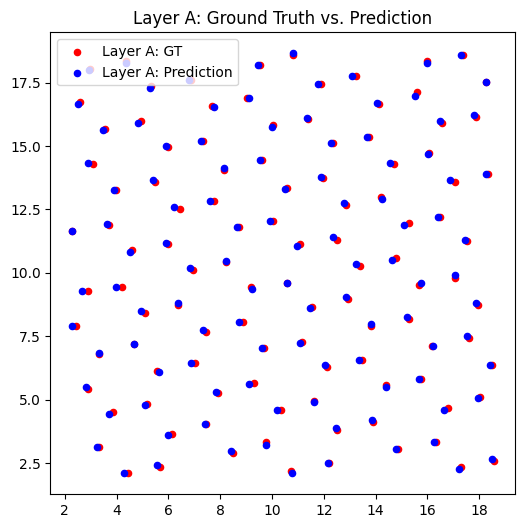

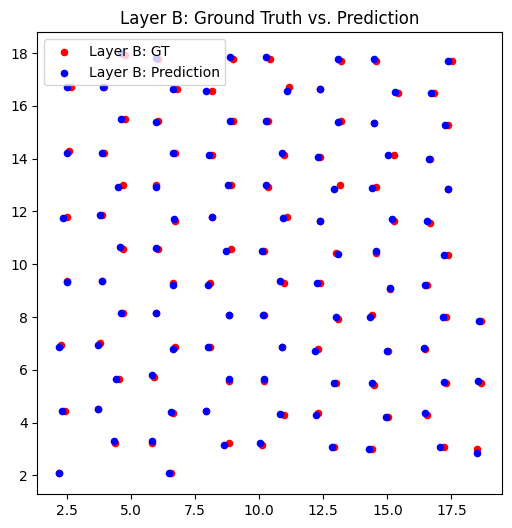

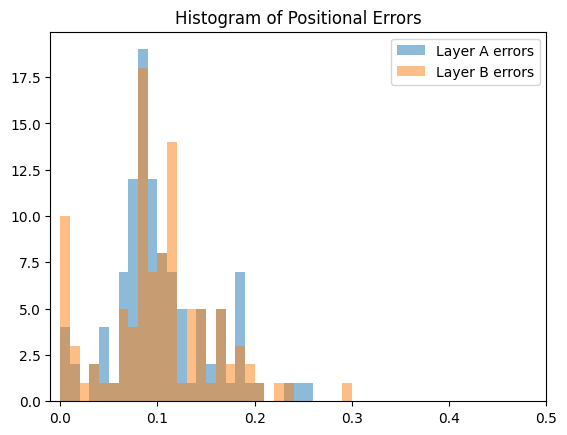

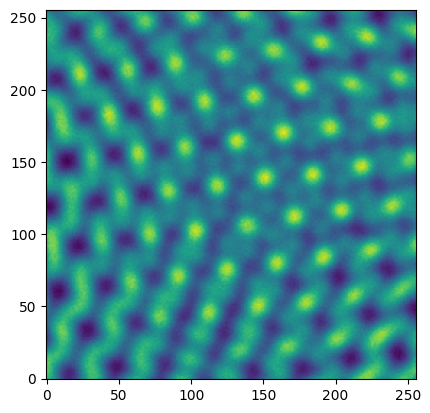

0.17545318603515625
GT 2*sigma =  0.08230004799134073
Total positional error for Layer A with prediction[1]: 0.1510473968518437
Total positional error for Layer A with prediction[0]: 0.13068565319876263
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.19361959706176043
Average positional error for both layers: 0.16215262513026152


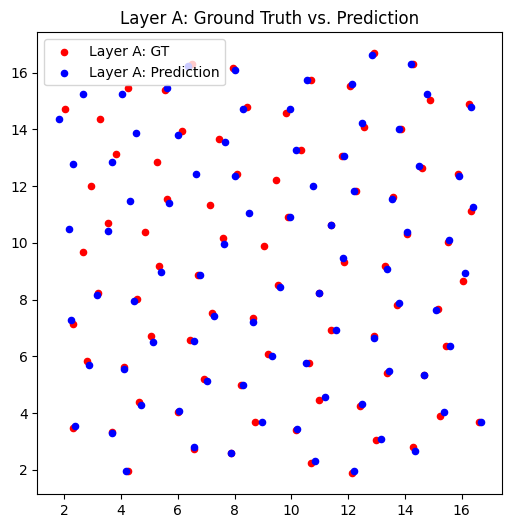

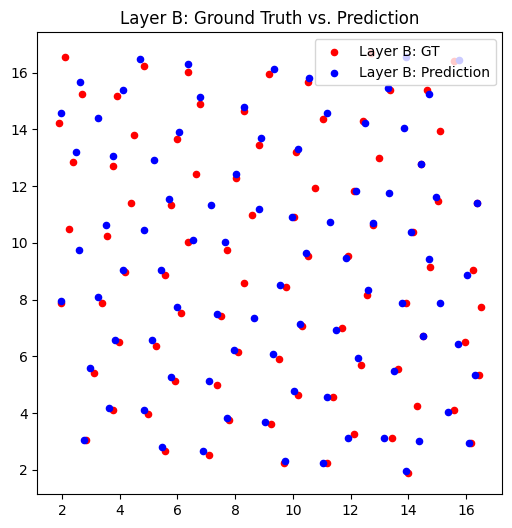

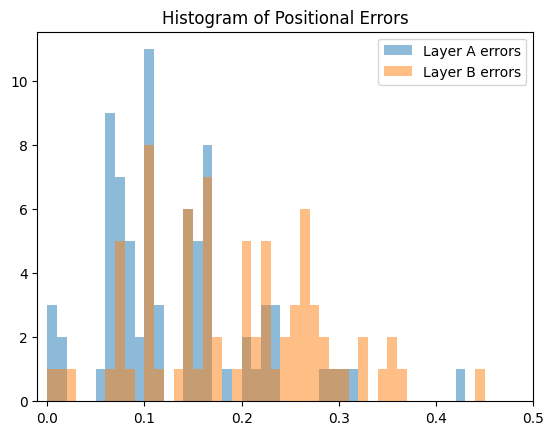

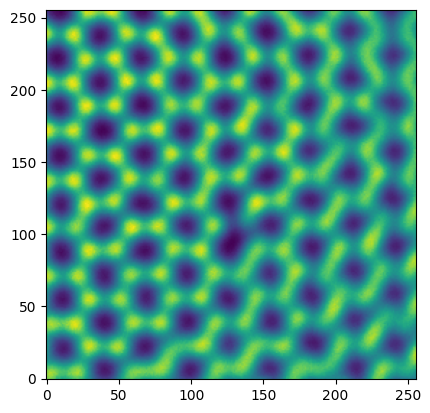

0.13021087646484375
GT 2*sigma =  0.11457183696861123
Total positional error for Layer A with prediction[1]: 0.24996847863025687
Total positional error for Layer A with prediction[0]: 0.16025562906953858
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.15254672755381868
Average positional error for both layers: 0.15640117831167863


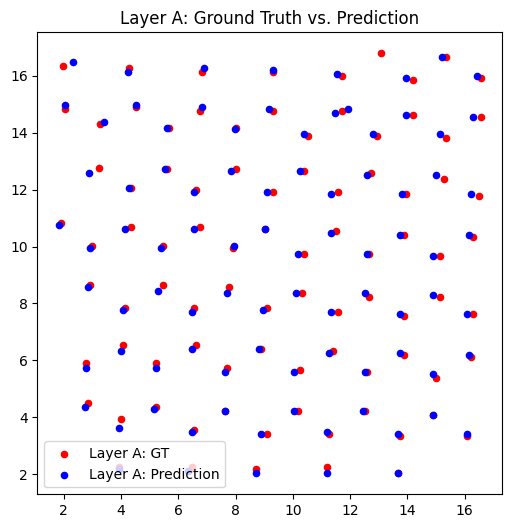

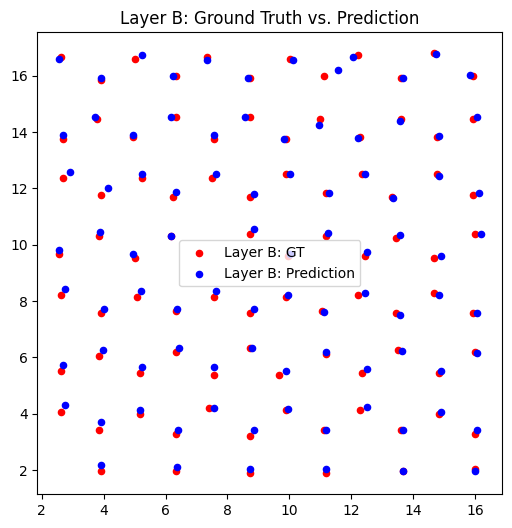

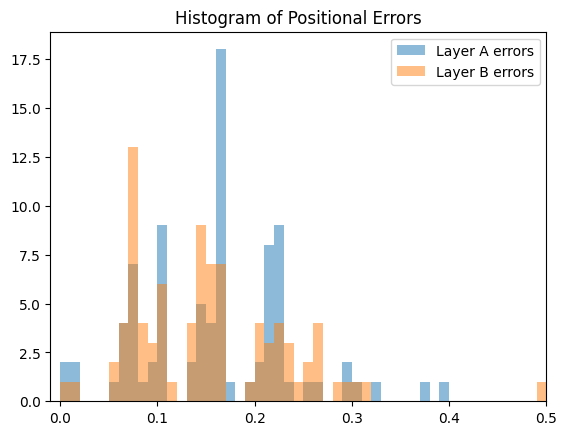

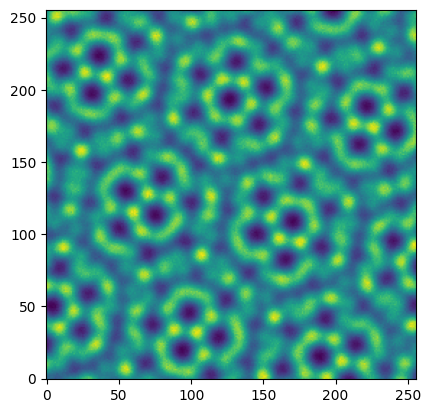

0.09691619873046875
GT 2*sigma =  0.05126739298172463
Total positional error for Layer A with prediction[1]: 0.3101373916819763
Total positional error for Layer A with prediction[0]: 0.0632823725890318
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.06831795881239942
Average positional error for both layers: 0.06580016570071562


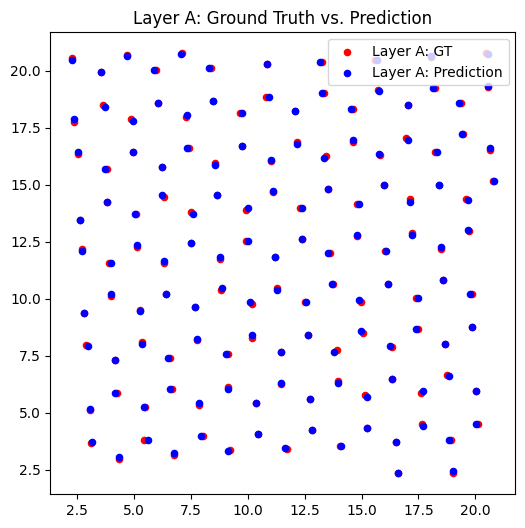

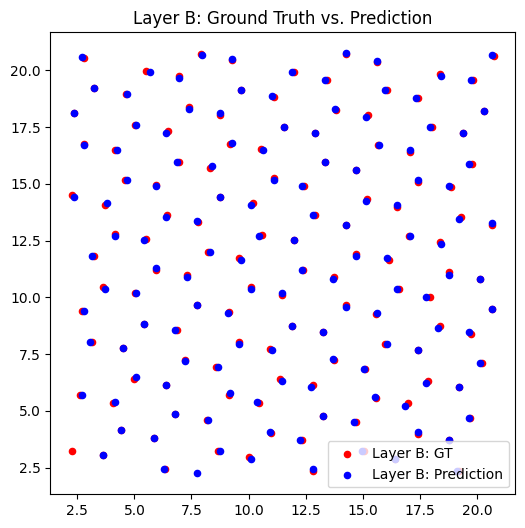

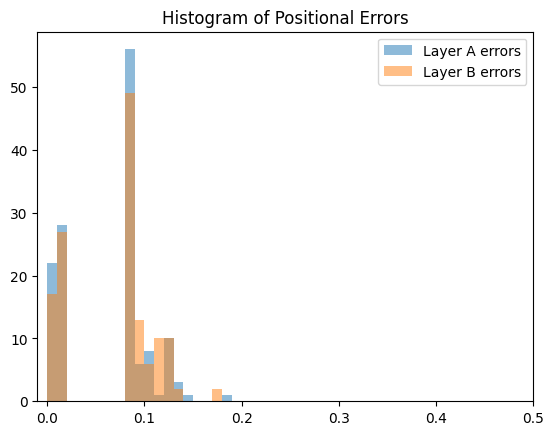

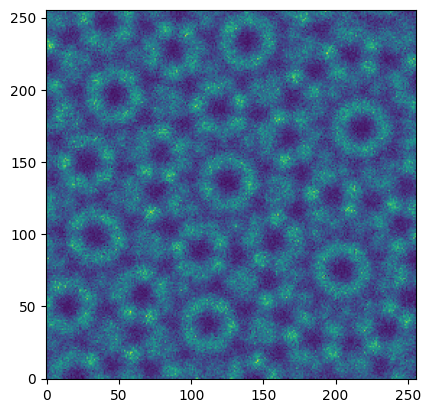

0.09169769287109375
GT 2*sigma =  0.06258672067681367
Total positional error for Layer A with prediction[1]: 0.3088540969760311
Total positional error for Layer A with prediction[0]: 0.07840013392122398
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.07644974750177955
Average positional error for both layers: 0.07742494071150177


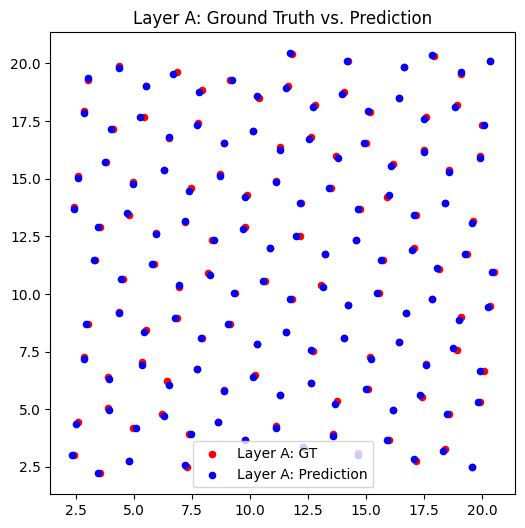

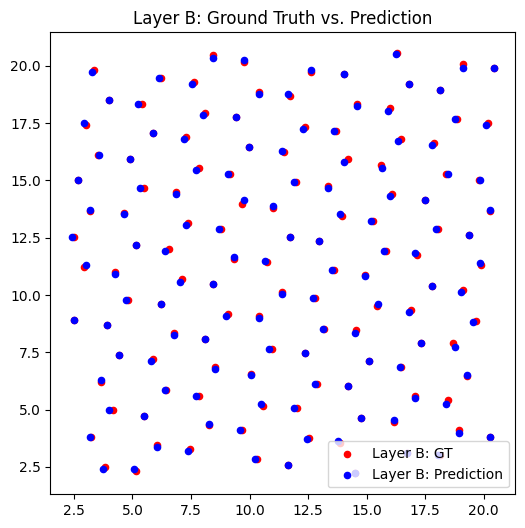

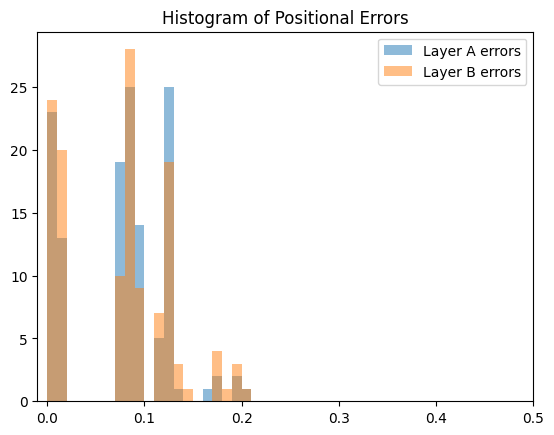

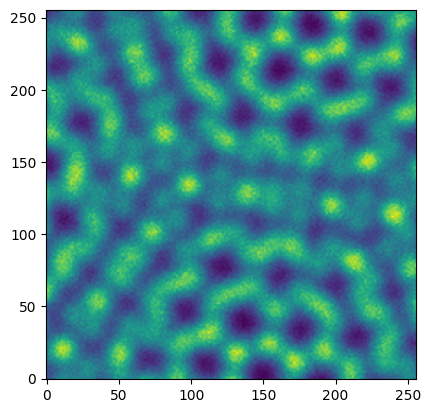

0.243499755859375
GT 2*sigma =  0.0884720119164382
Total positional error for Layer A with prediction[1]: 0.1579344636717494
Total positional error for Layer A with prediction[0]: 0.21756962659463874
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.13675441833944804
Average positional error for both layers: 0.14734444100559874


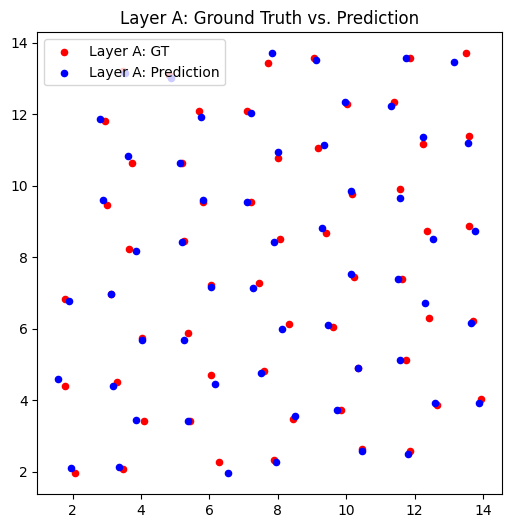

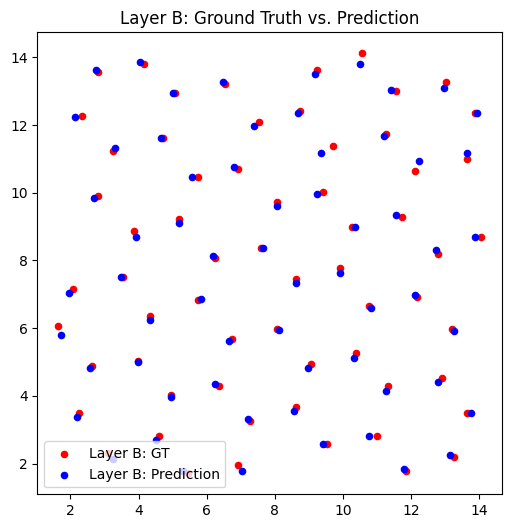

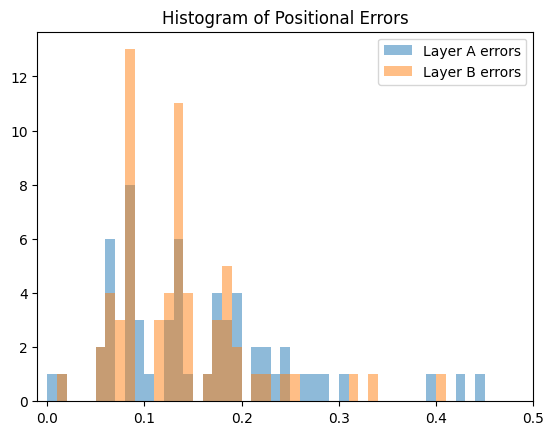

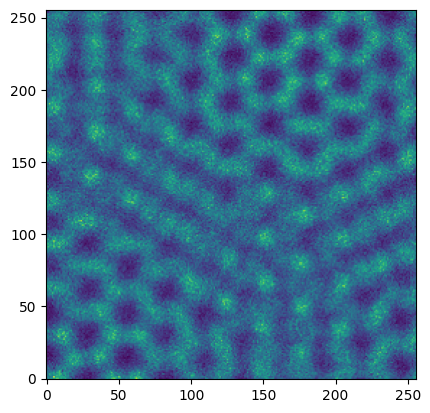

0.1409149169921875
GT 2*sigma =  0.10512255136388446
Total positional error for Layer A with prediction[1]: 0.24873254025618066
Total positional error for Layer A with prediction[0]: 0.1684792573934408
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.1568145637100341
Average positional error for both layers: 0.16264691055173747


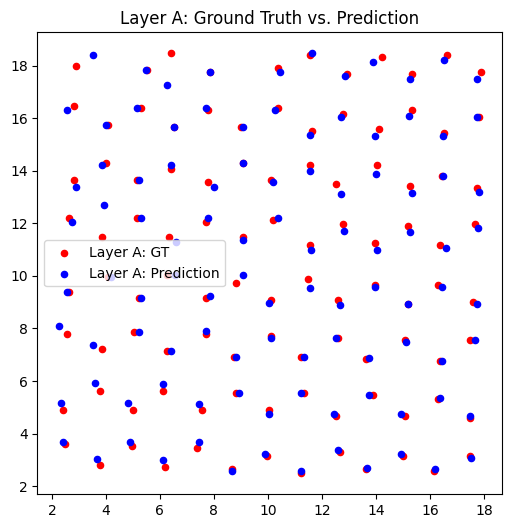

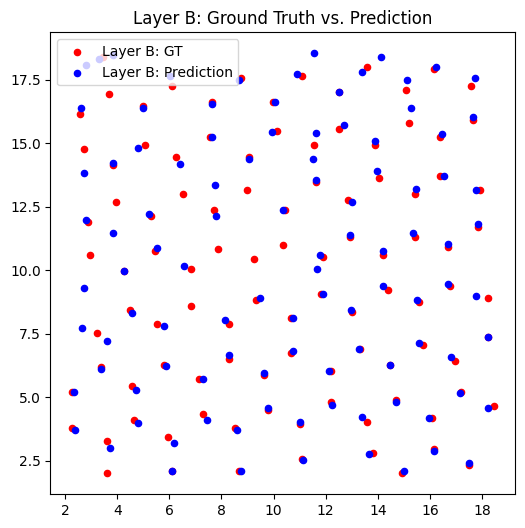

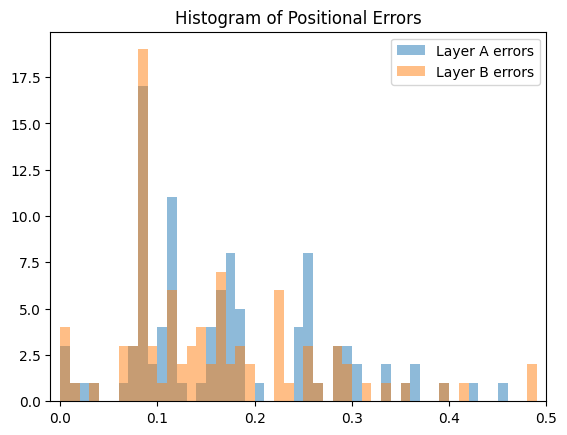

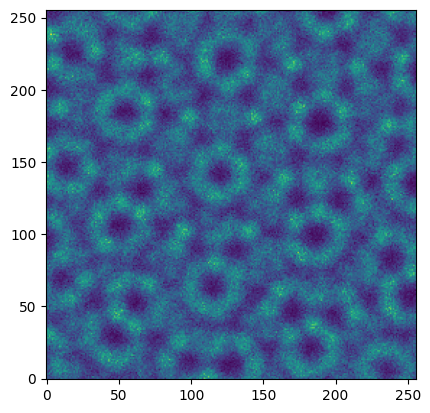

0.09243011474609375
GT 2*sigma =  0.13012832250807538
Total positional error for Layer A with prediction[1]: 0.2862367812894442
Total positional error for Layer A with prediction[0]: 0.10549441110410762
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.10197980278854489
Average positional error for both layers: 0.10373710694632626


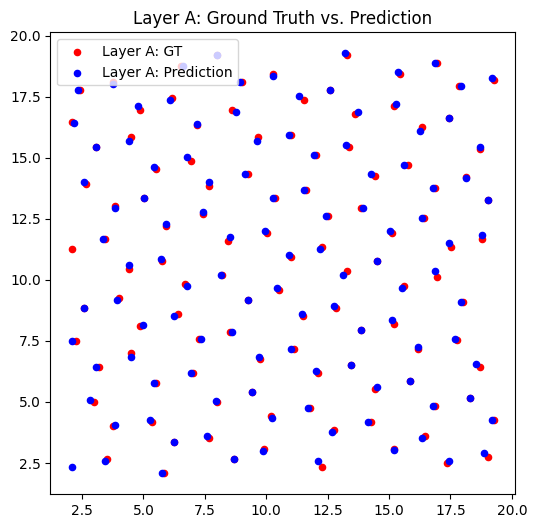

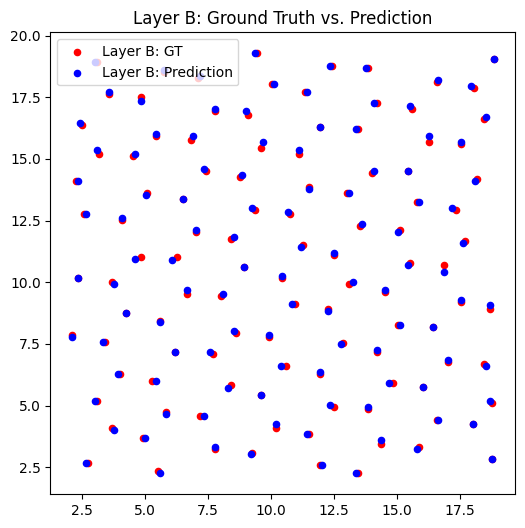

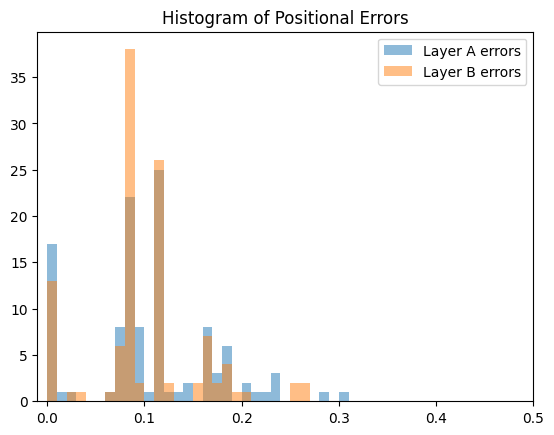

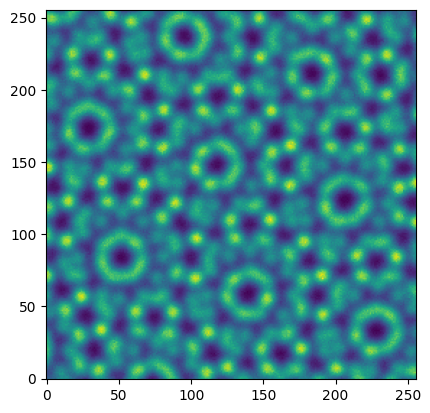

0.30323028564453125
GT 2*sigma =  0.08649709530389522
Total positional error for Layer A with prediction[1]: 0.10252311677839249
Total positional error for Layer A with prediction[0]: 0.2980131207426189
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.11338113018072933
Average positional error for both layers: 0.1079521234795609


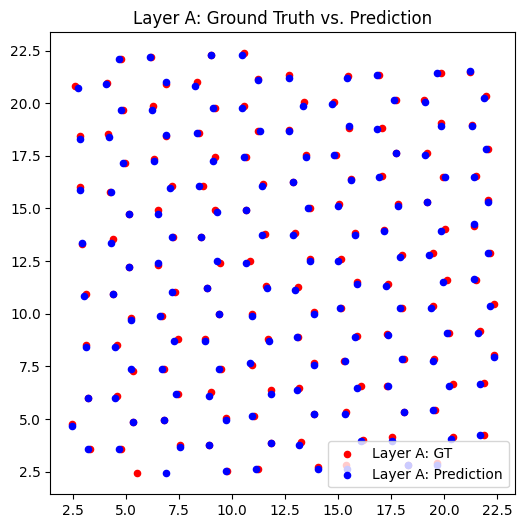

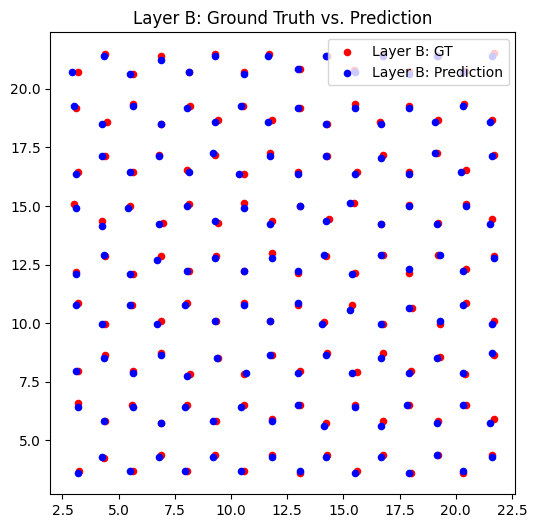

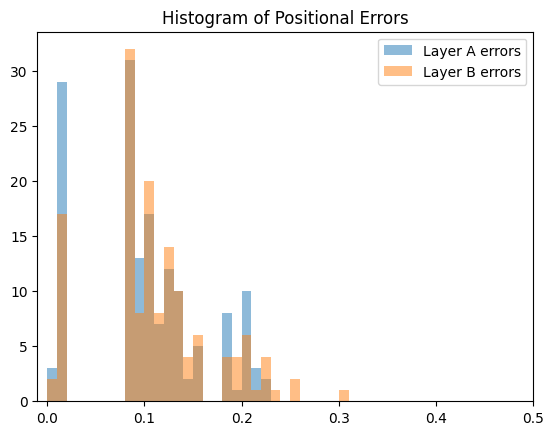

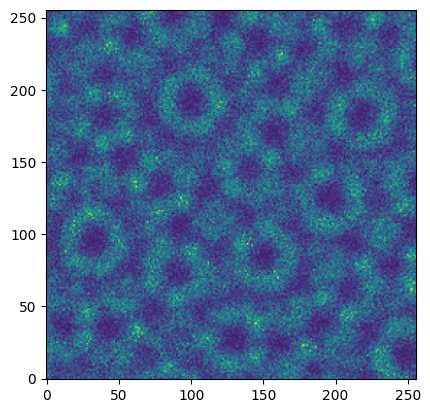

0.23459625244140625
GT 2*sigma =  0.11653778408229035
Total positional error for Layer A with prediction[1]: 0.17360837089045533
Total positional error for Layer A with prediction[0]: 0.3142558625499429
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.13830566155032153
Average positional error for both layers: 0.15595701622038843


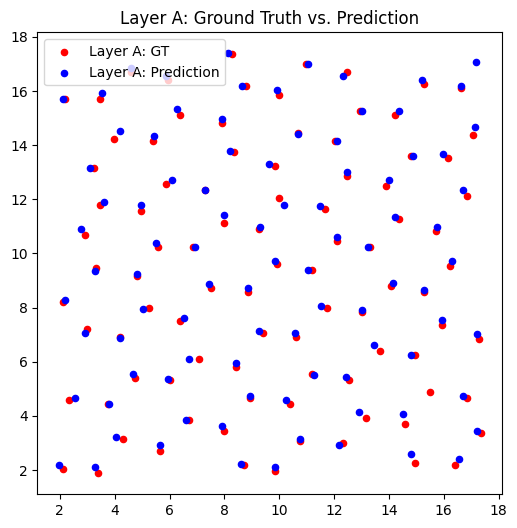

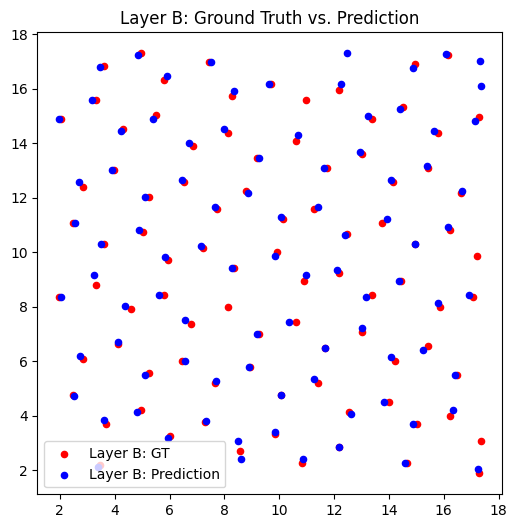

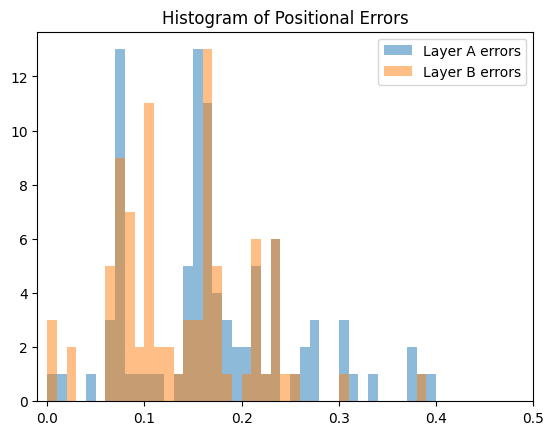

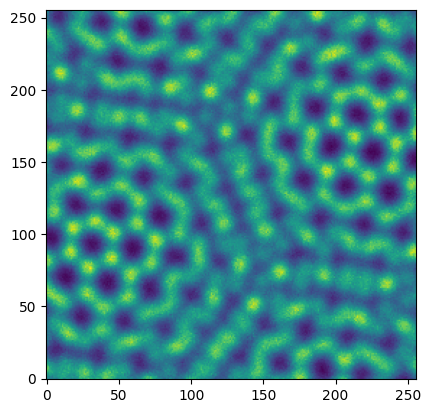

0.29754638671875
GT 2*sigma =  0.08684883870529515
Total positional error for Layer A with prediction[1]: 0.08612973234137275
Total positional error for Layer A with prediction[0]: 0.28613775325512364
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.0892461641386626
Average positional error for both layers: 0.08768794824001767


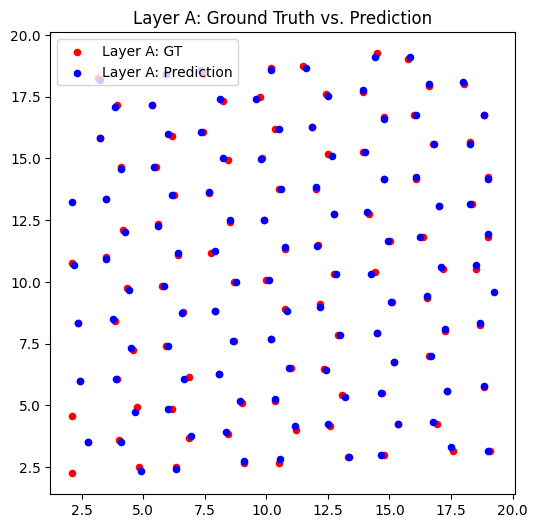

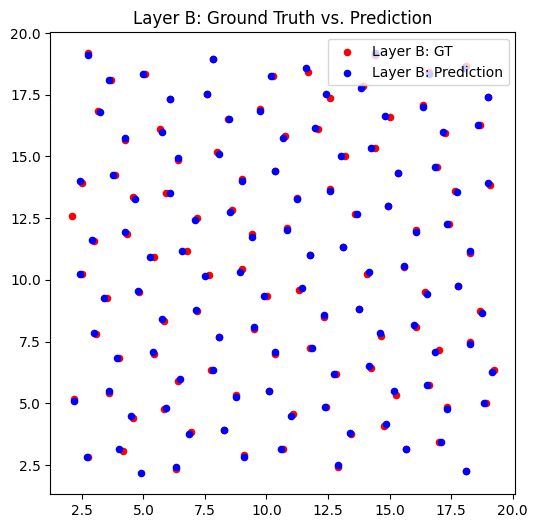

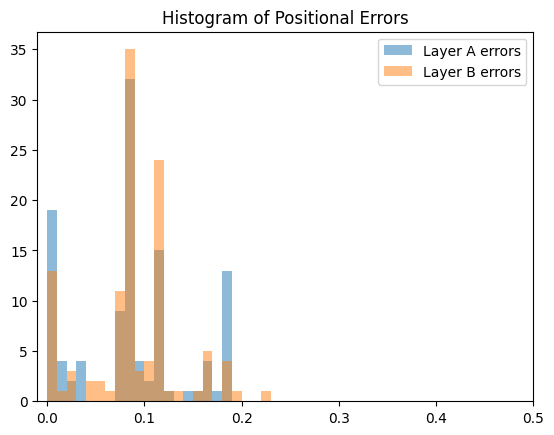

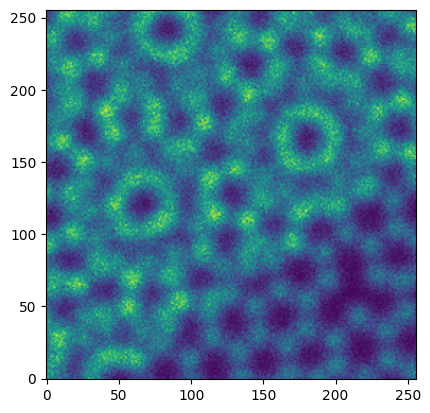

0.248321533203125
GT 2*sigma =  0.10284186715127132
Total positional error for Layer A with prediction[1]: 0.098014957023058
Total positional error for Layer A with prediction[0]: 0.22766693105425098
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.09545085935845803
Average positional error for both layers: 0.09673290819075801


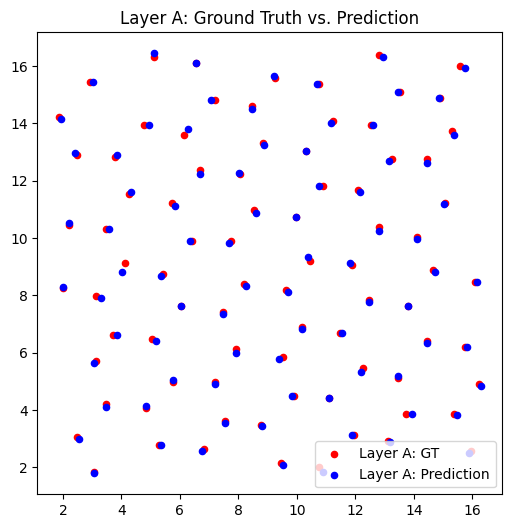

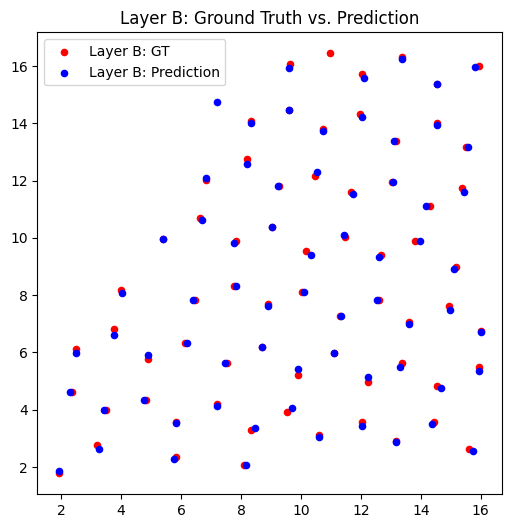

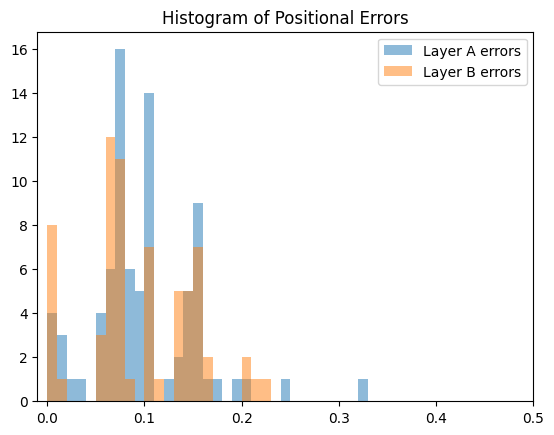

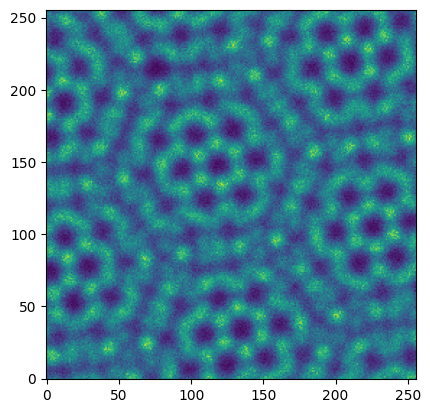

0.09832000732421875
GT 2*sigma =  0.06629896747723422
Total positional error for Layer A with prediction[1]: 0.31321616647989464
Total positional error for Layer A with prediction[0]: 0.09336487032945431
Layer A assigned from prediction[0].
Total positional error for Layer B (prediction[1]): 0.0929698482175757
Average positional error for both layers: 0.09316735927351501


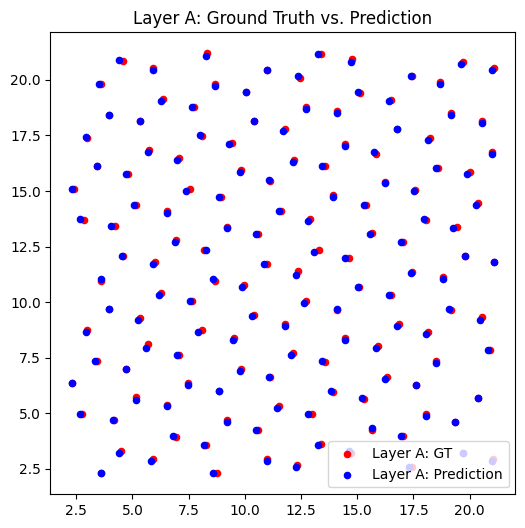

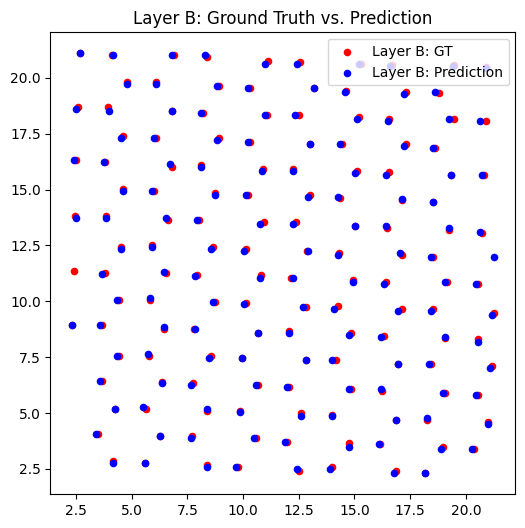

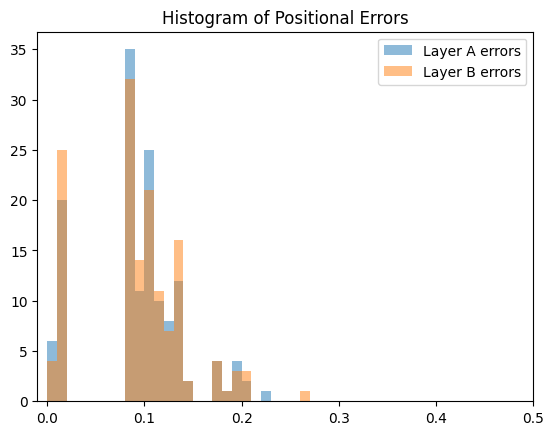

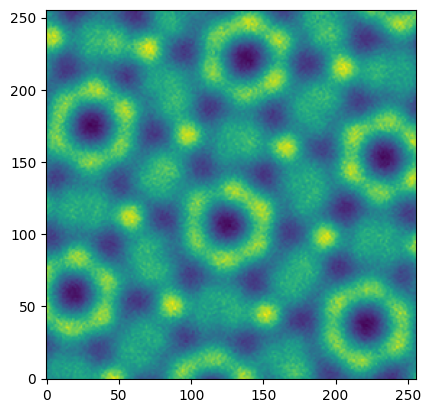

0.2617950439453125
GT 2*sigma =  0.054433698808724326
Total positional error for Layer A with prediction[1]: 0.14505398034075437
Total positional error for Layer A with prediction[0]: 0.22351563803419722
Layer A assigned from prediction[1].
Total positional error for Layer B (prediction[0]): 0.17804882265054542
Average positional error for both layers: 0.1615514014956499


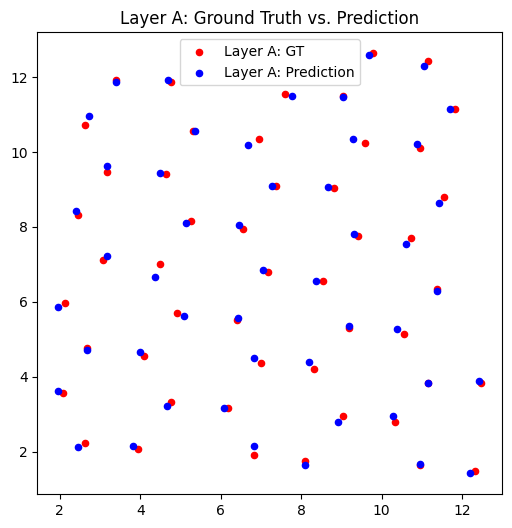

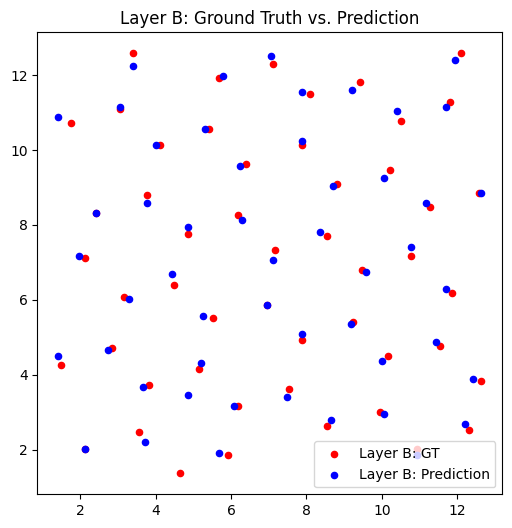

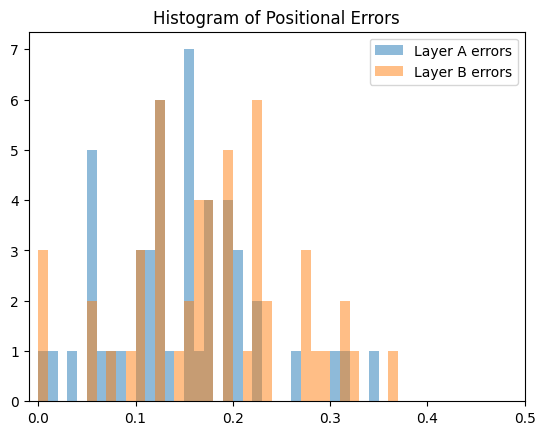

In [13]:
average_positional_errors = []
pixel_conversion_list = []
twosig_list = []
mse_loss_list = []

for i in range(len(test_loader)):
    test = test_loader.dataset[i][0].unsqueeze(0)
    plt.imshow(test[0,0], origin='lower')
    plt.show()
    gt = test_loader.dataset[i][1]
    average_error, pixel_conversion, twosig, mse = calculate_positional_errors(gt,test)
    average_positional_errors.append(average_error)
    pixel_conversion_list.append(pixel_conversion)
    twosig_list.append(twosig)
    mse_loss_list.append(mse)


# We can visualize the relationships between the the image magnification, pixel size, average positional error, and loss to check if the model does better in certain situations.

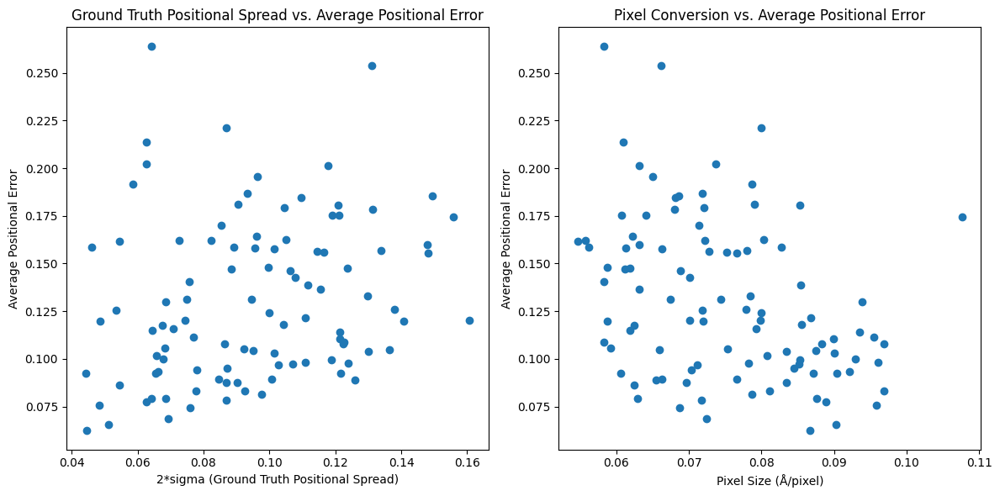

In [15]:
# prompt: make a figure with a two subplots that visualizes a scatter plot of twosig_list, and pixel_conversion_list vs average_positional_errors

import matplotlib.pyplot as plt

# Assuming average_positional_errors, twosig_list, and pixel_conversion_list are defined

fig, axes = plt.subplots(1, 2, figsize=(12, 6))

# Scatter plot 1: twosig_list vs average_positional_errors
axes[0].scatter(twosig_list, average_positional_errors)
axes[0].set_xlabel("2*sigma (Ground Truth Positional Spread)")
axes[0].set_ylabel("Average Positional Error")
axes[0].set_title("Ground Truth Positional Spread vs. Average Positional Error")

# Scatter plot 2: pixel_conversion_list vs average_positional_errors
axes[1].scatter(pixel_conversion_list, average_positional_errors)
axes[1].set_xlabel("Pixel Size (Å/pixel)")
axes[1].set_ylabel("Average Positional Error")
axes[1].set_title("Pixel Conversion vs. Average Positional Error")

plt.tight_layout()
plt.show()


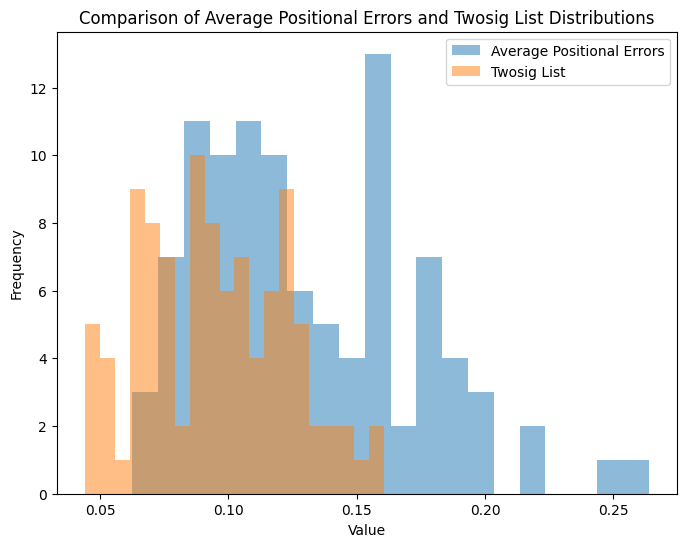

In [16]:
# prompt: plot a histogram that compares the average_positional_errors distribution with twosig_list distribution\

import matplotlib.pyplot as plt

# Assuming average_positional_errors and twosig_list are already defined from the previous code

plt.figure(figsize=(8, 6))
plt.hist(average_positional_errors, bins=20, alpha=0.5, label='Average Positional Errors')
plt.hist(twosig_list, bins=20, alpha=0.5, label='Twosig List')
plt.xlabel('Value')
plt.ylabel('Frequency')
plt.title('Comparison of Average Positional Errors and 2*sigma ground truth position spread.')
plt.legend()
plt.show()


Text(0, 0.5, 'Average Positional Error (Å)')

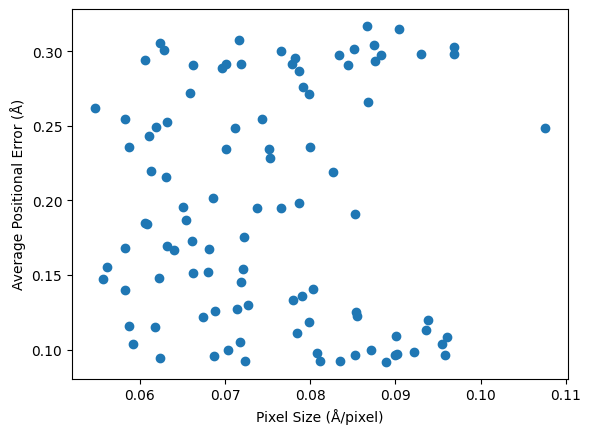

In [22]:
plt.scatter(pixel_conversion_list, mse_loss_list)
plt.xlabel("Pixel Size (Å/pixel)")
plt.ylabel('Average Positional Error (Å)')

# Here we report the mean positional error from the model predictions

In [33]:
# Calculate the mean and standard deviation of average_positional_errors
mean_error = np.mean(average_positional_errors)
std_error = np.std(average_positional_errors)

# Print the statement
print(f"Mean average positional error: {mean_error:.2f} +/- {std_error:.3f} Å")


Mean average positional error: 0.13 +/- 0.042 Å
